# <a id='toc1_'></a>[Fake information classification](#toc0_)

## <a id='toc1_1_'></a>[Background](#toc0_)

Misinformation is one of the challenges that are faced worldwide. Incorrect information can be harmless in some context, but can be devastating in others. False information influences the huge polarization, hate and conflict in the society. In some contexts, fake news can even influence democratic elections. 

## <a id='toc1_2_'></a>[Contents](#toc0_)
Contents are made up of two datasets containing true and fake information. Each dataset consists of title, text, subject and date of articles. 

## <a id='toc1_3_'></a>[Goal](#toc0_)
Classify articles into true and fake.

## <a id='toc1_4_'></a>[Objectives](#toc0_)
* Perform EDA - identify how fake articles differ from true. Find most predictive features. 
* Use heuristic rules as baseline for article prediction.
* Make machine learning models with engineered features and texts.
* Build a deep-learning model.
* Compare model performance.
* Identify where the model is underperforming. Analyze misclassified items.

**Table of contents**<a id='toc0_'></a>    
- [Fake information classification](#toc1_)    
  - [Background](#toc1_1_)    
  - [Contents](#toc1_2_)    
  - [Goal](#toc1_3_)    
  - [Objectives](#toc1_4_)    
  - [Configuration](#toc1_5_)    
  - [EDA](#toc1_6_)    
    - [Missing data and duplicates](#toc1_6_1_)    
    - [Data distributions and associations](#toc1_6_2_)    
      - [Text/Title word count](#toc1_6_2_1_)    
      - [Empty text/title articles](#toc1_6_2_2_)    
      - [Longest/Shortest text/title articles](#toc1_6_2_3_)    
      - [Article subject distributions](#toc1_6_2_4_)    
      - [Article dates](#toc1_6_2_5_)    
    - [Caps words](#toc1_6_3_)    
    - [Analysis of repettitive words](#toc1_6_4_)    
    - [Common words in fake article text/title](#toc1_6_5_)    
    - [Special characters, tags etc](#toc1_6_6_)    
    - [Analysis of common topics](#toc1_6_7_)    
    - [Vocabluary size and richness](#toc1_6_8_)    
    - [Stopword frequency](#toc1_6_9_)    
    - [Text/title similarity](#toc1_6_10_)    
    - [Language analysis](#toc1_6_11_)    
    - [Part-of-speech tagging](#toc1_6_12_)    
    - [Sentiment and Emotional Analysis](#toc1_6_13_)    
    - [Emotions in text](#toc1_6_14_)    
    - [Semantic Analysis](#toc1_6_15_)    
    - [Noise and Outlier Detection](#toc1_6_16_)    
    - [Text cleaning](#toc1_6_17_)    
    - [Train/validation/test data split](#toc1_6_18_)    
  - [Classification models](#toc1_7_)    
    - [Building a heuristic model](#toc1_7_1_)    
    - [Machine learning classifier models from features](#toc1_7_2_)    
      - [Explanation of models trained on features](#toc1_7_2_1_)    
    - [Machine learning classifier models from text](#toc1_7_3_)    
    - [Evaluation of classifier models](#toc1_7_4_)    
      - [Additional dataset preprocessing and modeling](#toc1_7_4_1_)    
    - [Deep-learning classifier training](#toc1_7_5_)    
      - [Feature importance explanation using SHAP.](#toc1_7_5_1_)    
    - [Model misclassifications](#toc1_7_6_)    
      - [Catboost classifier. Engineered features](#toc1_7_6_1_)    
      - [XGBoost classifier trained on text. Text preprocessing pipeline one.](#toc1_7_6_2_)    
      - [Distilbert classifier. Trained on text preprocessed by the first pipeline](#toc1_7_6_3_)    
      - [Distilbert model trained on texts preprocessed by the second pipeline.](#toc1_7_6_4_)    
  - [Summary](#toc1_8_)    
    - [Suggestions for further improvement](#toc1_8_1_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

## <a id='toc1_5_'></a>[Configuration](#toc0_)

In [ ]:
import os
import sys

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings

from typing import List, Dict, Union, Tuple
from collections import Counter
import json
from wordcloud import WordCloud

import torch
from torch import nn
from torch.utils.data import DataLoader
from transformers import (
    DistilBertTokenizer,
    DistilBertForSequenceClassification,
    AutoTokenizer,
    AutoModel,
)

from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
import umap.umap_ as umap
from tqdm import tqdm
import shap

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import normalize, LabelEncoder

from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from xgboost import XGBClassifier

from time import time
from nltk.corpus import stopwords
from nltk import word_tokenize

c:\Users\jonas\anaconda3\envs\turing_new\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
project_dir = os.path.abspath(os.path.join(os.getcwd(), ".."))
utils_dir = os.path.join(project_dir, "utils")
data_dir = os.path.join(project_dir, "data")
sys.path.append(utils_dir)

warnings.filterwarnings('ignore', category=FutureWarning)
warnings.filterwarnings('ignore', category=UserWarning)
warnings.filterwarnings('ignore', category=RuntimeWarning)

from config import (
    DEVICE,
    RANDOM_SEED,
    BATCH_SIZE,
    MAX_SEQ_LEN,
    TRAIN_LR
)
import custom_functions as cf
from pytorch_modules import FakeTextDataset, FakeTextModule

In [ ]:
plt.rcParams.update(
    {
        "font.size": 10,
        "font.family": "sans-serif",
        "axes.labelsize": 10,
        "axes.titlesize": 11,
        "xtick.labelsize": 8,
        "ytick.labelsize": 8,
        "legend.fontsize": 8,
        "lines.linewidth": 2,
        "axes.grid": False,
        "figure.figsize": (4, 3),
        "axes.spines.top": False,
        "axes.spines.right": False
    }
)

pastel_blue_green_palette = sns.color_palette(
    [
        "#a6c8e0",
        "#7fc98f",
        "#5fc8af",
        "#9edbad",
        "#8fa9c7",
        "#7fbfbf",
        "#578dab",
        "#4a9a7e",
    ]
)
sequential_palette8 = sns.color_palette(
    [
        "#a7ceef",
        "#92bcd9",
        "#7daac3",
        "#6999ad",
        "#548799",
        "#3f7583",
        "#2a5c6d",
        "#154e5a",
    ]
)

plt.style.use("seaborn-v0_8-muted")
sns.set_palette(pastel_blue_green_palette)

## <a id='toc1_6_'></a>[EDA](#toc0_)

In [94]:
true_information = pd.read_csv(os.path.join(data_dir, 'True.csv'))

In [95]:
fake_information = pd.read_csv(os.path.join(data_dir, 'Fake.csv'))

In [96]:
display(true_information.head(2))
print(true_information.shape)

,title,text,subject,date
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017"
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017"


(21417, 4)


In [97]:
display(fake_information.head(2))
print(fake_information.shape)

,title,text,subject,date
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017"
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017"


(23481, 4)


* There are similar numbers of fake and true information articles

### <a id='toc1_6_1_'></a>[Missing data and duplicates](#toc0_)

In [98]:
display(true_information.info())
print(true_information.isna().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21417 entries, 0 to 21416
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   title    21417 non-null  object
 1   text     21417 non-null  object
 2   subject  21417 non-null  object
 3   date     21417 non-null  object
dtypes: object(4)
memory usage: 669.4+ KB


None

title      0
text       0
subject    0
date       0
dtype: int64


In [99]:
display(fake_information.info())
print(fake_information.isna().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23481 entries, 0 to 23480
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   title    23481 non-null  object
 1   text     23481 non-null  object
 2   subject  23481 non-null  object
 3   date     23481 non-null  object
dtypes: object(4)
memory usage: 733.9+ KB


None

title      0
text       0
subject    0
date       0
dtype: int64


* No missing data rows

**Total duplicates**

Duplicated by title, text and other features

In [100]:
print(true_information.duplicated().sum())
print(fake_information.duplicated().sum())

206
3


In [101]:
true_information_duplicates = true_information[true_information.duplicated()]
fake_information_duplicates = fake_information[fake_information.duplicated()]

In [102]:
true_information.drop_duplicates(inplace=True)
true_information.duplicated().sum()

0

In [103]:
fake_information.drop_duplicates(inplace=True)
fake_information.duplicated().sum()

0

* Duplicates were dropped as they made up small proportions in each of the datasets.

**Partial duplicates**

Duplicates that only have same text or title

In [104]:
true_information_partial_duplicates = pd.concat(g for _, g in true_information.groupby("text") if len(g) > 1)
fake_information_partial_duplicates = pd.concat(g for _, g in fake_information.groupby("text") if len(g) > 1)

In [105]:
print(true_information_partial_duplicates.shape, fake_information_partial_duplicates.shape)

(38, 4) (10951, 4)


In [106]:
true_information_partial_duplicates.sort_values('text').head(15)

,title,text,subject,date
11227,Exclusive: Atlantic City emergency fiscal mana...,(Reuters) - New Jersey taxpayers will owe $2.6...,politicsNews,"January 15, 2016"
11228,Exclusive: Atlantic City emergency fiscal mana...,(Reuters) - New Jersey taxpayers will owe $2.6...,politicsNews,"January 14, 2016"
165,What is in the Republicans' final tax bill,(Reuters) - Republicans in the U.S. Congress r...,politicsNews,"December 14, 2017"
166,Factbox: What is in the U.S. Republicans' fina...,(Reuters) - Republicans in the U.S. Congress r...,politicsNews,"December 14, 2017"
733,China's Xi says will persist with Korean penin...,BEIJING (Reuters) - Chinese President Xi Jinpi...,politicsNews,"November 9, 2017"
15307,China's Xi says will persist with Korean penin...,BEIJING (Reuters) - Chinese President Xi Jinpi...,worldnews,"November 9, 2017"
771,Trump to ask China to cut financial links with...,BEIJING (Reuters) - U.S. President Donald Trum...,politicsNews,"November 8, 2017"
15414,Trump to ask China to cut financial links with...,BEIJING (Reuters) - U.S. President Donald Trum...,worldnews,"November 8, 2017"
17444,Factbox: Raqqa - Battle for Islamic State's Sy...,BEIRUT (Reuters) - The battle for the city of ...,worldnews,"October 15, 2017"
17441,"Factbox - Battle for Raqqa, Islamic State's Sy...",BEIRUT (Reuters) - The battle for the city of ...,worldnews,"October 15, 2017"


*Comments:*
* Partial duplicates in true information dataset seem to be duplicated text inputs that differ slightly by the publication date or title. Most of the time, article titles are the same. For these duplicates, it will not cause any damage to remove either of them from the dataset. 

In [107]:
fake_information_partial_duplicates.sort_values('text').head(15)

,title,text,subject,date
10923,TAKE OUR POLL: Who Do You Think President Trum...,,politics,"May 10, 2017"
16190,WHICH ONE OF THESE PEOPLE Tried to Lecture the...,,Government News,"Mar 21, 2017"
16192,WATCH: TED CRUZ SKEWERS DEMS for Hypocritical ...,,Government News,"Mar 21, 2017"
16193,TRUTH! Sara Carter is a Gem of a Reporter: “No...,,Government News,"Mar 21, 2017"
16194,FAKE NEWS! MAXINE WATERS and JOY REID Make Out...,,Government News,"Mar 20, 2017"
16196,DEMOCRAT ALAN DERSHOWITZ Calls Out Court’s Rul...,,Government News,"Mar 20, 2017"
16199,NIGEL FARAGE ON TRUMP/MERKEL POWWOW: Merkel’s ...,,Government News,"Mar 17, 2017"
16203,WATTERS’ WORLD: “Do you have Obamacare?”…”How ...,,Government News,"Mar 13, 2017"
16212,A MUST WATCH! JUDGE NAPOLITANO: “For the first...,,Government News,"Mar 8, 2017"
16214,CHILLING! FOX REPORTER JAMES ROSEN Recounts Be...,,Government News,"Mar 6, 2017"


* Most of partial duplicates in fake data are entries that do not have input text - 630 of such inputs.
* Other fake information partial duplicates are actual duplicates that differ by subject, publication date or title length

* My decision is to remove all entries that are identical bu title and text from both fake and true information datasets

In [108]:
true_information_removed_duplicates = (
    true_information[true_information.duplicated(['title', 'text'])]
)
fake_information_removed_duplicates = (
    fake_information[fake_information.duplicated(['title', 'text'])]
)

In [109]:
true_information_removed_duplicates.shape, fake_information_removed_duplicates.shape

((14, 4), (5570, 4))

In [110]:
true_information.drop_duplicates(['title', 'text'], inplace=True)
fake_information.drop_duplicates(['title', 'text'], inplace=True)

In [111]:
true_information.shape, fake_information.shape

((21197, 4), (17908, 4))

*Comments:*
* 14 rows were removed from true information dataset and ~5000 rows were removed from fake information dataset that contained duplicating entries by text and title.

### <a id='toc1_6_2_'></a>[Data distributions and associations](#toc0_)

Distributions of basic dataset information like title, text legths, categories and other. Associations between features and the fake/true article status.

#### <a id='toc1_6_2_1_'></a>[Text/Title word count](#toc0_)

In [112]:
true_information['status'] = len(true_information) * ['True']
fake_information['status'] = len(fake_information) * ['Fake']

In [113]:
all_information = pd.concat(
    [true_information,
     fake_information],
    axis=0
)

In [114]:
def get_word_count(text):
    word_list = text.split()
    return len(word_list)

In [115]:
all_information['text_word_count'] = (
    all_information['text'].apply(lambda x: get_word_count(x))
)
all_information['title_word_count'] = (
    all_information['title'].apply(lambda x: get_word_count(x))
)

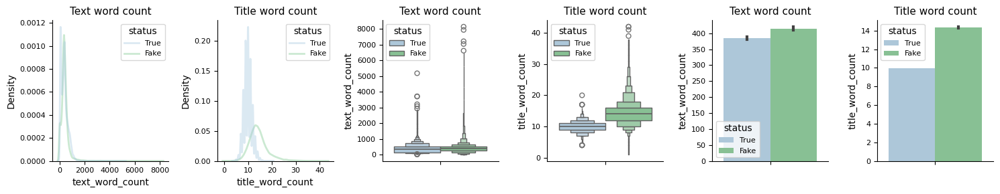

In [116]:
fig, axes = plt.subplots(1, 6, figsize=(15, 3))
axes = axes.ravel()

columns = ['text_word_count', 'title_word_count']
names = ['Text word count', 'Title word count']

for i, col in enumerate(columns):
    sns.kdeplot(
        data=all_information,
        x=col,
        ax=axes[i],
        hue='status',
        alpha=0.4
    )
    axes[i].set_title(names[i])

for i, col in enumerate(columns):
    sns.boxenplot(
        data=all_information,
        y=col,
        ax=axes[i+2],
        hue='status'
    )
    axes[i+2].set_title(names[i])

for i, col in enumerate(columns):
    sns.barplot(
        data=all_information,
        y=col,
        ax=axes[i+4],
        hue='status'
    )
    axes[i+4].set_title(names[i])

plt.tight_layout()

In [118]:
true_text = (
    all_information.loc[all_information['status']=='True']['text_word_count']
)
true_title = (
    all_information.loc[all_information['status']=='True']['title_word_count']
)

fake_text = (
    all_information.loc[all_information['status']=='Fake']['text_word_count']
)
fake_title = (
    all_information.loc[all_information['status']=='Fake']['title_word_count']
)

In [119]:
text_comparison = cf.compare_groups(
    group1=true_text,
    group2=fake_text
)
title_comparison =cf.compare_groups(
    group1=true_title,
    group2=fake_title
)

In [120]:
print('Comparison between true and fake groups in text length:')
print(f"Conclusion {text_comparison['conclusion']}")
print(f"p-value: {text_comparison['p_value']:.2e}\n")

print('Comparison between true and fake groups in title length: ')
print(f"Conclusion {title_comparison['conclusion']}")
print(f"p-value: {title_comparison['p_value']:.2e}")

Comparison between true and fake groups in text length:
Conclusion Significant
p-value: 6.62e-22

Comparison between true and fake groups in title length: 
Conclusion Significant
p-value: 0.00e+00


*Comments:*
* `Text word count` - True information articles show a little smaller text word count compared to Fake information articles, average text length is ~375 compared to 425 in fake information articles.
* `Title word count` - fake information articles show significantly higher word count compared to true information titles. Average title word count for fake information is compared to   in true information.

#### <a id='toc1_6_2_2_'></a>[Empty text/title articles](#toc0_)

In [121]:
empty_text = all_information[
    (all_information['text_word_count']==0)
]
empty_title = all_information[
    (all_information['title_word_count']==0)
]

In [122]:
empty_text['status'].value_counts()

status
Fake    446
True      1
Name: count, dtype: int64

In [123]:
empty_title['status'].value_counts()

Series([], Name: count, dtype: int64)

*Comments:*
* There are a total of 446 articles between the fake ones that do not have any text. Only one articles does not have text between true articles.
* All articles have titles.

As these empty-texted articles will be hard for the model to classify and there are only ~500 of them, it is probably the best to remove them overall.

In [124]:
all_information = all_information.loc[
    all_information['text_word_count']>0
]

In [ ]:
all_information['status'].value_counts()

status
True    21196
Fake    17462
Name: count, dtype: int64

#### <a id='toc1_6_2_3_'></a>[Longest/Shortest text/title articles](#toc0_)

In [126]:
all_information.head(2)

,title,text,subject,date,status,text_word_count,title_word_count
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017",True,749,10
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017",True,624,9


In [127]:
(
    all_information
    .groupby('status')[['text_word_count', 'title_word_count']]
    .agg(['min', 'median', 'mean', 'max'])
    .reset_index()
)

status text_word_count                          title_word_count         \
                     min median        mean   max              min median   
0   Fake               1  376.0  425.281984  8135                1   14.0   
1   True              22  359.0  384.881629  5172                4   10.0   

                  
        mean max  
0  14.319551  42  
1   9.951453  20

In [128]:
longest_texts_fake = (
    all_information.loc[all_information['status']=='Fake']
    .sort_values(['text_word_count'], ascending=False)
    .head(5)
)
longest_title_fake = (
    all_information.loc[all_information['status']=='Fake']
    .sort_values(['title_word_count'], ascending=False)
    .head(5)
)

longest_texts_true = (
    all_information.loc[all_information['status']=='True']
    .sort_values(['text_word_count'], ascending=False)
    .head(5)
)
longest_title_true = (
    all_information.loc[all_information['status']=='True']
    .sort_values(['title_word_count'], ascending=False)
    .head(5)
)

In [129]:
longest_texts_fake

,title,text,subject,date,status,text_word_count,title_word_count
22303,MEDIA TRIPWIRE? Ping Pong Pizza Conspiracy Pro...,Funny how secrets travel. I d start to believ...,US_News,"December 28, 2016",Fake,8135,13
21978,The Las Vegas Mass Shooting – More to the Stor...,Shawn Helton 21st Century WireAlthough many ar...,US_News,"October 12, 2017",Fake,7928,14
22506,"CULT CRIMES, MASS SHOOTINGS & MEDIA MIND CONTR...",Shawn Helton 21st Century WireThe 1994 cult fi...,US_News,"August 13, 2016",Fake,7209,12
9731,ANTI-AMERICAN GEORGE SOROS Locks Arms With NFL...,We just discovered another reason NOT to suppo...,politics,"Oct 7, 2017",Fake,7033,9
12406,WOW! AMERICA IS UNDER ATTACK By These 187 Orga...,There have been many articles written about Ge...,politics,"Nov 13, 2016",Fake,6608,14


In [130]:
for text in longest_texts_fake['text']:
    print(text, '\n')

 Funny how secrets travel. I d start to believe, if I were to bleed.    Lyrics written by David Bowie from the album OutsideShawn Helton 21st Century Wire In the days before the US presidential election in November 2016, Wikileaks revealed a new string of emails connected to Hillary Clinton s 2016 campaign chairman, John Podesta. Online interpretations of the leaked Podesta email exchanges subsequently led to a digital firestorm on social media, producing an intense conspiratorial  open source investigation  still in search of its smoking gun. However, the phenomenon now known by its hashtag #Pizzagate has since set a number of tertiary events into motion. Is there a real story hidden amongst the debris of this online explosion?Is it possible that  open source investigators  were being led into a virtual cul-de-sac and thus missing the real story?More importantly, could people be playing into the hands of the very establishment they seek to depose?Let s investigate   SHOCK & AWE    Ove

In [131]:
longest_title_fake

,title,text,subject,date,status,text_word_count,title_word_count
11738,MMA FIGHTER JAKE SHIELDS Embarrasses Cowards I...,Opposing views and beliefs has much of this co...,politics,"Feb 4, 2017",Fake,462,42
11899,Canadian Woman DESTROYS Liberal Prime Minister...,"I m making almost $50,000 per year and I m li...",politics,"Jan 15, 2017",Fake,153,42
9235,OUCH! President Trump Takes Off The Gloves…BLA...,When candidate-Trump promised he would put Ame...,politics,"Dec 9, 2017",Fake,476,41
15838,THIS IS GREAT! ANTI-HILLARY STREET ART POPS UP...,Hillary Clinton s supporters were calling cert...,politics,"Apr 12, 2015",Fake,31,39
9121,REP SHEILA JACKSON LEE Suggests First Class Cu...,Jean-Marie Simon was a passenger on a flight f...,politics,"Dec 26, 2017",Fake,859,38


In [132]:
for title in longest_title_fake['title']:
    print(title, '\n')

MMA FIGHTER JAKE SHIELDS Embarrasses Cowards In Masks For Violent 20-on-1 Beating of Trump Supporter [VIDEO]: “I was in Berkeley and watched a man getting beat by a mob with no police help…I was the only person to jump in and help” 

Canadian Woman DESTROYS Liberal Prime Minister Trudeau Over Socialist Carbon-Tax Policy: “How is it justified for you to ask me to pay a CARBON TAX when I only have $65 left of my paycheck every 2 weeks to feed my family?” [VIDEO] 

OUCH! President Trump Takes Off The Gloves…BLASTS Democrats For Using AMNESTY For Illegals As Bargaining Chip For Funding Government: “‘Help me, Dad!’ Those were the last words spoken by Kate Steinle, as she lay dying on a San Francisco Pier” [VIDEO] 

THIS IS GREAT! ANTI-HILLARY STREET ART POPS UP EVERYWHERE IN BROOKLYNHillary Clinton’s supporters were calling certain words used to describe her as sexist. Words like entitled, ambitious, and secretive… The area around Hillary’s campaign headquarters was plastered with this:    

*Comments:*
* Both by title and text fake articles are using all caps letters, controvesial and click-bait phrases, most of the titles have a video added.

In [133]:
longest_texts_true

,title,text,subject,date,status,text_word_count,title_word_count
2816,Transcript of Reuters interview with EPA Admin...,(Reuters) - U.S. Environmental Protection Agen...,politicsNews,"July 12, 2017",True,5172,9
8465,"Disillusionment, U.S.A. Where voters are just ...","ALGONAC, MICH.—Parker Fox drifted out of the D...",politicsNews,"August 14, 2016",True,3708,9
2594,Trump son-in-law Kushner's congressional state...,WASHINGTON (Reuters) - I am voluntarily provid...,politicsNews,"July 24, 2017",True,3690,5
3319,Text: Ex-FBI Director Comey's prepared testimo...,(Reuters) - Following is the full text of form...,politicsNews,"June 7, 2017",True,3201,9
8563,"The Big Squeeze: This election year, it’s all ...","MIDDLETOWN, CONN. - Two years ago, Judy Konopk...",politicsNews,"August 2, 2016",True,3077,11


In [134]:
for text in longest_texts_true['text']:
    print(text, '\n')

(Reuters) - U.S. Environmental Protection Agency Administrator Scott Pruitt gave Reuters a wide-ranging interview on Monday at his office in Washington, discussing issues from climate science to automobile emissions.  The following is a full transcript of the interview: REUTERS: You have said the EPA will focus on a “Back to Basics” approach under your leadership. What does this mean for how EPA enforces polluters? You have been critical of the idea of regulation by enforcement. PRUITT: I think what I’m speaking about there is a consent decree approach to enforcement, where you use judicial proceedings to actually engage in regulation. Enforcement should be about existing regulations that you’re actually enforcing against someone who may be violating that, very much in the prosecutorial manner. As attorney general [in Oklahoma], I lived that. There was a grand jury that I led. Being a prosecutor, I understand very much the importance of prioritization, of enforcing the rule of law, of 

In [135]:
longest_title_true

,title,text,subject,date,status,text_word_count,title_word_count
11490,"Honduran opposition candidate Nasralla says ""I...",MEXICO CITY (Reuters) - Honduran opposition ca...,worldnews,"December 23, 2017",True,92,20
9670,White House says Congress has no reason to wai...,WASHINGTON (Reuters) - The White House on Thur...,politicsNews,"May 5, 2016",True,76,17
8517,"Trump, in shift, to call for top tax rate of 3...",WASHINGTON (Reuters) - Republican presidential...,politicsNews,"August 8, 2016",True,68,17
21003,Egypt signs memo with China on $739 million of...,CAIRO (Reuters) - Egypt signed on Tuesday a me...,worldnews,"September 5, 2017",True,63,17
6737,Russia's Putin: ready to meet Trump any moment...,MOSCOW (Reuters) - Russian President Vladimir ...,politicsNews,"December 13, 2016",True,40,17


In [136]:
for title in longest_title_true['title']:
    print(title, '\n')

Honduran opposition candidate Nasralla says "I no longer have anything to do in politics" after U.S. recognition of Hernandez victory 

White House says Congress has no reason to wait until after Nov election to take up TPP 

Trump, in shift, to call for top tax rate of 33 percent rather than 25 percent: CNBC 

Egypt signs memo with China on $739 million of funding for new train to capital, minister says 

Russia's Putin: ready to meet Trump any moment but better after he forms his administration - media 



* 3 of the 5 longest true articles are from Reuters agency
* All caps letters are not used to emphasize the ideas.

#### <a id='toc1_6_2_4_'></a>[Article subject distributions](#toc0_)

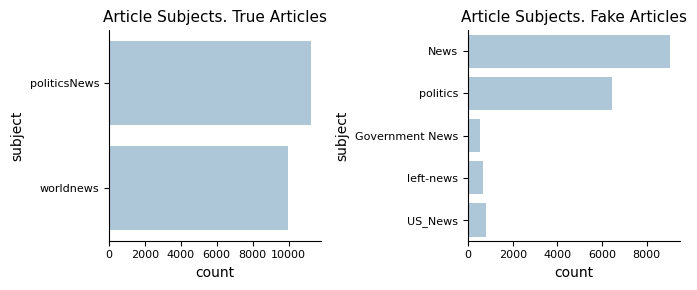

In [137]:
fig, axes = plt.subplots(1, 2, figsize=(7, 3))
axes = axes.ravel()

true = all_information.loc[all_information['status']=='True']
fake = all_information.loc[all_information['status']=='Fake']

sns.countplot(
    data=true['subject'],
    ax=axes[0]
)
axes[0].set_title('Article Subjects. True Articles')
sns.countplot(
    data=fake['subject'],
    ax=axes[1],
)
axes[1].set_title('Article Subjects. Fake Articles')
plt.tight_layout()

*Comments:*
* Article subjects are not overlapping for fake and true articles. Not much information is gained from the subject category.

#### <a id='toc1_6_2_5_'></a>[Article dates](#toc0_)

In [138]:
fake['date'] = pd.to_datetime(fake['date'], errors='coerce')
true['date'] = pd.to_datetime(true['date'], errors='coerce')
all_information['date'] = pd.to_datetime(all_information['date'], errors='coerce')

C:\Users\jonas\AppData\Local\Temp\ipykernel_56268\2117408293.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fake['date'] = pd.to_datetime(fake['date'], errors='coerce')
C:\Users\jonas\AppData\Local\Temp\ipykernel_56268\2117408293.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  true['date'] = pd.to_datetime(true['date'], errors='coerce')


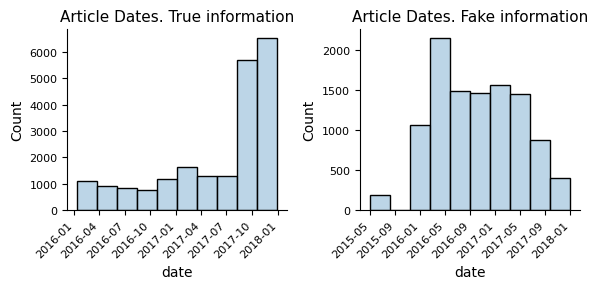

In [139]:
fig, axes = plt.subplots(1, 2, figsize=(6, 3))
axes = axes.ravel()

names = ['True', 'Fake']
for i, df in enumerate([true, fake]):
    sns.histplot(
        data=df['date'],
        bins=10,
        ax=axes[i]
    )
    axes[i].set_title(f'Article Dates. {names[i]} information')
    axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45, ha='right')

plt.tight_layout()


*Comments:*
* True information articles are more recent. Most of the articles are collected between 2017-10 and 2018-01.
* Fake information articles are collected through ~2016-2017.

### <a id='toc1_6_3_'></a>[Caps words](#toc0_)

Fake article texts and titles seem to have a higher number of all-caps words. 

In [141]:
all_information['text_caps_count'] = all_information['text'].apply(
    lambda x: cf.count_all_caps(x)
)
all_information['title_caps_count'] = all_information['title'].apply(
    lambda x: cf.count_all_caps(x)
)

all_information['text_caps_words'] = all_information['text'].apply(
    lambda x: cf.return_all_caps(x)
)
all_information['title_caps_words'] = all_information['title'].apply(
    lambda x: cf.return_all_caps(x)
)

In [142]:
all_information.head(2)

,title,text,subject,date,status,text_word_count,title_word_count,text_caps_count,title_caps_count,text_caps_words,title_caps_words
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,2017-12-31,True,749,10,16,2,"[WASHINGTON, U, S, U, S, CBS, I, U, S, CBS, I,...","[U, S]"
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,2017-12-29,True,624,9,12,2,"[WASHINGTON, U, S, A, DOD, GLAD, I, GLAD, D, C...","[U, S]"


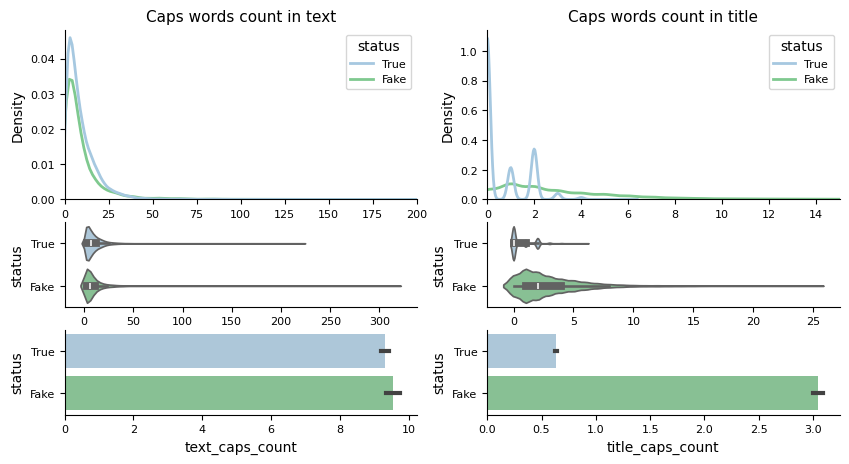

In [143]:
fig, axes = plt.subplots(3, 2, figsize=(10, 5), gridspec_kw={'height_ratios': (2, 1, 1)})
axes = axes.ravel()

columns = [
    'text_caps_count',
    'title_caps_count'
]
names = [
    'Caps words count in text',
    'Caps words count in title'
]
xlim = [200, 15]

for i, col in enumerate(columns):
    sns.kdeplot(
        data=all_information,
        x=col,
        ax=axes[i],
        hue='status'
    )
    axes[i].set_title(names[i])
    axes[i].set_xlim(0, xlim[i]);

    sns.violinplot(
        data=all_information,
        y='status',
        x=col,
        ax=axes[i+2],
        hue='status'
    )

    sns.barplot(
        data=all_information,
        y='status',
        x=col,
        ax=axes[i+4],
        hue='status'
    )


In [144]:
caps_words_text_results = cf.compare_groups(
    all_information[all_information['status']=='True']['text_caps_count'],
    all_information[all_information['status']=='Fake']['text_caps_count']
)
caps_words_title_results = cf.compare_groups(
    all_information[all_information['status']=='True']['title_caps_count'],
    all_information[all_information['status']=='Fake']['title_caps_count']
)

In [145]:
print('Comparison between true and fake groups in number of caps words in text: ')
print(f"Conclusion {caps_words_text_results['conclusion']}")
print(f"p-value: {caps_words_text_results['p_value']:.2e}")

print('Comparison between true and fake groups in number of caps words in titles: ')
print(f"Conclusion {caps_words_title_results['conclusion']}")
print(f"p-value: {caps_words_title_results['p_value']:.2e}")

Comparison between true and fake groups in number of caps words in text: 
Conclusion Significant
p-value: 2.15e-34
Comparison between true and fake groups in number of caps words in titles: 
Conclusion Significant
p-value: 0.00e+00


*Comments:*
* Both text and titles showed significant differences between true and fake article groups by number of all caps words. 
* There is a small although significant difference between true and fake article groups by number of caps words in texts. This difference is smaller than I expected. Upon manual review of extracted all-caps words, some of them seem to be only letters and not full words. In others, words are repeated throughout the texts - like WASHINGTON. 

* To get a better all-caps words impact on definition of fake and true articles, additional features will be calculated: 1) proportion of all-caps words to the length of title/text; 2) number of all caps words that are longer than 1 character in text/titles.

**Additional feature analysis**

Additional features: 1) all-caps to total text/title length proportion and 2) number of all caps words that are longer than 1 character in text/titles.

In [146]:
all_information.head(2)

,title,text,subject,date,status,text_word_count,title_word_count,text_caps_count,title_caps_count,text_caps_words,title_caps_words
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,2017-12-31,True,749,10,16,2,"[WASHINGTON, U, S, U, S, CBS, I, U, S, CBS, I,...","[U, S]"
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,2017-12-29,True,624,9,12,2,"[WASHINGTON, U, S, A, DOD, GLAD, I, GLAD, D, C...","[U, S]"


In [147]:
all_information['text_caps_words_longer'] = (
    all_information['text_caps_words'].apply(
        lambda x: len([item for item in x if len(item)>1]))
)
all_information['text_caps_proportion'] = (
    all_information['text_caps_count'] /
    all_information['text_word_count'])


In [148]:
all_information['title_caps_words_longer'] = (
    all_information['title_caps_words'].apply(
        lambda x: len([item for item in x if len(item)>1]))
)
all_information['title_caps_proportion'] = (
    all_information['title_caps_count'] /
    all_information['title_word_count'])

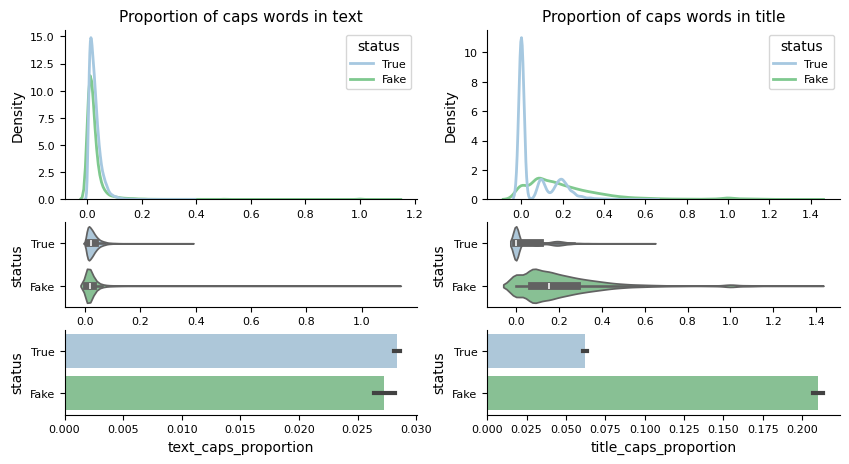

In [149]:
fig, axes = plt.subplots(3, 2, figsize=(10, 5), gridspec_kw={'height_ratios': (2, 1, 1)})
axes = axes.ravel()

columns = [
    'text_caps_proportion',
    'title_caps_proportion'
]
names = [
    'Proportion of caps words in text',
    'Proportion of caps words in title'
]

for i, col in enumerate(columns):
    sns.kdeplot(
        data=all_information,
        x=col,
        ax=axes[i],
        hue='status'
    )
    axes[i].set_title(names[i])

    sns.violinplot(
        data=all_information,
        y='status',
        x=col,
        ax=axes[i+2],
        hue='status'
    )

    sns.barplot(
        data=all_information,
        y='status',
        x=col,
        ax=axes[i+4],
        hue='status'
    )


In [150]:
caps_proportion_text_results = cf.compare_groups(
    all_information[all_information['status']=='True']['text_caps_proportion'],
    all_information[all_information['status']=='Fake']['text_caps_proportion']
)
caps_proportion_title_results = cf.compare_groups(
    all_information[all_information['status']=='True']['title_caps_proportion'],
    all_information[all_information['status']=='Fake']['title_caps_proportion']
)
print('Comparison between true and fake groups in proportion of caps words in text: ')
print(f"Conclusion {caps_proportion_text_results['conclusion']}")
print(f"p-value: {caps_proportion_text_results['p_value']:.2e}")

print('Comparison between true and fake groups in proportion of caps words in titles: ')
print(f"Conclusion {caps_proportion_title_results['conclusion']}")
print(f"p-value: {caps_proportion_title_results['p_value']:.2e}")

Comparison between true and fake groups in proportion of caps words in text: 
Conclusion Significant
p-value: 0.00e+00
Comparison between true and fake groups in proportion of caps words in titles: 
Conclusion Significant
p-value: 0.00e+00


*Comments:*
* `Text_caps_proportion` - proportions of all-caps words is similar both for fake and true information groups. True articles even show a little higher average value of all-caps proportion compared to fake text.
* `Title_caps_proportion` - all-caps words proportion is lower in true information articles.

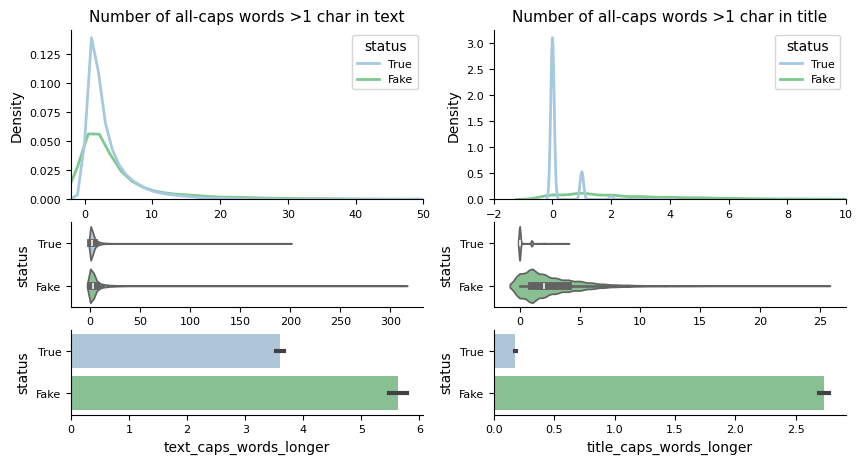

In [151]:
fig, axes = plt.subplots(
    3, 2,
    figsize=(10, 5),
    gridspec_kw={'height_ratios': (2, 1, 1)}
    )
axes = axes.ravel()

columns = [
    'text_caps_words_longer',
    'title_caps_words_longer'
]
names = [
    'Number of all-caps words >1 char in text',
    'Number of all-caps words >1 char in title'
]
xlim = [50, 10]

for i, col in enumerate(columns):
    sns.kdeplot(
        data=all_information,
        x=col,
        ax=axes[i],
        hue='status'
    )
    axes[i].set_title(names[i])
    axes[i].set_xlim(-2, xlim[i])

    sns.violinplot(
        data=all_information,
        y='status',
        x=col,
        ax=axes[i+2],
        hue='status'
    )
    
    sns.barplot(
        data=all_information,
        y='status',
        x=col,
        ax=axes[i+4],
        hue='status'
    )

*Comments:*
* Changing the calculation of all-caps words to only include words that are longer than 1 character slightly increases the difference in means between fake and true texts. Difference in title word count means also increases.

In [152]:
caps_longer_text_results = cf.compare_groups(
    all_information[all_information['status']=='True']['text_caps_words_longer'],
    all_information[all_information['status']=='Fake']['text_caps_words_longer']
)
caps_longer_title_results = cf.compare_groups(
    all_information[all_information['status']=='True']['title_caps_words_longer'],
    all_information[all_information['status']=='Fake']['title_caps_words_longer']
)
print('Comparison between true and fake groups in count of caps words in text: ')
print(f"Conclusion {caps_longer_text_results['conclusion']}")
print(f"p-value: {caps_longer_text_results['p_value']:.2e}")

print('Comparison between true and fake groups in count of caps words in titles: ')
print(f"Conclusion {caps_longer_title_results['conclusion']}")
print(f"p-value: {caps_longer_title_results['p_value']:.2e}")

Comparison between true and fake groups in count of caps words in text: 
Conclusion Significant
p-value: 3.55e-10
Comparison between true and fake groups in count of caps words in titles: 
Conclusion Significant
p-value: 0.00e+00


*Comments:*
* Differences between fake and true text/title groups are significant.

In [ ]:
all_information.head(3)

,title,text,subject,date,status,text_word_count,title_word_count,text_caps_count,title_caps_count,text_caps_words,title_caps_words,text_caps_words_longer,text_caps_proportion,title_caps_words_longer,title_caps_proportion
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,2017-12-31,True,749,10,16,2,"[WASHINGTON, U, S, U, S, CBS, I, U, S, CBS, I,...","[U, S]",6,0.021362,0,0.200000
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,2017-12-29,True,624,9,12,2,"[WASHINGTON, U, S, A, DOD, GLAD, I, GLAD, D, C...","[U, S]",4,0.019231,0,0.222222
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,2017-12-31,True,457,10,10,2,"[WASHINGTON, CBS, I, U, S, FBI, FBI, FBI, I, I]","[U, S]",5,0.021882,0,0.200000


### <a id='toc1_6_4_'></a>[Analysis of repettitive words](#toc0_)

I have observed that true texts usually start with repetitive words such as "Reuters", "WASHINGTON", "NEW YORK", "SEATTLE". These words probably are some indications of locations where the news are taking place or the broadcasting company that is transmitting the news. Such words could have an impact on model's performance, especially if they are not found between fake text examples.

For both true and fake text/titles word clouds will be used to analyze more frequentlly appearing words.

**Wordclouds and repeated true article words**

In [154]:
wordcloud_params = dict(
    width=1000,
    height=300,
    background_color='black',
    colormap='crest',
    max_font_size=80,
    min_font_size=10
)

In [155]:
fake_texts = all_information.loc[all_information['status']=='Fake']['text']
true_texts = all_information.loc[all_information['status']=='True']['text']

In [156]:
wordcloud_fake = WordCloud(
    **wordcloud_params
).generate(" ".join(fake_texts))

In [157]:
wordcloud_true = WordCloud(
    **wordcloud_params
).generate(' '.join(true_texts))

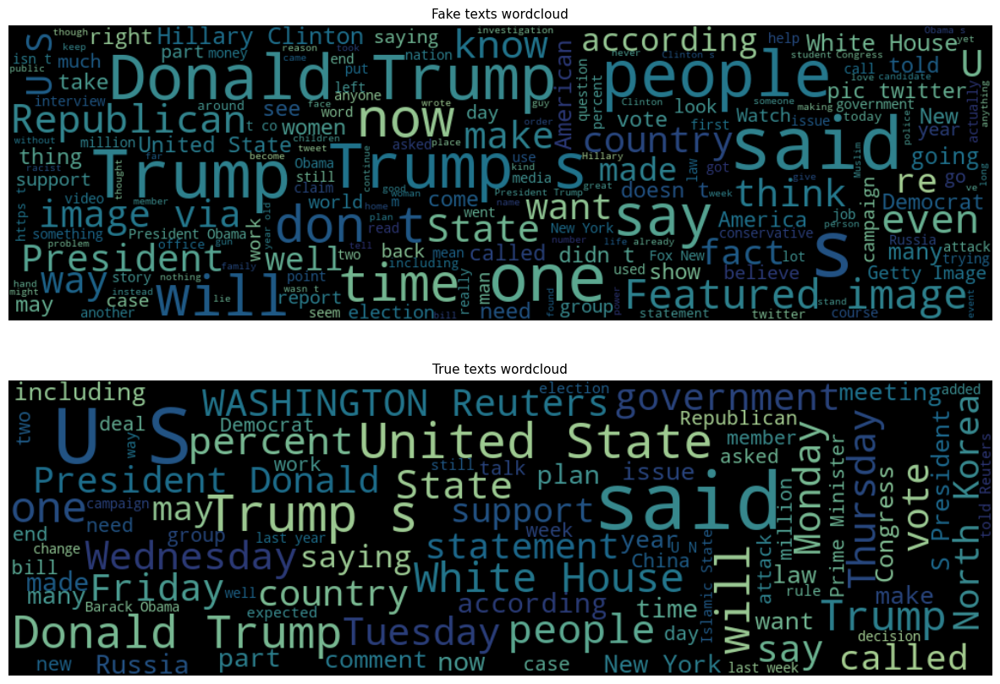

In [158]:
fig, axes = plt.subplots(2, 1, figsize=(15, 10))
axes = axes.ravel()

axes[0].imshow(wordcloud_fake, interpolation='bilinear')
axes[0].set_title('Fake texts wordcloud')
axes[0].axis('off')

axes[1].imshow(wordcloud_true, interpolation='bilinear')
axes[1].set_title('True texts wordcloud')
axes[1].axis('off');

*Comments:*
* As observed previously, words like 'WASHINGTON' and 'Reuters' are disproportionally frequent between true information texts. As these words are not contextual, it is better to remove them.
* Commonly found words in texts of fake articles: Trump, President, people, State, Republican, said. These words are bigger than those in the true information articles, therefore they are used more frequently. So there are less frequent words in fake information, but they appear more frequently.
* Commonly found words in true articles: said, United State, WASHINGTON, Reuters, Wednesday, Trump, U S.


In [159]:
fake_titles = all_information.loc[all_information['status']=='Fake']['title']
true_titles = all_information.loc[all_information['status']=='True']['title']

In [160]:
wordcloud_fake = WordCloud(
    **wordcloud_params
).generate(" ".join(fake_titles))

In [161]:
wordcloud_true = WordCloud(
    **wordcloud_params
).generate(' '.join(true_titles))

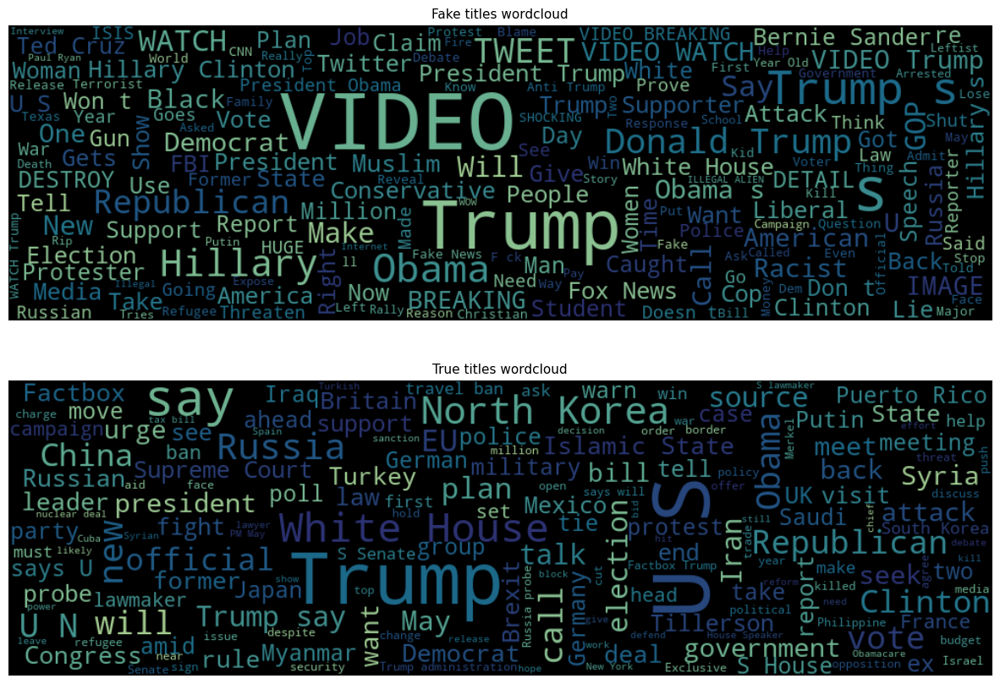

In [162]:
fig, axes = plt.subplots(2, 1, figsize=(15, 10))
axes = axes.ravel()

axes[0].imshow(wordcloud_fake, interpolation='bilinear')
axes[0].set_title('Fake titles wordcloud')
axes[0].axis('off')

axes[1].imshow(wordcloud_true, interpolation='bilinear')
axes[1].set_title('True titles wordcloud')
axes[1].axis('off');

*Comments:*
* Fake article titles - most of the words that are common in fake article titles are normal words that coultd be found in both fake and true titles. However, there are some words that are not common between true titles but are more frequent in fake titles: video, claim, shut, image, leftist, racist, reveal, threaten, ILLEGAL ALIEN, SHOCKING, BREAKING and others. There are more strong language and radical words used in titles of fake news.

In [163]:
contains_repetitions = all_information['text'].apply(
    lambda x: sum(
        [word in (['Reuters', 'WASHINGTON', 'YORK', 'SEATTLE']) \
         for word in x.split()])
)

In [164]:
repetitions = sum(contains_repetitions > 0)
df_len = len(contains_repetitions)

print(f'Contains repetition words: {repetitions}')
print(f'Total number of examples: {df_len}')
print(f'Percentage of entries with repetitions: '
      f'{repetitions /df_len *100:.2f} %')

Contains repetition words: 9856
Total number of examples: 38658
Percentage of entries with repetitions: 25.50 %


*Comments:*
* 25.5 % of all entries (fake/true) contain repetitions such as Reuters, WASHINGTON, YORK or SEATTLE. As such a high percentage of entries have repetitions, it is the best to remove them from the texts.

To remove these repetitive words, I will use the text_caps_words column containing extracted words from the texts. When, review the frequencies of such words and their possible repetitivness in the texts.

In [165]:
all_information['text_caps_words']

0        [WASHINGTON, U, S, U, S, CBS, I, U, S, CBS, I,...
1        [WASHINGTON, U, S, A, DOD, GLAD, I, GLAD, D, C...
2          [WASHINGTON, CBS, I, U, S, FBI, FBI, FBI, I, I]
3                       [WASHINGTON, FBI, U, S, FBI, U, S]
4        [SEATTLE, WASHINGTON, U, S, AMZN, O, MUCH, MOR...
                               ...                        
22698    [TV, HIGH, DRAMA, TV, TV, TV, US, HIPAA, US, C...
22699    [AP, A, FBI, A, B, CNN, LIVE, LIVE, CNN, CNN, ...
22700    [ACR, LIVE, PM, PST, PM, EST, ACR, ACR, J, BOI...
22701    [A, US, DOUBLE, JEOPARDY, BLM, BLM, A, NO, U, ...
22702    [D, TROUBLE, IN, HIS, KEEP, TV, T, PR, DC, AFP...
Name: text_caps_words, Length: 38658, dtype: object

In [166]:
collected_repetitive_words = []

for word_list in all_information['text_caps_words']:
    collected_repetitive_words.extend(word_list[0:2])

In [167]:
collected_repetitive_words = [
    word for word in collected_repetitive_words if len(word) > 1]

In [168]:
collected_repetitive_words = Counter(collected_repetitive_words)

In [169]:
collected_repetitive_words

Counter({'WASHINGTON': 6796,
         'GOP': 1569,
         'CNN': 1105,
         'NEW': 1001,
         'FBI': 913,
         'YORK': 822,
         'US': 764,
         'LONDON': 746,
         'MOSCOW': 659,
         'EU': 629,
         'BERLIN': 525,
         'BEIJING': 489,
         'TV': 423,
         'MSNBC': 382,
         'BRUSSELS': 377,
         'BEIRUT': 369,
         'CITY': 334,
         'PARIS': 326,
         'ISIS': 314,
         'NBC': 298,
         'ABC': 279,
         'ANKARA': 268,
         'LGBT': 240,
         'SEOUL': 236,
         'DNC': 236,
         'MEXICO': 234,
         'TOKYO': 226,
         'CIA': 217,
         'MADRID': 216,
         'GENEVA': 209,
         'UNITED': 205,
         'NATIONS': 198,
         'DUBAI': 188,
         'SAN': 184,
         'CBS': 182,
         'NATO': 182,
         'CEO': 180,
         'DC': 177,
         'NOT': 169,
         'CAIRO': 168,
         'BAGHDAD': 166,
         'NFL': 163,
         'FOX': 163,
         'POTUS': 161,
      

*Comments:*
* Some of the repeated words that have been showed previously - WASHINGTON, YORK etc. Other all caps repetitive words that are probably not associated with the text are names of broadcasting agencies such as 'CNN', 'NBC', 'ABC', 'MSNBC', 'CBS', 'NEWS' and some names of the cities, from which the news are broadcasted: 'LONDON', 'MOSCOW', 'BERLIN', 'BEIJING', 'BRUSSELS', 'BEIRUT', 'PARIS', 'ANKARA', 'MEXICO', 'SEOUL', 'TOKYO', 'MADRID' and others. As city names are used at the beginning of the text, if the text contains all caps city name or agency name it will be removed from the text. 

* As there are many repeated city names, only those that are repeated more than 50 times will be removed.

In [170]:
city_agency_names = [
    'WASHINGTON', 'CNN', 'YORK', 'LONDON', 'MOSCOW','BERLIN', 'BEIJING',
    'MSNBC','BRUSSELS','BEIRUT','CITY','PARIS','NBC','ABC','ANKARA','SEOUL',
    'MEXICO','TOKYO','MADRID','GENEVA','DUBAI','SAN','CBS','CAIRO','BAGHDAD',
    'FOX', 'MANILA','CHICAGO','ISTANBUL', 'HARARE','NAIROBI','SYDNEY',
    'JERUSALEM','FRANCISCO','ROME','JOHANNESBURG','RIYADH','CARACAS','HAVANA',
    'VIENNA', 'YANGON', 'DUBLIN', 'BARCELONA', 'BRASILIA', 'BANGKOK','JAKARTA',
    'BBC','KABUL','WELLINGTON','KIEV','ISLAMABAD','WARSAW','DELHI','BOSTON',
    'KUALA','BUENOS','AIRES','LIMA','LUMPUR','CLEVELAND','LOS','ATHENS',
    'ERBIL','OTTAWA','ANGELES','AUSTIN'
]

In [172]:
all_information['text'] = all_information['text'].apply(
    lambda x: cf.remove_first_caps_word(x, city_agency_names))

In [174]:
all_information['text'] = all_information['text'].apply(cf.remove_reuters)

*Comments:*
* As now the number of all-caps words has changed, especially for the true articles that contained city names or agency names at the beginning of the text, It would be interesting to review how the all-caps word counts have changed between true and fake articles.

In [176]:
all_information['text_caps_recounted'] = all_information['text'].apply(
    lambda x: cf.count_all_longer_caps(x)
)

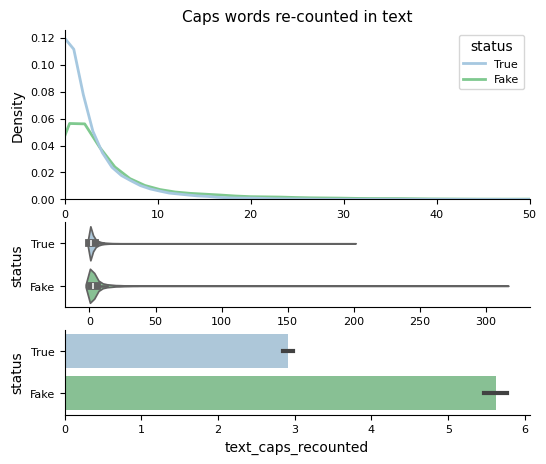

In [177]:
fig, axes = plt.subplots(
    3, 1,
    figsize=(6, 5),
    gridspec_kw={'height_ratios': (2, 1, 1)}
    )
axes = axes.ravel()

columns = [
    'text_caps_recounted'
]
names = [
    'Caps words re-counted in text'
]
xlim = [50]

for i, col in enumerate(columns):
    sns.kdeplot(
        data=all_information,
        x=col,
        ax=axes[i],
        hue='status'
    )
    axes[i].set_title(names[i])
    axes[i].set_xlim(0, xlim[i]);

    sns.violinplot(
        data=all_information,
        y='status',
        x=col,
        ax=axes[i+1],
        hue='status'
    )

    sns.barplot(
        data=all_information,
        y='status',
        x=col,
        ax=axes[i+2],
        hue='status'
    )


*Comments:*
* Removing of all-caps words that were repetitive and not associated with text, increased the distance between fake and true articles in number of all-caps words found in text.

### <a id='toc1_6_5_'></a>[Common words in fake article text/title](#toc0_)

Some repetitive words have been observed between fake news text and title. Such words as 'BREAKING', 'SHOCKING', 'VIDEO', 'TWEET', 'Racist', 'Reveal', 'ILLEGAL', 'ALIEN', 'DESTROY' are used to get the attention of the reader and are usually associated with fake information. Selection of such words will be tested on fake and true articles - their titles and texts.

In [178]:
attention_words = [
    'BREAKING', 'SHOCKING', 'VIDEO', "TWEET", 'Racist', 'racist', 'Reveal',
    'reveal', 'ILLEGAL', 'ALIEN', 'DESTROY', 'Attack', 'WATCH', 'Blame',
    'IMAGE', 'WOW', 'Fake', 'Illegal', 'image', 'don t', 'claim', 'doesn t',
    'actually', 'twitter', 'pic', 'isn t'
]

* Attention words were selected based on most frequent word cloud between fake article titles and texts.

In [179]:
all_information['contains_attention_words_texts'] = (
    all_information['text']
    .apply(lambda x: [word for word in  x.split() if word in attention_words])
)
all_information['contains_attention_words_title'] = (
    all_information['title']
    .apply(lambda x: [word for word in  x.split() if word in attention_words])
)

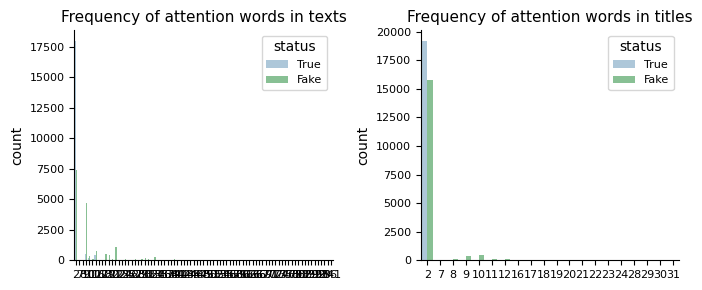

In [757]:
fig, axes = plt.subplots(1, 2, figsize=(7, 3))
axes = axes.ravel()

attention_word_count_text = [len(word_list) for word_list in \
                             all_information['contains_attention_words_texts']]
attention_word_count_title = [len(word_list) for word_list in \
                             all_information['contains_attention_words_title']]

sns.countplot(
    x=attention_word_count_text,
    hue=all_information['status'],
    ax=axes[0],
)
sns.countplot(
    x=attention_word_count_title,
    hue=all_information['status'],
    ax=axes[1],
)

axes[0].set_title('Frequency of attention words in texts')
axes[1].set_title('Frequency of attention words in titles');
plt.tight_layout()

* Attention words are more common in texts and titles of fake news articles. 
* Most of the true articles do not have attention words in texts, and rarely have 1 such word. Fake news articles have up to 14 such words in the texts.

* Most of the titles do not contain attention words. Rarely there could be 1 or 2 attention words in fake news titles.

**Individual attention word analysis in true/fake texts/titles**

In [181]:
attention_words_appearing_true_text = []
attention_words_appearing_fake_text = []

attention_words_appearing_true_title = []
attention_words_appearing_fake_title = []

for idx, row in all_information.iterrows():
    if row['status'] =='True':
        attention_words_appearing_true_text.extend(
            row['contains_attention_words_texts'])
        attention_words_appearing_true_title.extend(
            row['contains_attention_words_title'])
    else:
        attention_words_appearing_fake_text.extend(
            row['contains_attention_words_texts'])
        attention_words_appearing_fake_title.extend(
            row['contains_attention_words_title'])

In [182]:
attention_words_appearing_true_text = (
    Counter(attention_words_appearing_true_text))
attention_words_appearing_fake_text = (
    Counter(attention_words_appearing_fake_text))
attention_words_appearing_true_title = (
    Counter(attention_words_appearing_true_title))
attention_words_appearing_fake_title = (
    Counter(attention_words_appearing_fake_title))

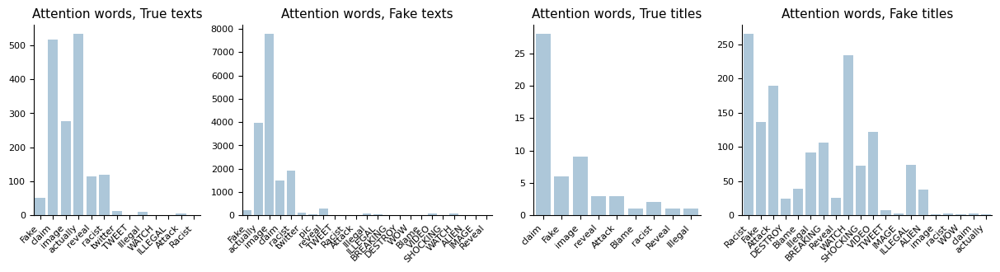

In [183]:
fig,axes = plt.subplots(
    1, 4, figsize=(15, 3),
    gridspec_kw={'width_ratios': (2, 3, 2, 3)}
    )
axes = axes.ravel()

dicts = [
    attention_words_appearing_true_text,
    attention_words_appearing_fake_text,
    attention_words_appearing_true_title,
    attention_words_appearing_fake_title
]
titles = [
    'Attention words, True texts',
    'Attention words, Fake texts',
    'Attention words, True titles',
    'Attention words, Fake titles'
]
for i, dic in enumerate(dicts):
    sns.barplot(
        dic,
        ax=axes[i]
    )
    axes[i].set_title(titles[i])
    axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45, ha='right')

In [184]:
words_only_in_fake_texts = [
    word for word in attention_words_appearing_fake_text.keys() \
        if word not in attention_words_appearing_true_text.keys()]
print(words_only_in_fake_texts)

['pic', 'BREAKING', 'DESTROY', 'WOW', 'Blame', 'VIDEO', 'SHOCKING', 'ALIEN', 'IMAGE', 'Reveal']


* There are multiple words that appear only in fake article texts such as displayed above. However, some of them appear really rarely - 'ALIEN', 'Reveal', 'pic', 'DESTROY', 'BREAKING', etc. 
* Other attention words that appear in both true and fake texts are more common: 'claim', 'image', 'actually'. However, in fake texts they appear almost 10 times more frequently.

**Most frequent individual attention words in text/title of fake/true articles**

In [185]:
attention_words_appearing_fake_text = pd.DataFrame.from_dict(
    attention_words_appearing_fake_text.items()
)

In [186]:
attention_words_appearing_fake_text.columns = ['words', 'fake_text_count']

In [187]:
attention_words_df = attention_words_appearing_fake_text

dicts = [
    attention_words_appearing_true_text,
    attention_words_appearing_true_title,
    attention_words_appearing_fake_title
]
col_adds = [
    'true_text_count',
    'true_title_count',
    'fake_title_count'
]

for i, dic in enumerate(dicts):
    df = pd.DataFrame.from_dict(dic.items())
    df.columns = ['words', col_adds[i]]
    attention_words_df = attention_words_df.merge(
        df,
        on='words',
        how='left'
    )

In [188]:
attention_words_df['fake_to_true_text'] = (
    attention_words_df['fake_text_count'] / 
    attention_words_df['true_text_count'])
attention_words_df['fake_to_true_title'] = (
    attention_words_df['fake_title_count'] / 
    attention_words_df['true_title_count']
)

In [759]:
fig, axes = plt.subplots(1, 2, figsize=(8, 3))
axes = axes.ravel()

cols_to_plot = [
    'fake_to_true_text',
    'fake_to_true_title'
]

for i, col in enumerate(cols_to_plot):
    sns.barplot(
        data=attention_words_df.sort_values(col, ascending=False),
        x='words',
        y=col,
        ax=axes[i]
    )
    axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45, ha='right')
    axes[i].axhline(1, c='r', linewidth=0.5, linestyle='--')

axes[0].set_title('Proportion of attention words \nFake to True, text')
axes[1].set_title('Proportion of attention words \nFake to True, title');
    
plt.tight_layout()

In [190]:
attention_words_df.sort_values('fake_to_true_text', ascending=False)

,words,fake_text_count,true_text_count,true_title_count,fake_title_count,fake_to_true_text,fake_to_true_title
19,WATCH,59,1.0,NaN,234.0,59.000000,NaN
12,ILLEGAL,34,1.0,NaN,74.0,34.000000,NaN
2,image,7783,276.0,9.0,1.0,28.199275,0.111111
9,Racist,22,1.0,NaN,265.0,22.000000,NaN
4,racist,1920,119.0,2.0,2.0,16.134454,1.000000
8,TWEET,14,1.0,NaN,7.0,14.000000,NaN
5,twitter,126,13.0,NaN,NaN,9.692308,NaN
1,actually,3953,533.0,NaN,1.0,7.416510,NaN
11,Illegal,58,10.0,1.0,92.0,5.800000,92.000000
0,Fake,230,51.0,6.0,136.0,4.509804,22.666667


*Comments:*
* Highest proportion of attention words shows the highest enrichment of such attention words between fake article titles and texts. The higher this value, the more it is unusual for such a word to appear in true article text/title.
* WATCH, ILLEGAL, image, Racist, racist show the highest propotion in fake texts. Words like pic, BREAKING etc that do not have a propotion value are the words that do not appear in true texts.
* Illegal, Attack, Blame, Reveal and Fake are the most represented in titles of fake articles. 

* Words like Attack, claim and reveal show only 2-3 times higher frequency in fake article texts than in true article texts. However claim and reveal are quite frequent words.

### <a id='toc1_6_6_'></a>[Special characters, tags etc](#toc0_)

Special characters can be useful in finding associations with fake and true comments. Together with special characters, html tags, url links, numbers, emotions and hashes will be counted in 

In [192]:
new_column_names = [
    'html_tags_text',
    'url_links_text',
    'special_chars_text',
    'numbers_text',
    'emotions_text',
    'hashes_text']

functions = [
    cf.count_html_tags,
    cf.count_url_links,
    cf.count_special_chars,
    cf.count_numbers,
    cf.count_emotions,
    cf.count_hash_mentions
]

for col, func in zip(new_column_names, functions):
    all_information[col] = (
        all_information['text'].apply(lambda x: func(x))
    )

In [193]:
new_column_names = [
    'html_tags_title',
    'url_links_title',
    'special_chars_title',
    'numbers_title',
    'emotions_title',
    'hashes_title']

for col, func in zip(new_column_names, functions):
    all_information[col] = (
        all_information['title'].apply(lambda x: func(x))
    )

**Special characters in texts**

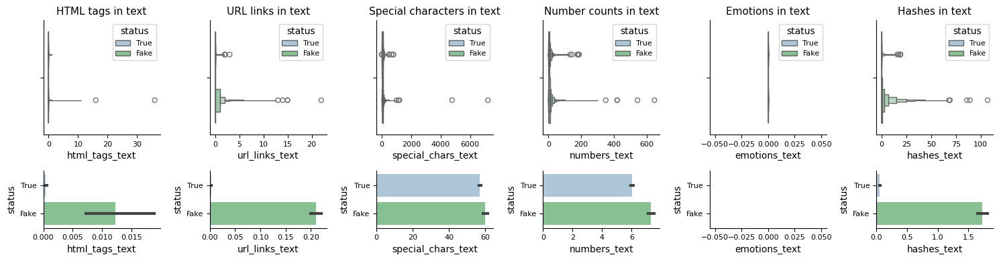

In [194]:
fig, axes = plt.subplots(
    2, 6,
    figsize=(15, 4),
    gridspec_kw={'height_ratios': (2, 1)}
    )
axes = axes.ravel()

columns = [
    'html_tags_text',
    'url_links_text',
    'special_chars_text',
    'numbers_text',
    'emotions_text',
    'hashes_text'
]
names = [
    'HTML tags in text',
    'URL links in text',
    'Special characters in text',
    'Number counts in text',
    'Emotions in text',
    'Hashes in text'
]

for i, col in enumerate(columns):
    sns.boxenplot(
        data=all_information,
        x=col,
        ax=axes[i],
        hue='status'
    )
    axes[i].set_title(names[i])

    sns.barplot(
        data=all_information,
        y='status',
        x=col,
        ax=axes[i+6],
        hue='status'
    )
plt.tight_layout();

*Comments:*
* `HTML tags` - are rare in the text, typically, there are no HTML tags in the text. Comparing by average, html tags are more frequent between fake articles.
* `URL links` - rare, typically not found in texts. Comparing by average, more frequent between fake articles.
* `Special characters` - more frequent that HTML tags or links. Typically not ocurring in text, however, up to a few thousanf of such characters can be found in texts. Similar average count between fake and true articles.
* `Numbers` - typically not found in texts. Up to a few hundred can be found in texts. Similar average count between fake and true articles.
* `Emotions` - not found in texts.
* `Hashes` - typically not found in texts. More frequent in fake texts, up to 100 hashes in an article.

**Special characters in titles**

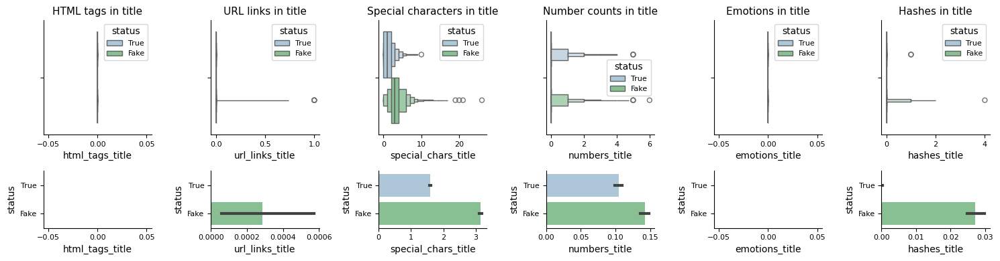

In [195]:
fig, axes = plt.subplots(
    2, 6,
    figsize=(15, 4),
    gridspec_kw={'height_ratios': (2, 1)}
    )
axes = axes.ravel()

columns = [
    'html_tags_title',
    'url_links_title',
    'special_chars_title',
    'numbers_title',
    'emotions_title',
    'hashes_title'
]
names = [
    'HTML tags in title',
    'URL links in title',
    'Special characters in title',
    'Number counts in title',
    'Emotions in title',
    'Hashes in title'
]

for i, col in enumerate(columns):
    sns.boxenplot(
        data=all_information,
        x=col,
        ax=axes[i],
        hue='status'
    )
    axes[i].set_title(names[i])

    sns.barplot(
        data=all_information,
        y='status',
        x=col,
        ax=axes[i+6],
        hue='status'
    )
plt.tight_layout();

*Comments:*
* `HTML tags` - there are no html tags in true and fake titles.
* `URL links` - no URL links in true article titles. There might be some URL links in fake titles, however, the average values are very low and most usually no URL links are found between fake titles.
* `Special characters` - special characters are more usual in fake titles.
* `Numbers` - use of numbers is more common in fake titles.
* `Emotions` - no emotions are found in titles.
* `Hashes` - hashes are extremely uncommon between true article titles, but more common between fake titles.

**Combinations of special characters in texts**

In [196]:
all_information['special_chars_combination'] = list(
    zip(
        (all_information['html_tags_text'] > 0).astype(int),
        (all_information['url_links_text'] > 0).astype(int),
        (all_information['special_chars_text'] > 0).astype(int),
        (all_information['numbers_text'] > 0).astype(int),
        (all_information['emotions_text'] > 0).astype(int),
        (all_information['hashes_text'] > 0).astype(int)
    )
)

In [197]:
def get_special_char_combination_count(combination_col):
    true_articles = all_information.loc[all_information['status']=='True']
    fake_articles = all_information.loc[all_information['status']=='Fake']
    
    combination_counts_true = pd.DataFrame(
        true_articles[combination_col].value_counts().reset_index()
    )
    combination_counts_fake = pd.DataFrame(
        fake_articles[combination_col].value_counts().reset_index()
    )

    combination_counts_true.columns = ['combinations','counts']
    combination_counts_fake.columns = ['combinations','counts']

    expanded_combinations_true = (
        pd.DataFrame(combination_counts_true['combinations'].tolist(), columns=[
        'html_tags', 'url_links', 'special_chars', 'numbers', 'emotions', 'hashes'
    ]))
    expanded_combinations_fake = (
        pd.DataFrame(combination_counts_fake['combinations'].tolist(), columns=[
        'html_tags', 'url_links', 'special_chars', 'numbers', 'emotions', 'hashes'
    ]))

    expanded_combinations_true['counts'] = combination_counts_true['counts']
    expanded_combinations_fake['counts'] = combination_counts_fake['counts']

    expanded_combinations_all = expanded_combinations_true.merge(
        expanded_combinations_fake,
        on=['html_tags', 'url_links', 'special_chars',
            'numbers', 'emotions','hashes'],
        suffixes=('_true', '_fake')
    )
    expanded_combinations_all['fake_to_true_proportion'] = (
        expanded_combinations_all['counts_fake'] /
        expanded_combinations_all['counts_true']
    )
    return expanded_combinations_all

In [198]:
text_combination_counts = get_special_char_combination_count(
    'special_chars_combination')

In [199]:
text_combination_counts

,html_tags,url_links,special_chars,numbers,emotions,hashes,counts_true,counts_fake,fake_to_true_proportion
0,0,0,1,1,0,0,16705,8473,0.507213
1,0,0,1,0,0,0,4046,3008,0.743450
2,0,0,1,1,0,1,365,3269,8.956164
3,0,1,1,1,0,0,33,658,19.939394
4,0,0,1,0,0,1,31,75,2.419355
5,0,1,1,1,0,1,7,1847,263.857143
6,1,0,1,1,0,0,5,12,2.400000
7,1,0,1,1,0,1,3,35,11.666667
8,0,1,1,0,0,0,1,35,35.000000


*Comments:*
* Combinations that are more common in fake texts:
    * URL links, special characters, numbers and hashes appearing in one text are >250 times more frequent in fake texts.
    * URL links, special characters, numbers appearing together. ~20 more common in fake texts.
    * URL links and special characters appearing together. 35 times more common in fake texts, however, quite rare combination.
    * special characters together with numbers and hashes. ~9 times more common in fake texts.

**Combination of special characters in titles**

In [200]:
all_information['special_chars_combination_title'] = list(
    zip(
        (all_information['html_tags_title'] > 0).astype(int),
        (all_information['url_links_title'] > 0).astype(int),
        (all_information['special_chars_title'] > 0).astype(int),
        (all_information['numbers_title'] > 0).astype(int),
        (all_information['emotions_title'] > 0).astype(int),
        (all_information['hashes_title'] > 0).astype(int)
    )
)

In [201]:
title_combination_counts = get_special_char_combination_count(
    'special_chars_combination_title')

In [202]:
title_combination_counts

,html_tags,url_links,special_chars,numbers,emotions,hashes,counts_true,counts_fake,fake_to_true_proportion
0,0,0,1,0,0,0,14270,13661,0.957323
1,0,0,0,0,0,0,5165,1582,0.306292
2,0,0,1,1,0,0,1451,1664,1.146795
3,0,0,0,1,0,0,307,101,0.328990
4,0,0,1,0,0,1,3,270,90.000000


*Comments:*
* Only 5 combinations of special characters are found in titles.
* All combinations except the last one - where special characters appear together with hashes in titles - are equally or less common in true article titles. However, as the combination of special characters with hashes is quite rare, not much information is added from these findings.

### <a id='toc1_6_7_'></a>[Analysis of common topics](#toc0_)

Wordcloud have already gave some insight about possible topics that are discussed and commented in the texts of fake and true articles. Many of the articles have such words as President, Trump, Clinton, names of different states like US, Russia, North Korea and others represented. Such words suggest that common topics could be presidential election, world politics, international relations and other.

To analyze common topics, top bigrams and trigrams will be reviewed in the article titles and texts.

In [204]:
true_articles = all_information.loc[all_information['status']=='True']
fake_articles = all_information.loc[all_information['status']=='Fake']

In [205]:
top_bi_grams_true = cf.get_top_ngram(true_articles['title'],n=2)
top_bi_grams_fake = cf.get_top_ngram(fake_articles['title'],n=2)

In [206]:
top_tri_grams_true = cf.get_top_ngram(true_articles['title'],n=3)
top_tri_grams_fake = cf.get_top_ngram(fake_articles['title'],n=3)

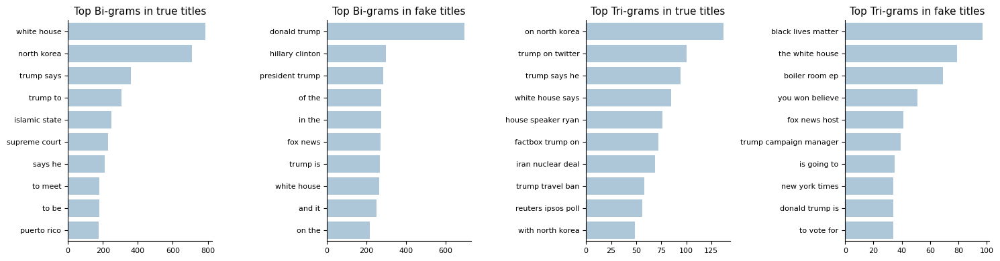

In [207]:
fig, axes = plt.subplots(1, 4, figsize=(15, 4))
axes = axes.ravel()

ngrams_data = [
    top_bi_grams_true,
    top_bi_grams_fake,
    top_tri_grams_true,
    top_tri_grams_fake
]
titles = [
    'Top Bi-grams in true titles',
    'Top Bi-grams in fake titles',
    'Top Tri-grams in true titles',
    'Top Tri-grams in fake titles'

]
for i, ngram in enumerate(ngrams_data):
    x,y=map(list,zip(*ngram))
    sns.barplot(
        x=y,
        y=x,
        ax=axes[i])
    axes[i].set_title(titles[i])

plt.tight_layout();

*Comments:*
* `Bi-grams`:
    * Most frequently used phrases in true titles were 'white house' and 'north korea', follwed by 'trump says' and 'trump to. These are topics associated with political processes and international relations.
    * Most frequent phrases in fake titles are similar. Here the most common phrases are 'donald trump', 'hilary clinton' and 'president trump'. These are also associated with political processes, probably more with the presidential elections in 2016.
* `Tri-grams`:
    * Most frequent phrases in true titles: 'on north korea', 'trump on twitter', 'trump says he' - these phrases basically repeat similar phrases in bi-grams and are associated with political processes and international relations. Other top titles are also associated with Iran and the White House.
    * Tri-grams in fake titles have some differences: although some of them could be associated with political processes like 'trump campaign manager', 'donald trump is', 'to vote for', but other phrases could be used as attention-seeking or reaction-causing phrases - 'black lives matter', 'boiler room ep', 'you won believe'. The phrase 'boiler room ep' in the context of fake news is used by the fake news creators themselves to indicate the spread of other articles as fake.

In [208]:
top_bi_grams_true_text = cf.get_top_ngram(true_articles['text'],n=2)
top_bi_grams_fake_text = cf.get_top_ngram(fake_articles['text'],n=2)

In [209]:
top_tri_grams_true_text = cf.get_top_ngram(true_articles['text'],n=3)
top_tri_grams_fake_text = cf.get_top_ngram(fake_articles['text'],n=3)

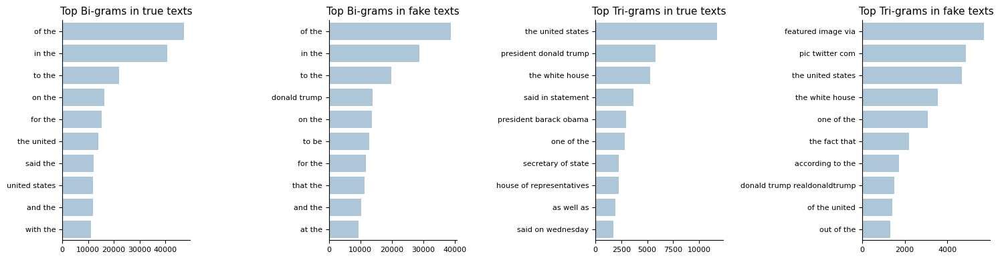

In [210]:
fig, axes = plt.subplots(1, 4, figsize=(15, 4))
axes = axes.ravel()

ngrams_data = [
    top_bi_grams_true_text,
    top_bi_grams_fake_text,
    top_tri_grams_true_text,
    top_tri_grams_fake_text
]
titles = [
    'Top Bi-grams in true texts',
    'Top Bi-grams in fake texts',
    'Top Tri-grams in true texts',
    'Top Tri-grams in fake texts'

]
for i, ngram in enumerate(ngrams_data):
    x,y=map(list,zip(*ngram))
    sns.barplot(
        x=y,
        y=x,
        ax=axes[i])
    axes[i].set_title(titles[i])

plt.tight_layout();

*Comments:*
* `Bi-grams`:
    * No information could be gained from bi-grams as they are too short to contain condensed information about the context of the articles.
* `Tri-gram`:
    * True texts: similar phrases as seen in titles are repeated in the texts - 'the united states', 'president donald trump', 'secretary of state' and others are connected with political processes.
    * Fake texts: two of the most common phrases are not really associated with political or other backgroud - 'featured image via', 'pic twitter com' - these are some click-bait phrases used to get the reader to click on the link. Other common phrases are somwhat connected with political processes.

### <a id='toc1_6_8_'></a>[Vocabluary size and richness](#toc0_)

Count the number of unique tokens, analyze stopword frequency
Check for highly similar texts
Calculate metrics like type-token-ratio (TTR) which measures the diversity of the vocabluary.

Zipf's law
Check if the word frequency follows the expected power-law distribution

**Unique tokens**

Unique tokens in texts and titles will be analyzed.

In [211]:
tokens_true_text = []
tokens_fake_text = []
tokens_true_title = []
tokens_fake_title = []

for idx, row in all_information.iterrows():
    text = row['text']
    title = row['title']
    tokens_text = word_tokenize(text.lower())
    tokens_title = word_tokenize(title.lower())
    if row['status']=='True':
        tokens_true_text.extend(tokens_text)
        tokens_true_title.extend(tokens_title)
    else:
        tokens_fake_text.extend(tokens_text)
        tokens_fake_title.extend(tokens_title)

In [212]:
unique_tokens = {}

unique_tokens['true_text'] = set(tokens_true_text)
unique_tokens['fake_text'] = set(tokens_fake_text)
unique_tokens['true_title'] = set(tokens_true_title)
unique_tokens['fake_title'] = set(tokens_fake_title)

In [213]:
unique_tokens_len = {}
for token_group, unique_tokens in unique_tokens.items():
    unique_tokens_len[token_group] = len(unique_tokens)

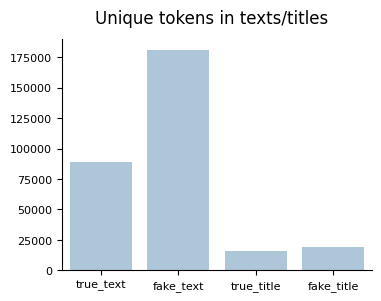

In [214]:
sns.barplot(
    unique_tokens_len
)
plt.suptitle('Unique tokens in texts/titles');

*Comments:*
* There are twice as many unique tokens in fake texts than in true texts.
* Titles have similar number of tokens.

**Type-token-ratio calculation**

Lexical diversity calculation

In [216]:
all_information['ttr_text'] = (
    all_information['text']
    .apply(lambda text: cf.calculate_ttr(text))
    )

all_information['ttr_title'] = (
    all_information['title']
    .apply(lambda title: cf.calculate_ttr(title))
)

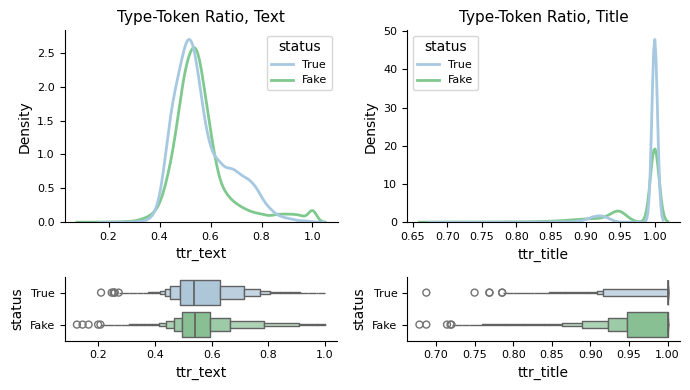

In [217]:
fig, axes = plt.subplots(
    2, 2, figsize=(7, 4),
    gridspec_kw={'height_ratios': (3, 1)})

axes = axes.ravel()

cols_to_plot = ['ttr_text', 'ttr_title']
titles = ['Type-Token Ratio, Text', 'Type-Token Ratio, Title']

for i, col in enumerate(cols_to_plot):
    sns.kdeplot(
        data=all_information,
        x=col,
        ax=axes[i],
        hue='status',
    )
    axes[i].set_title(titles[i])

    sns.boxenplot(
        data=all_information,
        x=col,
        y='status',
        ax=axes[i+2],
        hue='status',
    )

plt.tight_layout()

*Comments:*
* Text - fake and true texts show very similar density and median values of type-token ratio. True texts show higher density at ttr values of 0.65-0.85 meaning that there is a higher proportion of texts with more unique tokens (or words) used.
* Titles - most fake and true titles show ttr value close to 1. It means most titles contain only unique words. 

**Power-law word frequency distribution**

According to Zipf's law, in a corpus of natural language, the frequency of any word is inversly proportional to its rank in the frequency table. So the most frequent word occurs approximately twice as often as the second most frequent word.

Failing to comply with power-law could mean that the text is very specialized, AI generated, or some words are way overused. 

In [219]:
true_texts = all_information.loc[all_information['status']=='True']['text']
fake_texts = all_information.loc[all_information['status']=='Fake']['text']

combined_texts_true = ' '.join(true_texts)
combined_texts_fake = ' '.join(fake_texts)

In [220]:
token_rank_true, token_frequencies_true = (
    cf.get_word_frequencies(combined_texts_true)
)

token_rank_fake, token_frequencies_fake = (
    cf.get_word_frequencies(combined_texts_true)
)

In [224]:
log_ranks_true = np.log(token_rank_true)
log_ranks_fake = np.log(token_rank_fake)

log_frequencies_true = np.log(token_frequencies_true)
log_frequencies_fake = np.log(token_frequencies_fake)

true_reg_results = cf.get_regression_results(
    log_ranks_true,
    log_frequencies_true)

fake_reg_results = cf.get_regression_results(
    log_ranks_fake,
    log_frequencies_fake)

In [225]:
reg_results = [true_reg_results, fake_reg_results]

In [226]:
reg_results[0]

{'slope': -1.6802294240042608,
 'intercept': 19.0479758038551,
 'r_value': -0.9894389806803595,
 'p_value': 0.0,
 'std_err': 0.0007763402775107139}

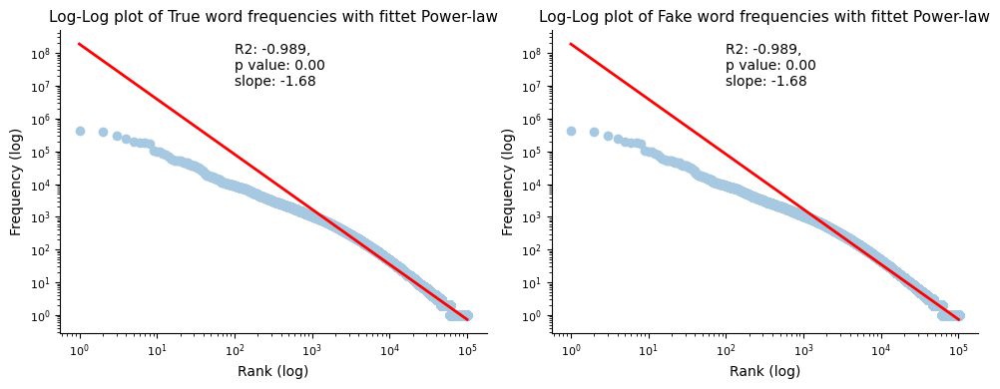

In [227]:
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes = axes.ravel()

ranks = [token_rank_true, token_rank_fake]
frequencies = [token_frequencies_true, token_frequencies_fake]
reg_results = [true_reg_results, fake_reg_results]
titles = ['Log-Log plot of True word frequencies with fittet Power-law',
          'Log-Log plot of Fake word frequencies with fittet Power-law']

for i, (rank, freq) in enumerate(zip(ranks, frequencies)):
    slope = reg_results[i]['slope']
    intercept = reg_results[i]['intercept']
    p_value = reg_results[i]['p_value']
    r_value = reg_results[i]['r_value']

    axes[i].loglog(
        rank,
        freq, 
        marker='o',
        linestyle='none')
    
    axes[i].loglog(
        rank,
        np.exp(intercept) * rank** slope,
        label=f"Fit: slope={slope:.2f}",
        color="red")
    
    axes[i].set_title(titles[i])
    axes[i].set_xlabel('Rank (log)')
    axes[i].set_ylabel('Frequency (log)')
    axes[i].text(1e2, 1e7, f'R2: {r_value:.3f}, \np value: {p_value:.2f}'
                 f'\nslope: {slope:.2f}');

plt.tight_layout()

*Comments:*
* Word frequencies in both true and fake texts show alienation from the power-law distribution. 
* Slope of -1.68 is steep, so text words are less evenly distributed with few high-frequency words dominating.
* Although R2 and p values show statistically significant relationship, the bent in the curve indicates deviation from the power-law distribution.

* As both fake and true texts show similar results, my assumption is that this deviation from power-law is determined by text characteristics - most of the texts analyzed show political theme.

### <a id='toc1_6_9_'></a>[Stopword frequency](#toc0_)

In [228]:
stop_words = set(stopwords.words('english'))

In [229]:
tokens = dict(
    tokens_true_text = tokens_true_text,
    tokens_fake_text = tokens_fake_text,
    tokens_true_title = tokens_true_title,
    tokens_fake_title = tokens_fake_title
)

In [230]:
stopword_counts = {}

for token_group, tokens_list in tokens.items():
    stopword_counts[token_group] = Counter([word for word in tokens_list \
                                            if word in stop_words])

In [231]:
stopword_counts_df = pd.DataFrame.from_dict(stopword_counts)
stopword_counts_df = stopword_counts_df.reset_index()

In [232]:
stopword_counts_df_melted = stopword_counts_df.melt(
    id_vars= 'index',
    value_vars=["tokens_true_text", "tokens_fake_text", "tokens_true_title", 
                "tokens_fake_title"],
    var_name="token_group",  
    value_name="frequency"
)

In [233]:
stopword_counts_df_melted.fillna(0, inplace=True)

In [234]:
top_stopwords = (
    stopword_counts_df_melted
    .groupby(['index'])['frequency']
    .agg(['mean'])
    .sort_values('mean', ascending=False)
    .head(10)
).index

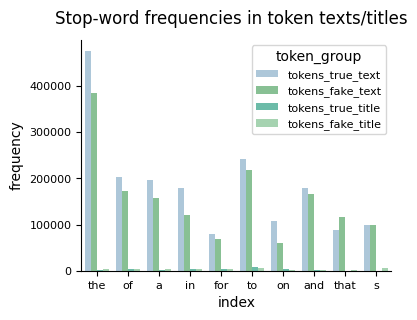

In [235]:
stopword_counts_df_top_words = (
    stopword_counts_df_melted.loc[
        stopword_counts_df_melted['index'].isin(top_stopwords)]
)

sns.barplot(
    data=stopword_counts_df_top_words,        
    x='index',
    y='frequency',
    hue='token_group',
    # hue_norm=True,
)
plt.suptitle('Stop-word frequencies in token texts/titles');

*Comments:*
* Top 10 stopwords show similar frequencies in true/fake texts and titles.

I would be interesting to find, which stopwords have higher representation in fake texts/titles compared to true articles.

In [236]:
stopword_counts_df.fillna(0, inplace=True)

In [237]:
stopword_counts_df.head()

,index,tokens_true_text,tokens_fake_text,tokens_true_title,tokens_fake_title
0,the,476131.0,384982,523.0,4659.0
1,of,202471.0,171736,2987.0,3536.0
2,a,195418.0,157672,587.0,2806.0
3,in,178374.0,119936,4558.0,3307.0
4,who,27312.0,31762,127.0,758.0


In [238]:
stopword_counts_df['fake_to_true_text'] = (
    stopword_counts_df['tokens_fake_text'] / 
    stopword_counts_df['tokens_true_text']
)
stopword_counts_df['fake_to_true_title'] = (
    stopword_counts_df['tokens_fake_title'] / 
    stopword_counts_df['tokens_true_title']
)
stopword_counts_df['fake_to_true_text'] = (
    stopword_counts_df['fake_to_true_text'].replace(['inf', np.inf], 0)
)
stopword_counts_df['fake_to_true_title'] = (
    stopword_counts_df['fake_to_true_title'].replace(['inf', np.inf], 0)
)

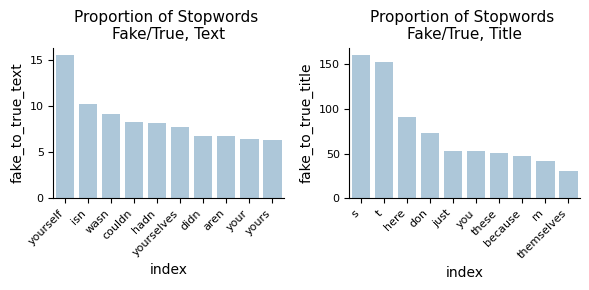

In [239]:
fig, axes = plt.subplots(1, 2, figsize=(6, 3))
axes = axes.ravel()

for i, col in enumerate(['fake_to_true_text', 'fake_to_true_title']):

    sns.barplot(
        data=(
            stopword_counts_df
            .sort_values(col, ascending=False)
            .head(10)),
        x='index',
        y=col,
        ax=axes[i]
    )
    axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45, ha='right')
axes[0].set_title('Proportion of Stopwords \nFake/True, Text')
axes[1].set_title('Proportion of Stopwords \nFake/True, Title')
plt.tight_layout();

*Comments:*
* Text: yourself, isn, wasn, could hadn and other similar contractions. It seems that such words are a lot more common in fake texts.
* Title: s, t, here and don are the most common stopwords used in fake article titles and are over-represented >50 times compared to true articles.

### <a id='toc1_6_10_'></a>[Text/title similarity](#toc0_)

Cosine similarity will be applied to check for similar texts.

In [240]:
true_fake_texts_titles = {}

true_fake_texts_titles['true_texts'] = (
    all_information.loc[all_information['status']=='True']['text']
)
true_fake_texts_titles['fake_text'] = (
    all_information.loc[all_information['status']=='True']['text']
)
true_fake_texts_titles['true_titles'] = (
    all_information.loc[all_information['status']=='True']['title']
)
true_fake_texts_titles['fake_titles'] = (
    all_information.loc[all_information['status']=='True']['title']
)

In [242]:
similarity_matrices = {}
  
for key, values in tqdm(true_fake_texts_titles.items()):
    sim_matrix = cf.get_similarity_matrix(values)
    similarity_matrices[key] = sim_matrix
    sim_matrix = pd.DataFrame(sim_matrix)

100%|██████████| 4/4 [01:31<00:00, 22.88s/it]


In [244]:
similar_text_collection = {}

for (name, matrix), (key, texts) in tqdm(
    zip(similarity_matrices.items(), true_fake_texts_titles.items()),
    desc="Processing Similar Texts",
    total=len(similarity_matrices)
):

    similar_text_collection[key] = cf.get_similar_texts(matrix, texts)

Processing Similar Texts: 100%|██████████| 4/4 [1:02:10<00:00, 932.58s/it]


In [245]:
similar_text_counts = {}
for group, text_dict in similar_text_collection.items():
    similar_text_counts[group] = []
    for text, similar_texts in text_dict.items():
        similar_text_counts[group].append(len(similar_texts))

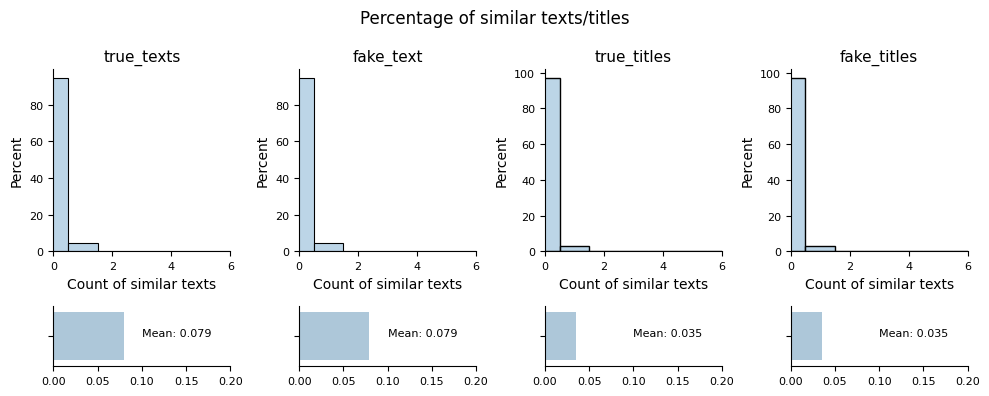

In [246]:
fig, axes = plt.subplots(
    2, 4,
    figsize=(10, 4),
    gridspec_kw={'height_ratios': (3, 1)}
    )
axes = axes.ravel()

for i, (group, values) in enumerate(similar_text_counts.items()):
    sns.histplot(
        data=similar_text_counts[group],
        ax=axes[i],
        stat='percent',
        discrete=True
    )
    axes[i].set_title(group)
    axes[i].set_xlim(0, 6)
    axes[i].set_xlabel('Count of similar texts')

    sns.barplot(
        x=[np.mean(values)],
        ax=axes[i+4],
    )
    axes[i+4].set_xlim(0, 0.2)
    axes[i+4].text(0.1, 0, f'Mean: {np.mean(values):.3f}', size=8)

plt.suptitle('Percentage of similar texts/titles')
plt.tight_layout();

*Comments:*
* Most texts and titles do not show high similarity to other texts/titles.
* If a text/title has other similar texts/titles, their number is usually 1. 
* Mean count of similar texts and titles is very low.

As there are some very similar texts/titles in the data collection, it would be best to remove them in order to avoid causing duplicated data effect.

In [247]:
only_similar_texts = {}

for text_group, similarity_dict in similar_text_collection.items():
    for original_text, similar_texts_scores in similarity_dict.items():
        if len(similar_texts_scores) != 0:
            for similar_text, score in similar_texts_scores.items():
                only_similar_texts[original_text] = {}
                only_similar_texts[original_text][similar_text] = score

In [283]:
sim_score = []
for original_text, similar_texts_dict in only_similar_texts.items():
    for similar_text, similarity_score in similar_texts_dict.items():
        sim_score.append(similarity_score)

In [249]:
similar_idx_collection = {}

for (name, matrix), (key, texts) in tqdm(
    zip(similarity_matrices.items(), true_fake_texts_titles.items()),
    desc="Processing Similar Texts",
    total=len(similarity_matrices)
):

    similar_idx_collection[key] = cf.get_similar_text_idx(matrix, texts)

Processing Similar Texts: 100%|██████████| 4/4 [04:49<00:00, 72.42s/it]


In [250]:
for text_group, similarity_dict in similar_idx_collection.items():
    print(f'Text group: {text_group}: totol similar items: {len(similarity_dict)}')


Text group: true_texts: totol similar items: 1160
Text group: fake_text: totol similar items: 1160
Text group: true_titles: totol similar items: 1002
Text group: fake_titles: totol similar items: 1002


*Comments:*
* A total of 1160 texts and 1002 titles have very similar analogues in the data.

In [251]:
only_idxs = []

for text_group, similarity_dict in similar_idx_collection.items():
    for idx, similarity_score in similarity_dict.items():
        only_idxs.append(idx)

In [281]:
only_idxs_set = set(only_idxs)

In [282]:
len(only_idxs_set)

1441

In [254]:
mask = ~all_information.index.isin(only_idxs_set)
all_information = all_information.iloc[mask, :]

*Comments:*
* In total 1441 data rows were deleted from the dataset to remove highly similar entries.

In [255]:
repeated_true_fake_texts_titles = {}

repeated_true_fake_texts_titles['true_texts'] = (
    all_information.loc[all_information['status']=='True']['text']
)
repeated_true_fake_texts_titles['fake_text'] = (
    all_information.loc[all_information['status']=='True']['text']
)
repeated_true_fake_texts_titles['true_titles'] = (
    all_information.loc[all_information['status']=='True']['title']
)
repeated_true_fake_texts_titles['fake_titles'] = (
    all_information.loc[all_information['status']=='True']['title']
)

In [256]:
repeated_similarity_matrices = {}

for key, values in tqdm(repeated_true_fake_texts_titles.items()):
    sim_matrix = cf.get_similarity_matrix(values)
    repeated_similarity_matrices[key] = sim_matrix

100%|██████████| 4/4 [01:21<00:00, 20.43s/it]


In [ ]:
repeated_similar_text_collection = {}

for (name, matrix), (key, texts) in tqdm(
    zip(repeated_similarity_matrices.items(), repeated_true_fake_texts_titles.items()),
    desc="Processing Similar Texts",
    total=len(repeated_similarity_matrices)
):

    repeated_similar_text_collection[key] = cf.get_similar_texts(matrix, texts)

In [298]:
repeated_similar_text_counts = {}
for group, text_dict in repeated_similar_text_collection.items():
    repeated_similar_text_counts[group] = []
    for text, similar_texts in text_dict.items():
        repeated_similar_text_counts[group].append(len(similar_texts))

In [ ]:
assert sum(repeated_similar_text_counts['true_texts'])==0
assert sum(repeated_similar_text_counts['fake_text'])==0
assert sum(repeated_similar_text_counts['true_titles'])==0
assert sum(repeated_similar_text_counts['true_titles'])==0

### <a id='toc1_6_11_'></a>[Language analysis](#toc0_)

Identify the primary language of the texts
Analyze grammar constructs using part-of-speech tagging.

**Text language**

In [287]:
all_information['language'] = all_information['text'].apply(
    lambda text: cf.detect_language(text))

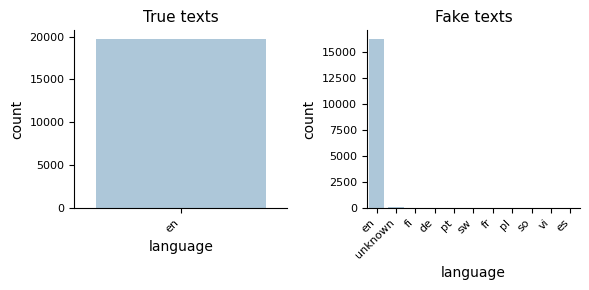

In [288]:
fig, axes = plt.subplots(1, 2, figsize=(6, 3))
axes = axes.ravel()

for i, status in enumerate(['True', 'Fake']):
    sns.countplot(
        data=all_information.loc[all_information['status']==status],
        x='language',
        ax=axes[i]
    )
    axes[i].set_title(f'{status} texts')
    axes[i].set_xticklabels(axes[i].get_xticklabels(), rotation=45, ha='right')

plt.tight_layout()

*Comments:*
* All true texts are in English. For fake texts, some of them are in other languages.

In [289]:
display(all_information.loc[all_information['language']=='pt'].head(10))
display(all_information.loc[all_information['language']=='sw'].head(2))

,title,text,subject,date,status,text_word_count,title_word_count,text_caps_count,title_caps_count,text_caps_words,...,url_links_title,special_chars_title,numbers_title,emotions_title,hashes_title,special_chars_combination,special_chars_combination_title,ttr_text,ttr_title,language
11829,WATCH! Anti-Trump Hag Gets Kicked Off Flight A...,Via: GATEWAY PUNDIT,politics,NaT,Fake,3,13,2,2,"[GATEWAY, PUNDIT]",...,0,6,0,0,0,"(0, 0, 1, 0, 0, 0)","(0, 0, 1, 0, 0, 0)",1.0,0.941176,pt


,title,text,subject,date,status,text_word_count,title_word_count,text_caps_count,title_caps_count,text_caps_words,...,url_links_title,special_chars_title,numbers_title,emotions_title,hashes_title,special_chars_combination,special_chars_combination_title,ttr_text,ttr_title,language
11847,BREAKING: PRESIDENT TRUMP Signs Most Important...,Via: NPR,politics,NaT,Fake,2,12,1,3,[NPR],...,0,3,0,0,0,"(0, 0, 1, 0, 0, 0)","(0, 0, 1, 0, 0, 0)",1.0,1.0,sw
11978,"DELUSIONAL DEMOCRATS Get A Reality Check: “No,...",Via: MRCTV,politics,NaT,Fake,2,13,1,3,[MRCTV],...,0,7,0,0,0,"(0, 0, 1, 0, 0, 0)","(0, 0, 1, 0, 0, 0)",1.0,1.0,sw


*Comments:*
* Texts that were identified to be non-English, are either very short, or only contain links. For these reasons, they were incorrectly identified.

### <a id='toc1_6_12_'></a>[Part-of-speech tagging](#toc0_)

Parts of speech - nouns, verbs, adjectives and others are assigned to words. This helps to analyze stylistic and structural differences between the fake and true texts.

In [291]:
text_tags = all_information['text'].apply(cf.get_tag_counts)
text_tags_series = pd.Series(text_tags)
text_tags_df = pd.DataFrame(text_tags_series.tolist())

In [314]:
cols_to_remove = []

for col in text_tags_df.columns:
    if text_tags_df[col].isna().sum() / text_tags_df[col].shape[0] * 100 > 70:
        cols_to_remove.append(col)

In [315]:
text_tags_df.drop(cols_to_remove, axis=1, inplace=True)

In [316]:
text_tags_df.head()

,:,DT,NN,IN,JJ,NNP,",",WP,VBD,TO,...,PRP$,(,),VBZ,RP,JJS,JJR,EX,RBR,status
0,5.0,69.0,122.0,94.0,64.0,98.0,54.0,4.0,28.0,30.0,...,5.0,1.0,1.0,12.0,1.0,2.0,3.0,NaN,NaN,True
1,4.0,66.0,98.0,70.0,42.0,88.0,29.0,1.0,30.0,29.0,...,5.0,NaN,NaN,15.0,2.0,NaN,1.0,1.0,NaN,True
2,1.0,48.0,72.0,64.0,27.0,86.0,19.0,1.0,30.0,10.0,...,5.0,1.0,1.0,10.0,2.0,NaN,1.0,NaN,NaN,True
3,1.0,37.0,53.0,45.0,28.0,80.0,23.0,1.0,31.0,10.0,...,5.0,NaN,NaN,10.0,2.0,NaN,NaN,1.0,NaN,True
4,1.0,86.0,145.0,111.0,63.0,123.0,50.0,1.0,27.0,21.0,...,17.0,5.0,5.0,41.0,2.0,2.0,3.0,NaN,1.0,True


In [322]:
groups = {}
group_names = text_tags_df.status.unique()
for group in group_names:
    groups[group] = text_tags_df.loc[text_tags_df['status']==group]

In [326]:
group_comparisons = {}
for col in text_tags_df.columns[:-2]:
    group1 = groups['Fake'][col].dropna()
    group2 = groups['True'][col].dropna()
    group_comparisons[col] = cf.compare_groups(group1, group2, alpha=0.05)

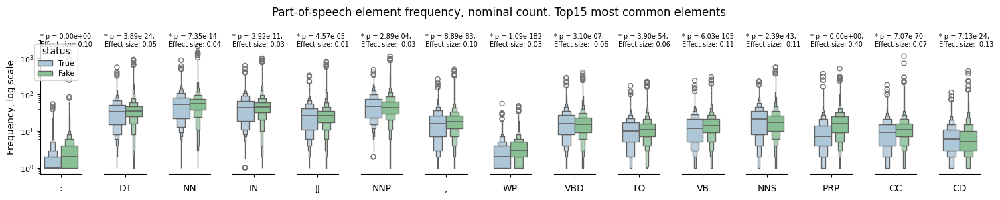

In [327]:
fig, axes = plt.subplots(1, 15, figsize=(15, 3), sharey=True)
axes = axes.ravel()

for i, col in enumerate(text_tags_df.columns[0:15]):
    sns.boxenplot(
        data=text_tags_df,
        y=col,
        hue='status',
        ax=axes[i]
    )
    axes[i].set_xlabel(col)
    axes[i].set_yscale('log')
    axes[i].set_ylabel('Frequency, log scale')
    if group_comparisons[col]['conclusion']=='Significant':
        p_value = group_comparisons[col]['p_value']
        delta = group_comparisons[col]['cliffs_delta']
        axes[i].text(
            -0.50, 2000,
            f'* p = {p_value:.2e}, \nEffect size: {delta:.2f}',
            size=7)

for a in axes[1:]:
    a.spines['left'].set_visible(False)
    a.tick_params(axis='y', which='both', left=False)
    a.legend('', frameon=False)
    a.set_ylabel('')

plt.suptitle('Part-of-speech element frequency, nominal count. '
             'Top15 most common elements')
plt.tight_layout()


*Comments:*
* All part-of-speech elements show similar but significantly different distributions of frequencies. Effect sizes are small.
* Typically, fake texts show a little wider IQR range of element frequencies compared to true texts.

In [328]:
text_tags_df['count_sum'] = text_tags_df.iloc[:, 0:-2].sum(axis=1)

In [329]:
text_tags_df_normalized = pd.DataFrame()
text_tags_df_normalized['count_sum'] = text_tags_df['count_sum']

In [330]:
text_tags_df['status'].dtype

dtype('O')

In [331]:
for col in text_tags_df.columns:
    if pd.api.types.is_numeric_dtype(text_tags_df[col]):
        text_tags_df_normalized[col] = (
            text_tags_df[col] / text_tags_df['count_sum']
        )

In [332]:
text_tags_df_normalized['status'] = text_tags_df['status']

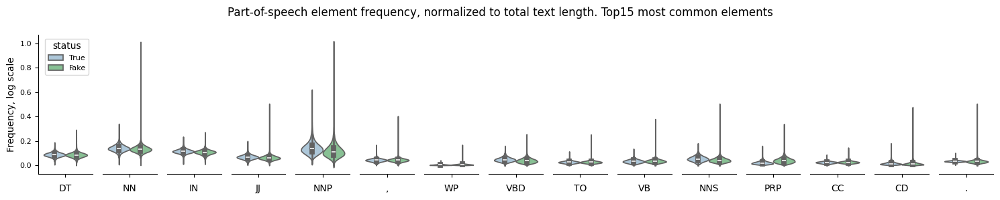

In [333]:
fig, axes = plt.subplots(1, 15, figsize=(15, 3), sharey=True)
axes = axes.ravel()

for i, col in enumerate(text_tags_df.columns[1:16]):
    sns.violinplot(
        data=text_tags_df_normalized,
        y=col,
        hue='status',
        ax=axes[i]
    )
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Frequency, log scale')

for a in axes[1:]:
    a.spines['left'].set_visible(False)
    a.tick_params(axis='y', which='both', left=False)
    a.legend('', frameon=False)
    a.set_ylabel('')

plt.suptitle('Part-of-speech element frequency, normalized to total text '
             'length. Top15 most common elements')
plt.tight_layout()


*Comments:*
* Normalized element frequency is similar for both true and fake texts. 

### <a id='toc1_6_13_'></a>[Sentiment and Emotional Analysis](#toc0_)

Use pre-trained sentiment analysis models like TextBlob, VADER to analyze the sentiment distribution.
Identify emotions like joy, anger, sadness and fear using tools like NRC Lexicon

**Sentiment analysis using pre-trained TextBlob**


In [335]:
polarity_subjectivity = all_information['text'].apply(cf.get_text_sentiment)

In [336]:
subjectivity_collection = []
polarity_collection = []
for polarity, subjectivity in polarity_subjectivity:
    polarity_collection.append(polarity)
    subjectivity_collection.append(subjectivity)

all_information['polarity'] = polarity_collection
all_information['subjectivity'] = subjectivity_collection

In [339]:
groups = {}
group_names = all_information.status.unique()
for group in group_names:
    groups[group] = all_information.loc[all_information['status']==group]

cols_to_plot = ['polarity', 'subjectivity']

group_comparisons = {}
for col in cols_to_plot:
    group1 = groups['Fake'][col].dropna()
    group2 = groups['True'][col].dropna()
    group_comparisons[col] = cf.compare_groups(group1, group2, alpha=0.05)

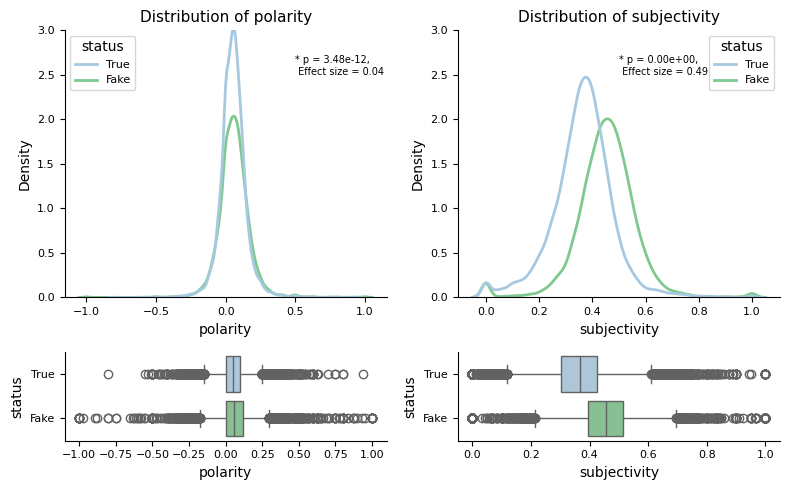

In [340]:
fig, axes = plt.subplots(
    2, 2, figsize=(8, 5),
    gridspec_kw={'height_ratios': (3,1)})

axes = axes.ravel()

for i, col in enumerate(cols_to_plot):

    sns.kdeplot(
        data=all_information,
        x=col,
        hue='status',
        ax=axes[i]
    )
    axes[i].set_title(f'Distribution of {col}')
    axes[i].set_ylim(0, 3)
    if group_comparisons[col]['conclusion']=='Significant':
        p_value = group_comparisons[col]['p_value']
        delta = group_comparisons[col]['cliffs_delta']
        axes[i].text(
            0.50, 2.5,
            f"* p = {p_value:.2e}, \n Effect size = {delta:.2f}",
            size=7)

    sns.boxplot(
        data=all_information,
        y='status',
        x=col,
        ax=axes[i+2],
        hue='status'
    )


plt.tight_layout()

*Comments:*
* `Polarity` - measures the positivity or negativity of the text (-1 for negative, 1 for positive). Both fake and true texts show similar, slightly positive polarity. Effect size is small.
* `Subjectivity` - measures how subjective or objective the text is based on pre-trained texts (1 for subjective, 0 for objective). Fake texts show higher subjectivity compared to true texts.

### <a id='toc1_6_14_'></a>[Emotions in text](#toc0_)

Emotions, such as anger, joy, sadness, fear and others. To analyze emotions, NRC Emotion Lexicon is used. Lexicon is available [here](https://saifmohammad.com/WebPages/NRC-Emotion-Lexicon.htm).

In [341]:
nrc_lex = pd.read_csv(
    os.path.join(project_dir, 'NRC-Emotion-Lexicon-Wordlevel-v0.92.txt'),
    names=['word', 'emotion', 'association'],
    sep='\t')
nrc_lex = nrc_lex[nrc_lex['association']==1]

In [343]:
text_emotions = all_information['text'].apply(cf.get_text_emotions)

In [354]:
text_emotions['status'] = all_information['status']

In [358]:
groups = {}
group_names = text_emotions.status.unique()
for group in group_names:
    groups[group] = text_emotions.loc[text_emotions['status']==group]

group_comparisons = {}
for col in text_emotions.columns[:-1]:
    group1 = groups['Fake'][col].dropna()
    group2 = groups['True'][col].dropna()
    group_comparisons[col] = cf.compare_groups(group1, group2, alpha=0.05)

In [356]:
text_emotions.reset_index(drop=True, inplace=True)

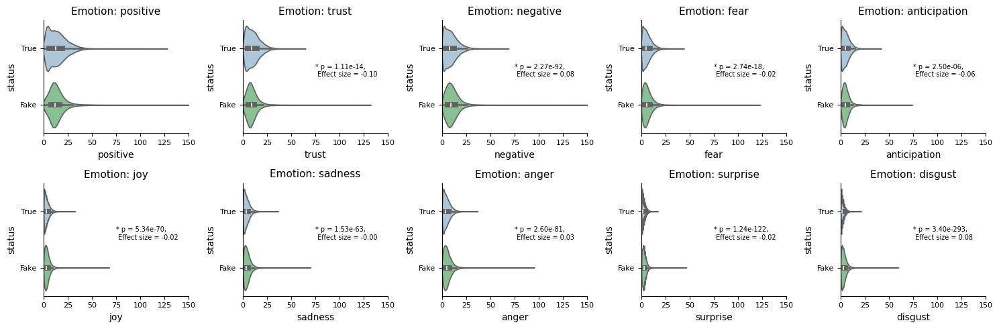

In [359]:
fig, axes = plt.subplots(2, 5, figsize=(15, 5))
axes = axes.ravel()

for i, emotion in enumerate(text_emotions.columns[:-1]):
    sns.violinplot(
        data=text_emotions,
        y='status',
        x=emotion,
        hue='status',
        ax=axes[i]
    )
    axes[i].set_title(f'Emotion: {emotion}')
    axes[i].set_xlim(0, 150)

    if group_comparisons[emotion]['conclusion']=='Significant':
        p_value = group_comparisons[emotion]['p_value']
        delta = group_comparisons[emotion]['cliffs_delta']
        axes[i].text(
            75, 0.5,
            f"* p = {p_value:.2e}, \n Effect size = {delta:.2f}",
            size=7)

plt.tight_layout()

*Comments:*
* Visually fake and true texts show similar emotion scores. However, differences are significant as identified by Mann-Whitney U-test. In all cases, effect sizes are small.

### <a id='toc1_6_15_'></a>[Semantic Analysis](#toc0_)

Clustering texts based on semanting similarity. To visualize results UMAP will be used.

**Text embeddings and their clusterization**


Visualization of text embeddings by using dimensionality reduction techniques can help identify text groups showing similarity. It can both help identify possible outliers and find associations between text status and different parameters.

In [361]:
tokenizer = AutoTokenizer.from_pretrained('bert-base-cased')
model = AutoModel.from_pretrained('bert-base-cased')
model = model.to(DEVICE)

In [370]:
SAMPLE_SIZE = 5000

all_texts = all_information['text'].dropna()
all_texts = all_texts.reset_index(drop=True)
text_sample = all_texts.sample(SAMPLE_SIZE, random_state=RANDOM_SEED)
text_sample_list = text_sample.tolist()

dataloader = DataLoader(text_sample_list, batch_size=BATCH_SIZE, shuffle=False)

embeddings = []

for batch in tqdm(dataloader, desc="Generating Embeddings"):
    embeddings.append(cf.get_text_embeddings(batch, tokenizer, model))

embeddings = torch.cat(embeddings, dim=0)

Generating Embeddings: 100%|██████████| 625/625 [09:28<00:00,  1.10it/s]


In [371]:
embeddings_normalized = normalize(embeddings.cpu().numpy())

In [372]:
umapper = umap.UMAP(
    n_neighbors=10,
    n_components=2,
    random_state=1)

embeddings_umap = umapper.fit_transform(embeddings_normalized)
embeddings_umap_df = pd.DataFrame(embeddings_umap, columns=['umap1', 'umap2'])

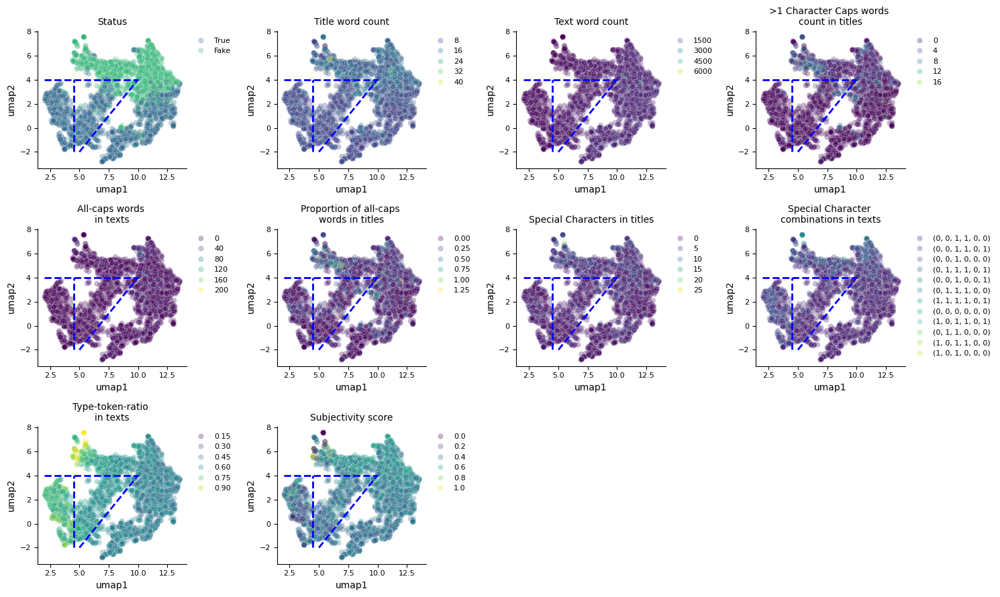

In [425]:
fig, axes = plt.subplots(3, 4, figsize=(15, 9))
axes = axes.ravel()

cols_to_plot = [
    'status',
    'title_word_count',
    'text_word_count',
    'title_caps_words_longer',
    'text_caps_recounted',
    'title_caps_proportion',
    'special_chars_title', 
    'special_chars_combination',
    'ttr_text',
    'subjectivity',
]
plot_titles = [
    'Status',
    'Title word count',
    'Text word count',
    '>1 Character Caps words \ncount in titles',
    'All-caps words \nin texts',
    'Proportion of all-caps \nwords in titles',
    'Special Characters in titles',
    'Special Character \ncombinations in texts',
    'Type-token-ratio \nin texts',
    'Subjectivity score',    
]

custom_lines = dict(
    x1 = [5, 10],
    y1 = [-2, 4],
    x2 = [2, 10],
    y2 = [4, 4],
    x3 = [4.5, 4.5],
    y3 = [-2, 4],
)


for i, col in enumerate(cols_to_plot):
    all_information.reset_index(drop=True, inplace=True)
    col_info = all_information.iloc[text_sample.index, ][col]

    sns.scatterplot(
        data=embeddings_umap_df,
        x='umap1',
        y='umap2',
        hue=col_info,
        alpha=0.3,
        ax=axes[i],
        palette='viridis'
    )
    axes[i].legend(bbox_to_anchor=(1, 1, 0, 0), frameon=False)
    axes[i].set_title(plot_titles[i], size=10)

    axes[i].plot(
        custom_lines['x1'],
        custom_lines['y1'],
        color='blue',
        linestyle='--')
    
    axes[i].plot(
        custom_lines['x2'],
        custom_lines['y2'],
        color='blue',
        linestyle='--')
    
    axes[i].plot(
        custom_lines['x3'],
        custom_lines['y3'],
        color='blue',
        linestyle='--')

for a in range(-2, 0):
    fig.delaxes(axes[a])
plt.tight_layout()

*Comments:*
* Graphs show some of the parameters that had some stronger association between article type or status. 
* `Status` - Fake and true texts quite well separate into groups. There are 3 distinct True text groups that are indicated by blue dotted lines. 
* `Title word count` - higher number of words is an indication of fake text. That can be observed in the plot.
* `Text word count` - true and fake texts cannot be differentiated from this plot. Differences between groups are small.
* `Caps words count in titles` - there are more fake texts with higher number of caps words in titles.
* `All-caps words in texts` - differences are small and not seen in the graph.
* `Proportion of all-caps words in titles` - a slightly higher number of fake texts show higher proportion of all-caps words in titles.
* `Special characters in titles` - some special character combinations dominate in fake texts - 1) URL links with special characters, numbers and hashes; 2) URL links with special characters and numbers; 3)URL links and special characters.
* `Type-token-ratio` - both groups show texts with higher and lower type-token ratio. Plot does not help to identify new patterns. However, True texts can be separated by this type-token-ratio in groups that are separated by blue dotted lines.
* `Subjectivity score` - subjectivity score is a little higher on average in fake texts.

**True text group analysis**

There are 3 identified true text groups that differ by type-token-ratio. 

In [426]:
group1_idxs = text_sample.loc[
    (embeddings_umap_df['umap1']<=4.5) & (embeddings_umap_df['umap2']<=4)].index

group2_idxs = text_sample.loc[
    (embeddings_umap_df['umap1']>4.5) & 
    (embeddings_umap_df['umap1']<=7.5) &
    (embeddings_umap_df['umap2']<=4) &
    (embeddings_umap_df['umap2']>-2)
    ].index

group3_idxs = text_sample.loc[
    (embeddings_umap_df['umap1']>7.5) & 
    (embeddings_umap_df['umap2']<=4) &
    (embeddings_umap_df['umap2']>-2)
    ].index

In [ ]:
groups = {
    'group1': group1_idxs,
    'group2': group2_idxs,
    'group3': group3_idxs
} 
for group_name, indexes in groups.items():
    all_information.loc[indexes, 'group_name'] = group_name
true_data_groups = all_information.loc[all_information['group_name'].notna()]

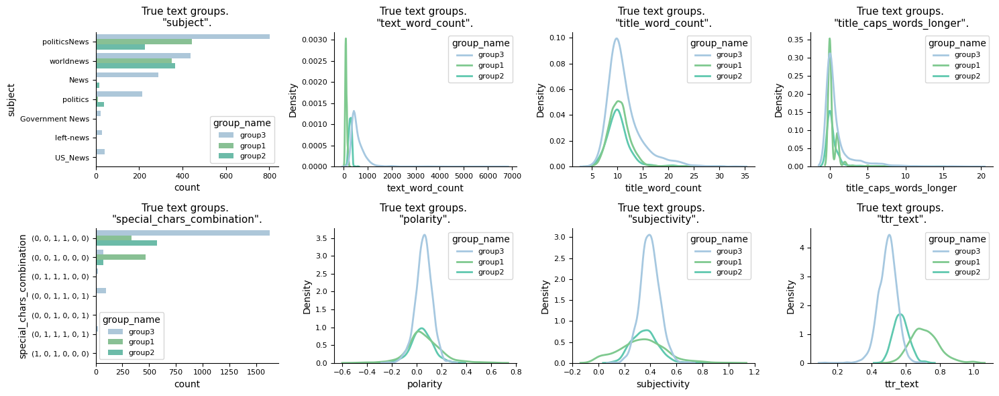

In [441]:
fig, axes = plt.subplots(2, 4, figsize=(15, 6))
axes = axes.ravel()

data = true_data_groups
cols_to_plot = [
    'subject',
    'text_word_count',
    'title_word_count',
    'title_caps_words_longer',
    'special_chars_combination',
    'polarity', 'subjectivity',
    'ttr_text',
]

for i, col in enumerate(cols_to_plot):
    if data[col].dtype == 'O':
        sns.countplot(
            data=data,
            y=col,
            ax=axes[i],
            hue='group_name'
        )
    else:
        sns.kdeplot(
            data=data,
            x=col,
            ax=axes[i],
            hue='group_name'
        )
    axes[i].set_title(f'True text groups. \n"{col}".')

plt.tight_layout()

*Comments:*
* True texts can be separated into groups based on several parameters observed above:
    * Text word count - group1 - indicates shortest texts, followed by group2 and group 3. 
    * Special characters combination: group1 shows highest proportion of combinations `special_chars` and `special_chars` together with `numbers`. Combinations are represented by `html_tags`, `url_links`, `special_chars`, `numbers`, `emotions`, `hashes`. Group2 is mostly represented by combination `special_chars` and group3 is represented by 3 combinations: mostly `special_chars` together with `numbers`, `special_chars` and `special_chars` together with `numbers` and `hashes`.
    * Subjectivity - group3 shows the narrowest range of subjectivity values, while group1 shows the widest.
    * Type-token-ratio - group3 shows the lowest ratio, followed by group2 and group1. These values are expected, since groups have different average text length.

---
* Group1: shortest texts, wide range of subjectivity scores, dominating characters - special_chars and numbers.
* Group2: longer texts than group1, a little narrower range of subjectivity scores, dominating characters - special chars and numbers.
* Group3: longest texts, narrowest subjectivity scores, dominated by special chars, and numbers, less frequently - hashes.

### <a id='toc1_6_16_'></a>[Noise and Outlier Detection](#toc0_)

For outlier detection, several methods will be applied: DBSCAN with PCA, UMAP and cosine similarity to find texts that show unusual similarities. Next, unusually short and long texts, texts with high special character frequencies will be reviewed. 


Extremely long or short texts, texts with high proportions of special characters or numbers.
Mislabeling, nonsensical text or irrelevant entries.

**PCA, UMAP and DBSCAN outlier identification**

In [4]:
all_information = pd.read_csv(
    os.path.join(data_dir, 'combined_dataset4.csv'))
all_information.status = all_information.status.astype(str)

C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\2132941297.py:1: DtypeWarning: Columns (4,5) have mixed types. Specify dtype option on import or set low_memory=False.
  all_information = pd.read_csv(


In [5]:
for col in all_information.columns:
    if all_information[col].dtype == 'int64':
        all_information[col] = all_information[col].astype('int32')
    if all_information[col].dtype == 'float64':
        all_information[col] = all_information[col].astype('float32')

In [6]:
true_texts = all_information[all_information['status']=='True']['text']
fake_texts = all_information[all_information['status']=='Fake']['text']
text_statuses = ['True', 'Fake']

outliers_in_groups = {}
similarity_matrices = {}
reduced_data = {}

similarity_matrices[text_statuses[0]] = {}
outliers_in_groups[text_statuses[0]] = {}
reduced_data[text_statuses[0]] = {}

In [11]:
print(f'Calculating similarity matrix {text_statuses[0]}')
sim_matrix = cf.get_similarity_matrix(true_texts)
print('Vectorizing matrix')
vectorized_matrix = cf.get_vectorized_matrix(true_texts)
print(vectorized_matrix.shape)
print('Getting dbscan outliers')
outliers_dbscan = cf.get_dbscan_outliers(sim_matrix)
outliers_in_groups[text_statuses[0]]['outliers_dbscan'] = outliers_dbscan
sim_matrix = 0
print('Applying PCA')
outliers_pca, pca_reduced = cf.get_pca_outliers(vectorized_matrix)
outliers_in_groups[text_statuses[0]]['outliers_pca'] = outliers_pca
print('Applying UMAP')
outliers_umap, umap_reduced = cf.get_umap_outliers(vectorized_matrix)
outliers_in_groups[text_statuses[0]]['outliers_umap'] = outliers_umap
vectorized_matrix = 0
    
reduced_data[text_statuses[0]]['pca'] = pca_reduced
reduced_data[text_statuses[0]]['umap'] = umap_reduced

pca_reduced = 0
umap_reduced = 0

Calculating similarity matrix True
Vectorizing matrix
(21060, 66530)
Getting dbscan outliers
Applying PCA
Applying UMAP


In [12]:
similarity_matrices[text_statuses[1]] = {}
outliers_in_groups[text_statuses[1]] = {}
reduced_data[text_statuses[1]] = {}

In [ ]:
print(f'Calculating similarity matrix {text_statuses[1]}')
sim_matrix = cf.get_similarity_matrix(fake_texts)
print('Vectorizing matrix')
vectorized_matrix = cf.get_vectorized_matrix(fake_texts)
vectorized_matrix = vectorized_matrix.astype('float32')
print(vectorized_matrix.shape)
print('Getting dbscan outliers')
outliers_dbscan = cf.get_dbscan_outliers(sim_matrix)
outliers_in_groups[text_statuses[1]]['outliers_dbscan'] = outliers_dbscan
sim_matrix = 0
print('Applying PCA')
outliers_pca, pca_reduced = cf.get_pca_outliers(vectorized_matrix)
outliers_in_groups[text_statuses[1]]['outliers_pca'] = outliers_pca
outliers_pca = 0
print('Applying UMAP')
outliers_umap, umap_reduced = cf.get_umap_outliers(vectorized_matrix)
outliers_in_groups[text_statuses[1]]['outliers_umap'] = outliers_umap
vectorized_matrix = 0
outliers_umap = 0

reduced_data[text_statuses[1]]['pca'] = pca_reduced
reduced_data[text_statuses[1]]['umap'] = umap_reduced

Calculating similarity matrix Fake
Vectorizing matrix
(17462, 94451)
Getting dbscan outliers
Applying PCA
Applying UMAP


In [16]:
for text_group, reduced_dicts in reduced_data.items():
    for reducer, data in reduced_dicts.items():
        reduced_data[text_group][reducer] = pd.DataFrame(
            reduced_data[text_group][reducer],
            columns=['Component1', 'Component2']
        )

In [25]:
distances = np.linalg.norm(reduced_data['True']['pca'], axis=1)
outliers = np.where(distances > 0.5)[0]
outliers_in_groups['True']['outliers_pca'] = outliers

In [23]:
len(outliers_in_groups['Fake']['outliers_umap'])

282

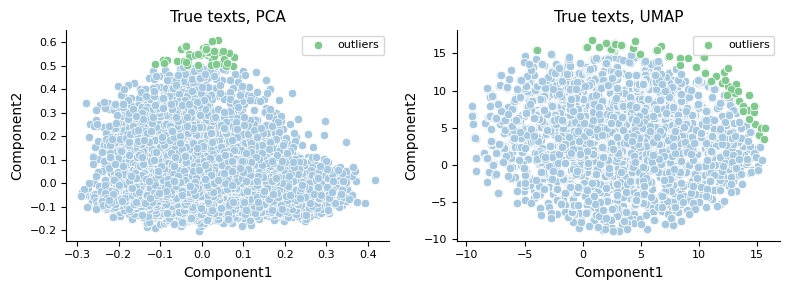

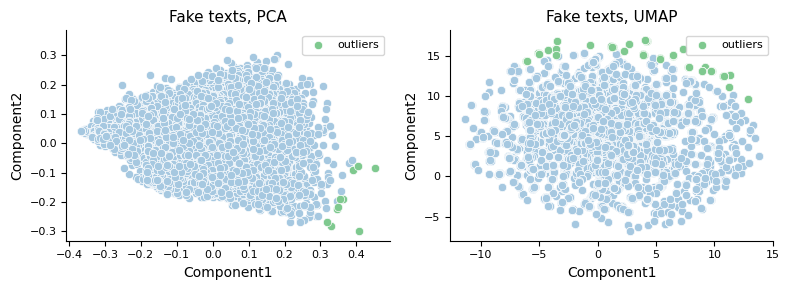

In [26]:
for text_group, reduced_data_dict in reduced_data.items():
    fig, axes = plt.subplots(1, 2, figsize=(8, 3))
    axes = axes.ravel()
    for i, reducer in enumerate(reduced_data_dict.keys()):
        outliers = outliers_in_groups[text_group][f'outliers_{reducer}']
        outlier_df = reduced_data_dict[reducer].iloc[outliers, :]
        sns.scatterplot(
            data=reduced_data_dict[reducer],
            x='Component1',
            y='Component2',
            ax=axes[i]
        )
        sns.scatterplot(
            data = outlier_df,
            x='Component1',
            y='Component2',
            palette='ReBu',
            ax=axes[i],
            label='outliers'
        )
        axes[i].set_title(f'{text_group} texts, {reducer.upper()}')
    plt.tight_layout()

*Comments:*
* `PCA` - method identifies some possible outliers. However, both true and fake text data seem to have a quite uniform distribution. Possible outlier texts will be reviewed manually.
* `UMAP` - method show similar results to PCA. Some texts are further from the others and are identified as outliers.

* No outliers were identified using DBSCAN.

**Manual review of possible outliers**

PCA and UMAP have identified some possible outliers. They will be reviewed manually.

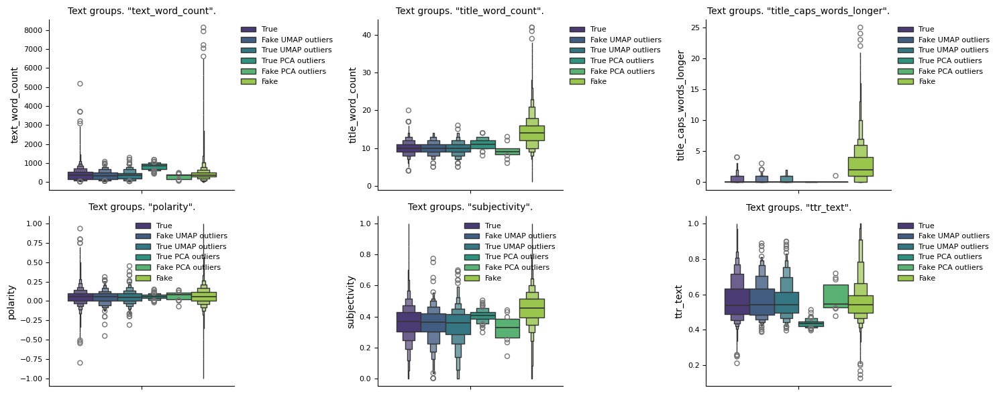

In [27]:
data = all_information.copy()

data.iloc[outliers_in_groups['True']['outliers_umap'], 5] = \
    'True UMAP outliers'
data.iloc[outliers_in_groups['Fake']['outliers_umap'], 5] = \
    'Fake UMAP outliers'
data.iloc[outliers_in_groups['True']['outliers_pca'], 5] = \
    'True PCA outliers'
data.iloc[outliers_in_groups['Fake']['outliers_pca'], 5] = \
    'Fake PCA outliers'

cols_to_plot = [
    'text_word_count',
    'title_word_count',
    'title_caps_words_longer',
    'polarity', 'subjectivity',
    'ttr_text',
]
fig, axes = plt.subplots(2, 3, figsize=(15, 6),)
axes = axes.ravel()

for i, col in enumerate(cols_to_plot):

    if data[col].dtype == 'O':
        sns.countplot(
            data=data,
            y=col,
            ax=axes[i],
            hue='status',
            palette='viridis'
        )
    else:
        sns.boxenplot(
            data=data,
            y=col,
            ax=axes[i],
            hue='status',
            palette='viridis'
        )
    axes[i].legend(frameon=False, bbox_to_anchor=(1, 1, 0, 0))
    axes[i].set_title(f'Text groups. "{col}".', size=10)
plt.tight_layout()


*Comments:*
* Graphs show some of the parameter values in all fake/true texts and texts that have been identified as possible outliers by PCA and UMAP. 
* `True` texts:
    * `text_word_count` - texts identified as outliers by PCA are significantly longer than those identified by UMAP and all true text distribution.
    * `title_word_count` - texts identified as outliers by PCA show a liitle longer titles on average.
    * `title_caps_words` - PCA identified outlier texts have fewer all-caps words in titles.
    * `polarity` - PCA identified texts have narrower polarity range
    * `subjectivity` - PCA identified outliers have narrower subjectivity range and higher median subjectivity value.
    * `type-token-ratio` - significantly lower in PCA identified outliers.

* `Fake` texts:
    * `text_word_count` - PCA identified outliers show wide range of text_word_count, with higher numbers of very long texts.
    * `title_word_count` - Similar title word count in both outlier groups.
    * `title_caps_words` - UMAP identified outliers show a little lower median all-caps words count in titles.
    * `polarity` - PCA identified texts are a little more negative.
    * `subjectivity` - PCA identified outliers are a little less subjective.
    * `type-token-ratio` - PCA identified outliers show wide range of type-token-ratio values, with very high median value.


Texts identified as outliers by UMAP, do not show as significant difference to general true/fake text populations as PCA texts. PCA identified texs show significantly different type-token-ratio, subjectivity and text word count in both true and fake text groups. These identified outliers will be read and deleted.

In [28]:
for text in data[data['status'] == 'True PCA outliers'].sample(20)['text']:
    print(text)

UNITED NATIONS/SEOUL  - The U.N. Security Council unanimously imposed new sanctions on North Korea on Friday for its recent intercontinental ballistic missile test, seeking to limit its access to refined petroleum products and crude oil and its earnings from workers abroad. The U.N. resolution seeks to ban nearly 90 percent of refined petroleum exports to North Korea by capping them at 500,000 barrels a year and, in a last-minute change, demands the repatriation of North Koreans working abroad within 24 months, instead of 12 months as first proposed. The U.S.-drafted resolution also caps crude oil supplies to North Korea at 4 million barrels a year and commits the Council to further reductions if it were to conduct another nuclear test or launch another ICBM. North Korea on Nov. 29 said it successfully tested a new ICBM that put the U.S. mainland within range of its nuclear weapons. Tension has been rising over North Korea s nuclear and missile programs, which it pursues in defiance of

*Comments:*
* True text outliers - some of the text in the example above show similarity to fake texts - use of attention or strong language words such as: 'mocked', 'threat', 'overwhelming' and others. However, the contents of these texts do not seem to be fake. 

In [29]:
for text in data[data['status'] == 'Fake PCA outliers'].sample(10)['text']:
    print(text)


KAMPALA  - The Ugandan army on Friday attacked rebel camps in eastern Congo, an army spokesman said. The attack followed intelligence sharing with the Democratic Republic of the Congo, spokesman Richard Karemire told Reuters.    So in a pre-emptive move this afternoon, UPDF conducted attacks, they are of a limited nature on camps in DRC,  he said.
- The United States is calling on all sides in Yemen to re-energize political talks to end the country s civil war, a Trump administration official said on Monday, after former President Ali Abdullah Saleh was killed in a roadside attack. Analysts said Saleh s death would be a huge morale boost for the Iran-aligned Houthis, since Saleh had switched sides by abandoning the Houthis in favor of a Saudi-led coalition. The U.S. official, who spoke on condition of anonymity, added that Houthi claims on Sunday they launched a missile at Abu Dhabi demonstrated  how destabilizing this war is for the region and how the Iranian regime is exploiting the 

*Comments:*
* Fake text outliers - 3 of the 10 examples are texts containing only a URL link. 3 other texts identified as outliers are very short texts. 

**Global outlier detection**

Previously, outlier texts were analyzed in separate text groups. It is used to find extremely differing texts withing a text group. However, there could also be global outliers - for example texts, that have completely different topics than fake and true texts. Therefore, such texts would look different to both text groups. Similar methods - UMAP, PCA and DBSCAN will be applied here.

In [30]:
for col in all_information.columns:
    if all_information[col].dtype == 'float64':
        all_information[col] = all_information[col].astype('float32')
    elif all_information[col].dtype == 'int64':
        all_information[col] = all_information[col].astype('int32')
    else:
        pass

In [ ]:
all_texts = all_information['text']

print(f'Calculating similarity matrix')
all_sim_matrix = cf.get_similarity_matrix(all_texts)
all_sim_matrix = all_sim_matrix.astype('float32')
print(all_sim_matrix.shape)
print('Getting dbscan outliers')
all_outliers_dbscan = cf.get_dbscan_outliers(all_sim_matrix)
all_sim_matrix = 0


print('Vectorizing matrix')
all_vectorized_matrix = cf.get_vectorized_matrix(all_texts)
all_vectorized_matrix = all_vectorized_matrix.astype('float32')
print(all_vectorized_matrix.shape)
print('Applying PCA')
all_outliers_pca, all_pca_reduced = cf.get_pca_outliers(
    all_vectorized_matrix, threshold=0.3)

Applying PCA


In [88]:
import umap
from sklearn.decomposition import TruncatedSVD

In [55]:
svd = TruncatedSVD(n_components=300)
reduced_matrix = svd.fit_transform(all_vectorized_matrix)

In [57]:
umap_reducer = umap.UMAP(
    n_neighbors=200,
    min_dist=0.1,
    metric='cosine')
all_umap_reduced = umap_reducer.fit_transform(reduced_matrix)

In [58]:
distances = np.linalg.norm(all_umap_reduced, axis=1)
all_outliers_umap = np.where(distances > 10)[0]

In [63]:
display(len(all_outliers_dbscan))
display(len(all_outliers_pca))
display(len(all_outliers_umap))

0

342

1615

In [64]:
distances = np.linalg.norm(all_pca_reduced, axis=1)
outliers = np.where(distances > 0.35)[0]
all_outliers_pca = outliers

In [65]:
all_umap_reduced = pd.DataFrame(
    all_umap_reduced, columns=['Component1', 'Component2'])
all_pca_reduced = pd.DataFrame(
    all_pca_reduced, columns=['Component1', 'Component2'])

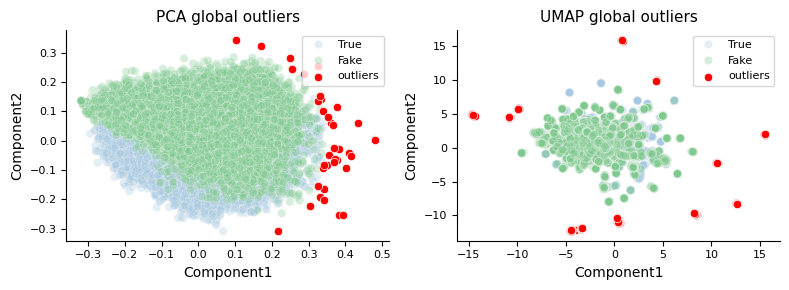

In [66]:
fig, axes = plt.subplots(1, 2, figsize=(8, 3))
axes = axes.ravel()

reduser_data = [all_pca_reduced, all_umap_reduced]
outliers_idxs = [all_outliers_pca, all_outliers_umap]
titles = ['PCA global outliers', 'UMAP global outliers']

for i, reducer in enumerate(reduser_data):
    outlier_df = reducer.iloc[outliers_idxs[i], :]
    sns.scatterplot(
        data=reducer,
        x='Component1',
        y='Component2',
        hue=all_information['status'],
        ax=axes[i],
        alpha=0.3
    )
    sns.scatterplot(
        data = outlier_df,
        x='Component1',
        y='Component2',
        ax=axes[i],
        color='red',
        label='outliers'
    )
    axes[i].set_title(titles[i])
plt.tight_layout()

*Comments:*
* Both PCA and UMAP identify some text examples that are further from the general population. To get a better idea, how these texts differ from other fake and true texts, they will be reviewed for some of the previously analyzed parameters.

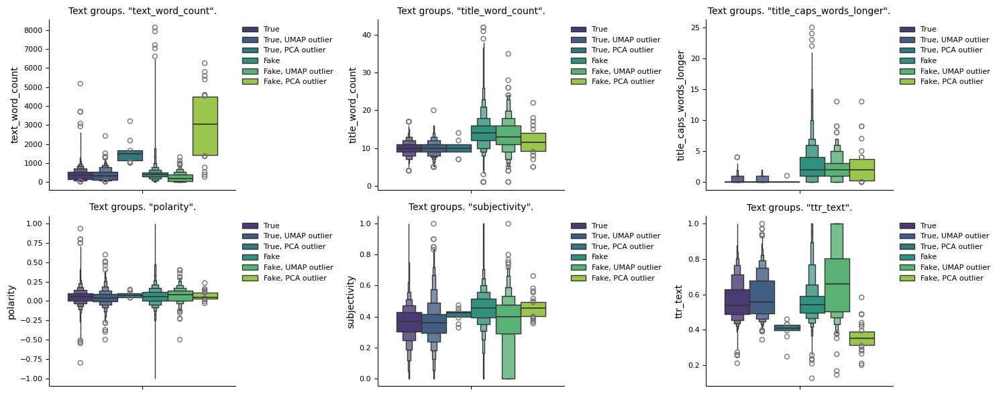

In [67]:
data = all_information.copy()

data.iloc[all_outliers_umap, 5] = (
    data.iloc[all_outliers_umap, 5]
    .replace({'True': 'True, UMAP outlier', 'Fake': 'Fake, UMAP outlier'})
)
data.iloc[all_outliers_pca, 5] = (
    data.iloc[all_outliers_pca, 5]
    .replace({'True': 'True, PCA outlier', 'Fake': 'Fake, PCA outlier'})
)

cols_to_plot = [
    'text_word_count',
    'title_word_count',
    'title_caps_words_longer',
    'polarity', 'subjectivity',
    'ttr_text',
]
fig, axes = plt.subplots(2, 3, figsize=(15, 6),)
axes = axes.ravel()

for i, col in enumerate(cols_to_plot):

    if data[col].dtype == 'O':
        sns.countplot(
            data=data,
            y=col,
            ax=axes[i],
            hue='status',
            palette='viridis'
        )
    else:
        sns.boxenplot(
            data=data,
            y=col,
            ax=axes[i],
            hue='status',
            palette='viridis'
        )
    axes[i].legend(frameon=False, bbox_to_anchor=(1, 1, 0, 0))
    axes[i].set_title(f'Text groups. "{col}".', size=10)
plt.tight_layout()


*Comments:*
* `True texts`:
    * `text-word-count` - PCA identified outliers show higher median text word count compared to all true texts. UMAP identified outliers do not show significant distribution differences.
    * `title-word-count` - PCA identified outliers show a little narrower range of title word count.
    * `title-caps-words` - most of PCA identified outliers do not contain all-caps words in titles.
    * `polarity` - PCA identified outliers show narrower range of polarity.
    * `subjectivity` - PCA identified outliers show narrower range of subjectivity.
    * `type-text-ratio` - Lower for PCA oultiers.

* `Fake texts`: 
    * `text-word-count` - Higher median count for PCA outliers, lower for UMAP outliers.
    * `title-word-count` - Lower for UMAP and PCA outliers.
    * `title-caps-words` - similar for PCA and UMAP outliers.
    * `polarity` - PCA identified outliers show narrower range of polarity.
    * `subjectivity` - UMAP identified outliers show wider range of subjectivity, with some of the values being extremely low.
    * `type-text-ratio` - Higher for UMAP outliers, lower for PCA outliers.

PCA outliers show higher differences, probably because of very small outlier number. However, in some occasions, UMAP outliers also show differences from general fake and true text distributions. Overall, it would probably be best to remove these outliers from the dataset, to have more uniform data.

**Outlier removal**

Outliers identified in groups of true/fake texts and globally, will be removed. 

In [145]:
outlier_set = set()

for text_group, outlier_method_values in outliers_in_groups.items():
    for outlier_method, values in outlier_method_values.items():
        outlier_set.update(values)

outlier_set.update(all_outliers_pca)
outlier_set.update(all_outliers_umap)

outlier_set = list(outlier_set)

In [146]:
len(outlier_set)

In [150]:
len(outlier_set) / all_information.shape[0] * 100

In [160]:
all_information = all_information.drop(index=outlier_set)

In [162]:
all_information.status.value_counts()

*Comments:*
* In total, 2201 texts have been identified as outliers and have been removed from the dataset. It makes up around 5.7 % of all data. After removal of outliers, true and fake texts make up similar numbers of rows.

In [164]:
all_information.drop('Unnamed: 0', axis=1, inplace=True)

In [ ]:
all_information.head(1)

### <a id='toc1_6_17_'></a>[Text cleaning](#toc0_)

In this project, pre-trained models like BERT will be used. BERT models are not very sensitive to punctuation and use of special characters. However, it is not completely clear whether cleaning the texts would benefit the model's performance. So my idea is to create two several pipelines addressing different problems:
    * Removing unnecessary characters like tags, links, spaces, punctuation etc.
    * Standardizing text - lowercasing, fixing spelling
    * Lemmatizing the text - converting the words to their base form (mice - mouse)
    * Missing values - inplacing, dropping
    * Replacing html/url with special tokens, because they are unique

*pipeline short*
* Cleaning the punctuation without removal
* Cleaning whitespaces
* Changing special tags with custom tokens

*pipeline long*
* Fixing misspelled words
* Lemmatization of words
* Cleaning punctuation without removal
* Cleaning whitespaces
* Changing special tags with custom tokens

*pipeline one*
* Removing named entities and proper nouns
* Removing all special characters, HTML tags, links etc.
* Removing all punctuation
* Cleaning whitespaces

*pipeline two*
* Lowercasing text
* Changing 't' to 'not'
* Removing @name
* Removing all punctuation except '?'
* Removing all other special characters, links, tags etc.
* Removing stopwords except 'not' and 'can'
* Cleaning whitespaces

*pipeline three*
* Lowercasing text
* Removing all special characters, HTML tags, links etc.
* Removing all punctuation except '?', '!', '.'
* Removing all stopwords
* Cleaning whitespaces

*pipeline four*
* Lowercasing text
* Removing all special characters, HTML tags, links etc.
* Removing all punctuation except '?', '!', '.'
* Removes repeated words in a text
* Cleaning whitespaces

*pipeline five*
* Removing named entities and proper nouns
* Lowercasing text
* Changing 't' to 'not'
* Removing all special characters, HTML tags, links etc.
* Removing all punctuation except '?', '!', '.'
* Removing stopwords except 'not' and 'can'
* Cleaning whitespaces

*pipeline six*
* Removing named entities and proper nouns
* Lowercasing text
* Changing 't' to 'not'
* Removing all special characters, HTML tags, links etc.
* Removing all punctuation except '?', '!', '.'
* Removes repeated words in a text
* Cleaning whitespaces

### <a id='toc1_6_18_'></a>[Train/validation/test data split](#toc0_)

In [71]:
texts_short_cleaned = pd.read_csv(os.path.join(data_dir, 'texts_short_cleaned.csv'))
texts_long_cleaned = pd.read_csv(os.path.join(data_dir, 'texts_long_cleaned.csv'))

In [77]:
all_information = pd.read_csv(os.path.join(data_dir, 'combined_dataset5.csv'))

C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\630138709.py:1: DtypeWarning: Columns (4,5) have mixed types. Specify dtype option on import or set low_memory=False.
  all_information = pd.read_csv(os.path.join(data_dir, 'combined_dataset5.csv'))


In [78]:
all_information['texts_short_cleaned'] = texts_short_cleaned['text']
all_information['texts_long_cleaned'] = texts_long_cleaned['text']

In [79]:
for col in all_information.columns:
    if all_information[col].dtype == 'int64':
        all_information[col] = all_information[col].astype('int32')
    if all_information[col].dtype == 'float64':
        all_information[col] = all_information[col].astype('float32')

In [80]:
all_information['status'] = all_information['status'].astype(str)

In [81]:
X_data = all_information.drop('status', axis=1)
y_data = all_information['status']

In [82]:
from sklearn.model_selection import train_test_split

* Split data, stratifying by status

In [83]:
X_train, X_vt, y_train, y_vt = train_test_split(
    X_data, y_data, 
    test_size=0.3,
    shuffle=True, 
    random_state=RANDOM_SEED,
    stratify=y_data
)

X_val, X_test, y_val, y_test = train_test_split(
    X_vt, y_vt,
    test_size=0.5,
    shuffle=True,
    random_state=RANDOM_SEED,
    stratify=y_vt
)

* Review combinations of statuses in each split

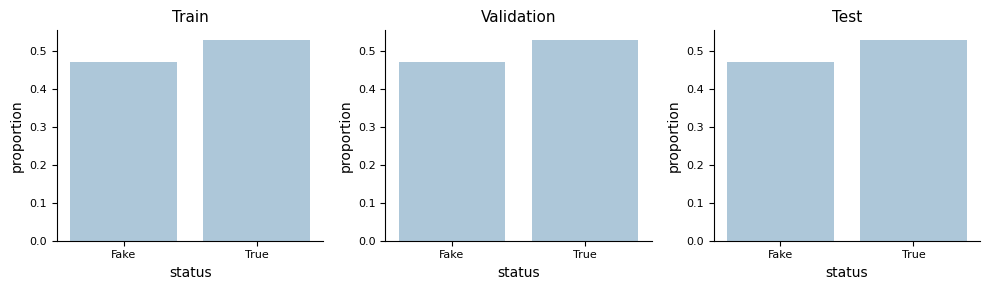

In [128]:
fig, axes = plt.subplots(1, 3, figsize=(10, 3))
axes = axes.ravel()

titles = ['Train', 'Validation', 'Test']

for i, split in enumerate([X_train, X_val, X_test]):
    sns.countplot(
        data=split,
        x='status',
        ax=axes[i],
        stat='proportion'
    )
    axes[i].set_title(titles[i])

plt.tight_layout()

*Comments:*
* Proportions in each split are equal.

## <a id='toc1_7_'></a>[Classification models](#toc0_)

### <a id='toc1_7_1_'></a>[Building a heuristic model](#toc0_)

Previously reviewed factors showed some association between true and fake texts. The most important parameters that showed significant difference between groups were:

* Title word count - higher word count was indication of fake article.
* Title all-caps words proportion - higher proportion indicated fake texts.
* Higher number of all-caps words in title was associated with fake texts.
* Attention words - it was very uncommon for true texts to have >2 attention words.
* Special character compositions - some compositions showed >10X higher probability in fake texts.
* Type-token-ratio - in range between ~0.65-0.85 there was higher probability text is between true texts.
* Stopwords - some usually found stopwords were more frequent between fake texts.
* Subjectivity - higher subjectivity value for fake texts.
* Text emotions - although not visually identifiable, showed differences between article groups.
* Special characters and numbers - higher numbers in fake article titles
* Polarity - although not visually identifiable, showed differences between article groups.

However, some of these parameters may be too adjusted for the particular dataset and could generalize badly on new data. Therefore, for classification task, only the following parameters, that have better generalization, will be used:
* title all-caps words proportion
* proportion of longer all-caps words in texts
* special character composition in title
* proportion of special characters and numbers in titles
* type-token ratio
* subjectivity 
* stopwords proportion to text length 
* text emotions 

To start building the model, I will review some possible parameter thresholds to classifty text. At each threshold, discrimination ratio will be calculated.

In [13]:
nrc_lex = pd.read_csv(
    os.path.join(project_dir, 'NRC-Emotion-Lexicon-Wordlevel-v0.92.txt'),
    names=['word', 'emotion', 'association'],
    sep='\t')
nrc_lex = nrc_lex[nrc_lex['association']==1]

In [84]:
heuristic_model_preprocessed_X_train = cf.calculate_text_title_features(X_train)
heuristic_model_preprocessed_X_val = cf.calculate_text_title_features(X_val)
heuristic_model_preprocessed_X_test = cf.calculate_text_title_features(X_test)

Calculating title caps proportion
Calculating text caps proportion
Calculating special characters in title
Calculating special characters combinations in title
Calculating special characters proportion in title
Calculating type-token ratio
Calculating text sentiment
Calculating text emotions
Calculating title caps proportion
Calculating text caps proportion
Calculating special characters in title
Calculating special characters combinations in title
Calculating special characters proportion in title
Calculating type-token ratio
Calculating text sentiment
Calculating text emotions
Calculating title caps proportion
Calculating text caps proportion
Calculating special characters in title
Calculating special characters combinations in title
Calculating special characters proportion in title
Calculating type-token ratio
Calculating text sentiment
Calculating text emotions


In [85]:
selected_parameters = [
    'special_chars_combination_title',

]
selected_parameters_float = [
    'title_caps_proportion',
    'text_caps_proportion',
    'title_special_chars_proportion',
    'title_numbers_proportion',
    'ttr_text',
    'ttr_title',
    'text_subjectivity',
    'text_polarity',
    'text_stopword_proportion',
    'negative', 'fear', 'sadness',
    'anger', 'positive', 'disgust',
    'trust', 'anticipation', 'surprise',
    'joy',
]

In [132]:
bins = {}
for col in selected_parameters_float:
    bins[col] = np.linspace(min(heuristic_model_preprocessed_X_train[col]),
                            max(heuristic_model_preprocessed_X_train[col]), 10)


In [86]:
heuristic_model_preprocessed_data = heuristic_model_preprocessed_X_train.copy()
heuristic_model_preprocessed_data['status'] = y_train

In [134]:
true_fake_frequencies = {}
for col in selected_parameters:
    true, fake = cf.get_column_true_fake(heuristic_model_preprocessed_data, col)
    true_fake_frequencies[col] = {}
    true_fake_frequencies[col]['true'] = cf.count_frequency(true)
    true_fake_frequencies[col]['fake'] = cf.count_frequency(fake)
    
for col in selected_parameters_float:
    true, fake = cf.get_column_true_fake(heuristic_model_preprocessed_data, col)
    true_fake_frequencies[col] = {}
    true_fake_frequencies[col]['true'] = cf.count_frequency(true, bins=bins[col])
    true_fake_frequencies[col]['fake'] = cf.count_frequency(fake, bins=bins[col])

In [135]:
top_ratios = {}
for param, true_fake_dict in true_fake_frequencies.items():
    true_freq_dict = true_fake_dict['true']
    fake_freq_dict = true_fake_dict['fake']
    top_ratios[param] = cf.count_fake_true_ratios(
        true_freq_dict,
        fake_freq_dict
    )

In [136]:
for param, df in top_ratios.items():
    print(f'Parameter: "{param}". Fake/True ratios >= 2')
    display(top_ratios[param])

Parameter: "special_chars_combination_title". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
7,"(0, 1, 1, 1, 0, 1)",3,1268,422.666667
8,"(0, 1, 1, 0, 0, 0)",1,17,17.000000
4,"(0, 1, 1, 1, 0, 0)",26,387,14.884615
2,"(0, 0, 1, 1, 0, 1)",172,2211,12.854651
6,"(1, 0, 1, 1, 0, 1)",2,23,11.500000


Parameter: "title_caps_proportion". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
4,"(0.417, 0.556]",28,632,22.571429
3,"(0.278, 0.417]",323,1807,5.594427


Parameter: "text_caps_proportion". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
2,"(0.123, 0.247]",4,147,36.75
3,"(0.247, 0.37]",1,19,19.00


Parameter: "title_special_chars_proportion". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio


Parameter: "title_numbers_proportion". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
5,"(9.615, 14.422]",1,7,7.0


Parameter: "ttr_text". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
6,"(0.905, 1.0]",63,347,5.507937


Parameter: "ttr_title". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
2,"(0.929, 0.964]",206,2166,10.514563
6,"(0.75, 0.786]",4,20,5.000000


Parameter: "text_subjectivity". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio


Parameter: "text_polarity". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
6,"(0.778, 1.0]",3,23,7.666667


Parameter: "text_stopword_proportion". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
3,"(0.455, 0.53]",69,1209,17.521739
5,"(0.0758, 0.152]",2,28,14.000000


Parameter: "negative". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
3,"(41.111, 61.667]",7,59,8.428571


Parameter: "fear". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio


Parameter: "sadness". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
4,"(23.0, 30.667]",2,17,8.5
5,"(30.667, 38.333]",1,7,7.0


Parameter: "anger". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio


Parameter: "positive". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
6,"(80.889, 101.111]",2,11,5.5


Parameter: "disgust". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
3,"(13.111, 19.667]",5,69,13.8


Parameter: "trust". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio


Parameter: "anticipation". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio


Parameter: "surprise". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio
4,"(15.333, 20.444]",1,7,7.0


Parameter: "joy". Fake/True ratios >= 2


,bin/value,true_count,fake_count,ratio


*Comments:*
* According to the tables above, the best differentiation between true and fake texts can be achieved based on several parameters:
    * `special_chars_combination_title` - > up to 400 times higher frequency of some combinations in fake texts;
    * `text_caps_proportion` - up to 36 times higher frequency of some combinations in fake texts;
    * `text_stopword_proportion` - up to 17 times higher frequency of some combinations in fake texts;

* Other parameters also achieve good performance. For heuristic classification task, parameters with defined threshold values will be used. Only those thresholds that achieved fake/true ratio of >=5 will be applied. Model will start classifications from the most certain parameter thresholds that show highest fake/true rate.

In [137]:
%%time 
val_pred = [
    cf.heuristic_model_classifier(row) for idx, row \
        in heuristic_model_preprocessed_X_val.iterrows()]

CPU times: total: 250 ms
Wall time: 384 ms


In [138]:
heuristic_model_prediction_metrics = cf.get_prediction_metrics(
    y_val,
    val_pred,
    processing_time=0.234
)

In [44]:
all_models_prediction_metrics = {}

In [45]:
all_models_prediction_metrics['heuristic_model'] = (
    heuristic_model_prediction_metrics)

In [450]:
cf.review_prediction_metrics(all_models_prediction_metrics)

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
5,heuristic_model_feature,0.778084,0.716805,0.959389,0.820543,NaN,NaN,0.234


*Comments:*
* Heuristic model, based on some assumptions on parameter values, has achieved a commendable result of 0.778 accuracy, similar value of precision and higher recall, f1 scores. Processing took ~0.2 seconds.

If additional metrics, like text/title length, total all caps words number in text/title, use of attention words are used, heuristic model can reach acccuracy of >0.91. However, these metrics cannot generalize well as they are text and source dependent.

**Heuristic model evaluation on additional dataset**


The dataset used in this analysis can be biased, as most of the true information is from one source - Routers broatcasting agency. Thus, true texts could have some similarities that could lead to poor models performance when evaluating texts from other sources. To validate that the model achieves sufficient accuracy, it will be tested on new dataset from Kaggle. Dataset can be found [here](https://www.kaggle.com/datasets/rchitic17/real-or-fake).

In [87]:
additional_data = pd.read_csv(os.path.join(
    data_dir, 'fake_or_real_news.csv'))
additional_data = additional_data.dropna()
additional_data = additional_data.drop_duplicates()
additional_data = additional_data.rename(columns={'label': 'status'})
additional_data = additional_data.replace({'REAL': 'True', 'FAKE': 'Fake'})

In [88]:
additional_data_y = additional_data['status']

In [89]:
heuristic_model_preprocessed_additional_data = (
    cf.calculate_text_title_features(additional_data)
)

Calculating title caps proportion
Calculating text caps proportion
Calculating special characters in title
Calculating special characters combinations in title
Calculating special characters proportion in title
Calculating type-token ratio
Calculating text sentiment
Calculating text emotions


In [51]:
%%time 
additional_pred = [
    cf.heuristic_model_classifier(row) for idx, row \
        in heuristic_model_preprocessed_additional_data.iterrows()]

In [52]:
heuristic_model_prediction_metrics_additional_data = cf.get_prediction_metrics(
    additional_data_y,
    additional_pred,
    processing_time=0.55
)

In [53]:
additional_data_all_models_prediction_metrics = {}

In [54]:
additional_data_all_models_prediction_metrics['heuristic_model'] = (
    heuristic_model_prediction_metrics_additional_data)

In [455]:
cf.review_prediction_metrics(additional_data_all_models_prediction_metrics)

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
0,heuristic_model_features,0.561168,0.544747,0.750552,0.6313,NaN,NaN,0.55


*Comments:*
* Heuristic model does not work well on new dataset. This means that the thresholds used to build heuristic model are not relevant in the new data.
* New data could also be very different from the original, and it cannot be expected that model will perform really well on new datasource. However, it is expected that the model will perform better than random guessing.

### <a id='toc1_7_2_'></a>[Machine learning classifier models from features](#toc0_)

In this part of analysis, machine learning models such as logistic regression, decision tree classifier and some ensemble models will be used together with previously generated features, that showed some association between article type. Features that will be used in the models:
* title all-caps words proportion
* proportion of longer all-caps words in texts
* special character composition in title
* proportion of special characters and numbers in titles
* type-token ratio
* subjectivity
* stopwords proportion to text length 
* text emotions 

In [56]:
model_cache = {}
model_predictions = {}
model_predicted_probabilities = {}
model_params = {}
model_processing_time = {}

In [511]:
selected_models = [
    LogisticRegression,
    DecisionTreeClassifier,
    LGBMClassifier,
    XGBClassifier,
    CatBoostClassifier,
    ]

In [93]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer

In [94]:
preprocess_labels = LabelEncoder()
preprocess_x = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), selected_parameters_float),
        ('cat', OneHotEncoder(), selected_parameters)
    ],
    remainder='passthrough'
)

In [561]:
heuristic_model_preprocessed_X_train.special_chars_combination_title = (
    heuristic_model_preprocessed_X_train.special_chars_combination_title
    .astype(str)
)
heuristic_model_preprocessed_X_val.special_chars_combination_title = (
    heuristic_model_preprocessed_X_val.special_chars_combination_title
    .astype(str)
)
heuristic_model_preprocessed_additional_data.special_chars_combination_title = (
    heuristic_model_preprocessed_additional_data.special_chars_combination_title
    .astype(str)
)

In [565]:
heuristic_model_preprocessed_X_train.shape

(25424, 20)

In [566]:
heuristic_model_preprocessed_X_val.shape

(5448, 20)

In [146]:
heuristic_model_preprocessed_additional_data.head()

,title_caps_proportion,text_caps_proportion,special_chars_combination_title,title_special_chars_proportion,title_numbers_proportion,ttr_text,ttr_title,text_subjectivity,text_polarity,text_stopword_proportion,negative,fear,sadness,anger,positive,disgust,trust,anticipation,surprise,joy
0,0.000000,0.030093,"(0, 0, 1, 1, 0, 0)",29.400000,0.200000,0.381534,1.000000,0.562654,0.059595,0.409722,50.0,34.0,16.0,33.0,34.0,18.0,21.0,16.0,11.0,6.0
1,0.142857,0.004484,"(0, 1, 1, 1, 0, 1)",5.571429,0.571429,0.568665,1.000000,0.518638,0.082652,0.390135,14.0,1.0,3.0,4.0,14.0,2.0,11.0,7.0,6.0,5.0
2,0.000000,0.000000,"(0, 0, 1, 1, 0, 0)",6.111111,0.222222,0.510331,0.888889,0.348775,0.102574,0.399072,10.0,6.0,2.0,4.0,20.0,2.0,15.0,5.0,4.0,5.0
3,0.066667,0.014851,"(0, 1, 1, 1, 0, 1)",6.533333,1.600000,0.526104,1.000000,0.503563,0.063645,0.314356,6.0,2.0,3.0,3.0,12.0,4.0,6.0,4.0,3.0,2.0
4,0.000000,0.003155,"(0, 0, 1, 1, 0, 0)",7.222222,0.444444,0.492021,1.000000,0.420109,0.251709,0.378549,6.0,5.0,4.0,3.0,6.0,1.0,3.0,3.0,2.0,1.0


In [563]:
X_train_processed = preprocess_x.fit_transform(
    heuristic_model_preprocessed_X_train)
X_val_processed = preprocess_x.transform(
    heuristic_model_preprocessed_X_val)
X_additional_data_processed = preprocess_x.transform(
    heuristic_model_preprocessed_additional_data)

In [98]:
y_train_processed_labels = (
    preprocess_labels.fit_transform(y_train)
)
y_val_processed_labels = (
    preprocess_labels.transform(y_val)
)
y_additional_data_processed_labels = (
    preprocess_labels.transform(additional_data_y)
)

In [68]:
for model in selected_models:
    cf.train_and_store_model(
        model=model,
        x_train=X_train_processed,
        y_train=y_train_processed_labels,
        x_val=X_val_processed,
        model_cache=model_cache,
        model_predictions=model_predictions,
        model_predicted_probabilities=model_predicted_probabilities,
        model_params=model_params,
        model_processing_time=model_processing_time,
        model_param_values=dict(random_state=RANDOM_SEED)
    )

**Predictions with validation data**

In [69]:
for model_name, predictions in model_predictions.items():
    all_models_prediction_metrics[model_name] = cf.get_prediction_metrics(
        y_val_processed_labels,
        predictions,
        model_predicted_probabilities[model_name],
        processing_time=model_processing_time[model_name]
    )

In [ ]:
for model_name, metrics in all_models_prediction_metrics.items():
    all_models_prediction_metrics[f'{model_name}_features'] = (
        all_models_prediction_metrics.pop(model_name)
    )

In [457]:
cf.review_prediction_metrics(all_models_prediction_metrics)

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
0,catboostclassifier_feature,0.939611,0.932249,0.955224,0.943597,0.985880,0.985329,13.580023
1,logisticregression_feature,0.895742,0.887697,0.919125,0.903138,0.944782,0.957313,0.176127
2,decisiontreeclassifier_feature,0.888032,0.894134,0.894134,0.894134,0.922126,0.887659,0.461363
3,lgbmclassifier_feature,0.937041,0.932221,0.950017,0.941035,0.984739,0.983978,0.522635
4,xgbclassifier_feature,0.937775,0.929973,0.954183,0.941922,0.984329,0.983903,0.516865
5,heuristic_model_feature,0.778084,0.716805,0.959389,0.820543,NaN,NaN,0.234000


*Comments:*
* Logistic regression, decision-tree classifier and other ensemble models achieve better performance than heuristic model, based on the same features that were used in heuristic model. 
* Best performance is achieved by catboostclassifier - 0.94 accuracy and 0.99 ROC AUC. However, this model processes the longest.

In [83]:
fig, axes = plt.subplots(
        1, len(all_models_prediction_metrics),
        figsize=(len(all_models_prediction_metrics)*3, 3))
axes = axes.ravel()

for i, (model_name, metrics) in enumerate(all_models_prediction_metrics.items()):
    cf.review_prediction_confusion_matrix(metrics, ax=axes[i])
    axes[i].set_title(model_name)

plt.tight_layout()

*Comments:*
* Compared to other models, heuristic model makes more false positive mistakes: predicts articles as being True, instead of Fake.

**Predictions with additional dataset**

In [85]:
additional_data_all_models_predictions = {}
additional_data_all_models_predicted_probabilities = {}

In [777]:
def get_predictions(model, X_data):
    predictions = model.predict(X_data)
    pred_prob = model.predict_proba(X_data)[:, 1]
    return predictions, pred_prob

In [51]:
for model_name, model in model_cache.items():
    predictions, pred_prob = get_predictions(
        model, X_additional_data_processed)
    additional_data_all_models_predictions[model_name] = predictions
    additional_data_all_models_predicted_probabilities[model_name] = pred_prob

In [110]:
for model_name, predictions in additional_data_all_models_predictions.items():
    additional_data_all_models_prediction_metrics[model_name] = (
        cf.get_prediction_metrics(
            y_additional_data_processed_labels,
            predictions,
            additional_data_all_models_predicted_probabilities[model_name]
        )
    )

In [190]:
cf.rename_dict(additional_data_all_models_predictions, 'features')
cf.rename_dict(additional_data_all_models_predicted_probabilities, 'features')
cf.rename_dict(additional_data_all_models_prediction_metrics, 'features')

In [458]:
cf.review_prediction_metrics(additional_data_all_models_prediction_metrics)

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
0,heuristic_model_features,0.561168,0.544747,0.750552,0.631300,NaN,NaN,0.55
1,xgbclassifier_features_features,0.621934,0.587983,0.821654,0.685451,0.682608,0.692090,NaN
2,catboostclassifier_feature,0.625099,0.588483,0.838699,0.691657,0.683667,0.699189,NaN
3,logisticregression_feature,0.607849,0.569923,0.887626,0.694150,0.615013,0.672244,NaN
4,decisiontreeclassifier_feature,0.602310,0.577809,0.767677,0.659347,0.730980,0.601864,NaN
5,lgbmclassifier_feature,0.616553,0.581421,0.839646,0.687072,0.678756,0.693885,NaN


*Comments:*
* All models based on engineered feetures were performing well on validation set from the original dataset, but poorly on new, additional dataset.
* Best performance is achieved with catboostclassifier and reaches 0.63 accuracy and 0.70 ROC AUC value.

#### <a id='toc1_7_2_1_'></a>[Explanation of models trained on features](#toc0_)

In [548]:
def compute_shap(
    model: Pipeline, model_name: str, X_train: pd.DataFrame,
) -> Union[List, Dict]:
    """
    Compute SHAP values for a given model and training data.

    Args:
        model (Pipeline): The machine learning model wrapped in
        a sklearn Pipeline.
        model_name (str): The name of the model, expected to follow the
        format 'ModelName_SomeIdentifier'.
        X_train (pd.DataFrame): The training data used to compute SHAP values.
        sample (int): The number of samples from training data to use
        in SHAP explanation.

    Returns:
        Union[List, Dict]: The SHAP values computed for the given model and
        sample of the training data.

    Raises:
        ValueError: If the model_name is not supported.
    """
    name_start = model_name.split("_")[0]
    print(name_start)

    explainer_models = ["xgbclassifier", "lgbmclassifier", "catboostclassifier"]

    wrapped_explainer_models = [
        "AdaBoostClassifier",
        "BaggingClassifier",
        "RandomForestClassifier",
    ]

    X_sample = X_train
 
    def predict_wrapper(data: pd.DataFrame) -> pd.Series:
        return model.predict(data)

    if name_start in explainer_models:
        explainer = shap.Explainer(model)
    elif name_start in wrapped_explainer_models:
        model_step = model.named_steps[name_start.lower()]
        explainer = shap.Explainer(predict_wrapper, X_sample)
    else:
        raise ValueError(f"Model {model_name} is not supported")

    return explainer.shap_values(X_sample)

In [552]:
model_shap_values = {}

selected_models = [
    'xgbclassifier_feature',
    'lgbmclassifier_feature',
    'catboostclassifier_feature',
]
for model_name in selected_models:
    model = model_cache[model_name]
    model_shap_values[model_name] = (
                compute_shap(model, model_name, X_val_processed[:100])
    )


xgbclassifier
lgbmclassifier
catboostclassifier


In [560]:
heuristic_model_preprocessed_X_val.iloc[:100].shape

(100, 20)

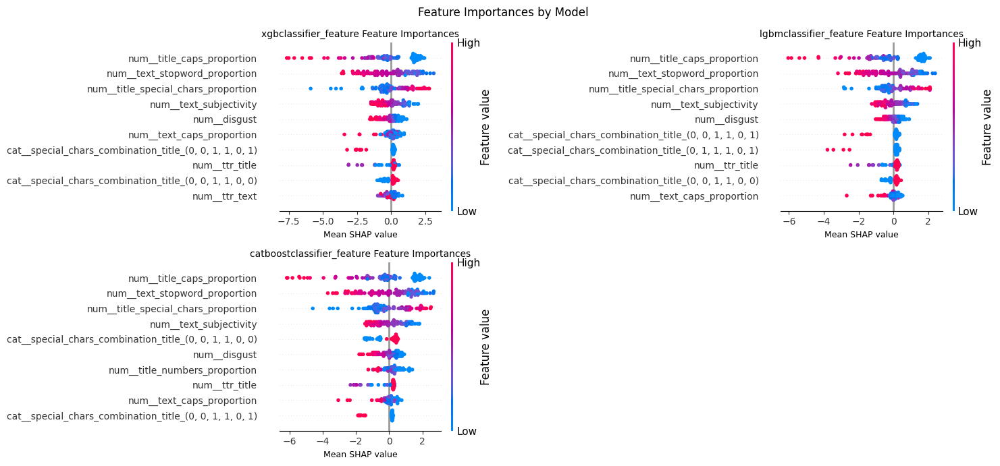

In [577]:
fig, axes = plt.subplots(2, 2)
axes = axes.flatten()

for i, (model_name, shap_values) in enumerate(model_shap_values.items()):

    x_sample = pd.DataFrame(
        X_val_processed,
        columns=preprocess_x.get_feature_names_out()).iloc[:100]

    plt.sca(axes[i])
    shap.summary_plot(shap_values, x_sample, plot_type='dot', color='#a7ceef', 
                  feature_names=x_sample.columns,
                  max_display=10, plot_size=(15, 7),
                  show=False)
    axes[i].set_title(f'{model_name} Feature Importances', size='medium')
    axes[i].tick_params(labelsize=10)
    axes[i].set_xlabel('Mean SHAP value', fontsize=9)

for axes in [axes[-1]]:
    fig.delaxes(axes)
    
plt.suptitle('Feature Importances by Model')
plt.tight_layout()
plt.show()

*Comments:*
* Plots represent the most important features between machine learning models in classifying 'fake' and 'true' articles.
* The most important feature in all three ensemble models was showed to be proportion of caps words in titles - higher value was associated with 'fake' texts.
* Other features showing high importance - stopword proportion, special characters proportion, text subjectivity and emotion disgust. These features have been showed previously to be associated with text class. 

### <a id='toc1_7_3_'></a>[Machine learning classifier models from text](#toc0_)

Previously, engineered features were used to predict article status as fake or true. Now, the whole text will be used. For this approach, some basic preprocessing pipelines - long and short will be used, and more thorough pipelines one-six will be used. Each of these pipelines has some differences but mainly the following data cleaning and preprocessing steps will be applied:
* Lowercasing text
* Punctuation cleaning
* Deleting overused words, such as stopwords, or repeated words
* Deleting names or other proper nouns
* Removing special characters / changing special characters
* Cleaning whitespaces
* Lemmatization of text
* Spelling corection

* Prepare training and validations texts from all preprocessing pipelines

In [150]:
pipeline_short_texts_train = X_train['texts_short_cleaned']
pipeline_long_texts_train = X_train['texts_long_cleaned']

In [152]:
pipeline_short_texts_val = X_val['texts_short_cleaned']
pipeline_long_texts_val = X_val['texts_long_cleaned']

In [769]:
y_train_processed = preprocess_labels.fit_transform(y_train)
y_val_processed = preprocess_labels.transform(y_val)

In [489]:
pipeline_one_texts_train = pd.read_csv(
    os.path.join(data_dir, 'train_processed_pipeline_one.csv'))['text']
pipeline_two_texts_train = pd.read_csv(
    os.path.join(data_dir, 'train_processed_pipeline_two.csv'))['text']
pipeline_three_texts_train = pd.read_csv(
    os.path.join(data_dir, 'train_processed_pipeline_three.csv'))['text']
pipeline_four_texts_train = pd.read_csv(
    os.path.join(data_dir, 'train_processed_pipeline_four.csv'))['text']
pipeline_five_texts_train = pd.read_csv(
    os.path.join(data_dir, 'train_processed_pipeline_five.csv'))['text']
pipeline_six_texts_train = pd.read_csv(
    os.path.join(data_dir, 'train_processed_pipeline_six.csv'))['text']

In [490]:
pipeline_one_texts_val = pd.read_csv(
    os.path.join(data_dir, 'val_processed_pipeline_one.csv'))['text']
pipeline_two_texts_val = pd.read_csv(
    os.path.join(data_dir, 'val_processed_pipeline_two.csv'))['text']
pipeline_three_texts_val = pd.read_csv(
    os.path.join(data_dir, 'val_processed_pipeline_three.csv'))['text']
pipeline_four_texts_val = pd.read_csv(
    os.path.join(data_dir, 'val_processed_pipeline_four.csv'))['text']
pipeline_five_texts_val = pd.read_csv(
    os.path.join(data_dir, 'val_processed_pipeline_five.csv'))['text']
pipeline_six_texts_val = pd.read_csv(
    os.path.join(data_dir, 'val_processed_pipeline_six.csv'))['text']

In [491]:
pipeline_one_texts_additional = pd.read_csv(
    os.path.join(data_dir, 'additional_set_processed_pipeline_one.csv'))['text']
pipeline_two_texts_additional = pd.read_csv(
    os.path.join(data_dir, 'additional_set_processed_pipeline_two.csv'))['text']
pipeline_three_texts_additional = pd.read_csv(
    os.path.join(data_dir, 'additional_set_processed_pipeline_three.csv'))['text']
pipeline_four_texts_additional = pd.read_csv(
    os.path.join(data_dir, 'additional_set_processed_pipeline_four.csv'))['text']
pipeline_five_texts_additional = pd.read_csv(
    os.path.join(data_dir, 'additional_set_processed_pipeline_five.csv'))['text']
pipeline_six_texts_additional = pd.read_csv(
    os.path.join(data_dir, 'additional_set_processed_pipeline_six.csv'))['text']

In [487]:
preprocess_texts = Pipeline([
    ('vectorizer', TfidfVectorizer(stop_words='english'))
])
preprocess_labels = LabelEncoder()

In [492]:
pipeline_one_texts_train = pipeline_one_texts_train.fillna(' ')
pipeline_two_texts_train = pipeline_two_texts_train.fillna(' ')
pipeline_three_texts_train = pipeline_three_texts_train.fillna(' ')
pipeline_four_texts_train = pipeline_four_texts_train.fillna(' ')
pipeline_five_texts_train = pipeline_five_texts_train.fillna(' ')
pipeline_six_texts_train = pipeline_six_texts_train.fillna(' ')

pipeline_one_texts_val = pipeline_one_texts_val.fillna(' ')
pipeline_two_texts_val = pipeline_two_texts_val.fillna(' ')
pipeline_three_texts_val = pipeline_three_texts_val.fillna(' ')
pipeline_four_texts_val = pipeline_four_texts_val.fillna(' ')
pipeline_five_texts_val = pipeline_five_texts_val.fillna(' ')
pipeline_six_texts_val = pipeline_six_texts_val.fillna(' ')

pipeline_one_texts_additional = pipeline_one_texts_additional.fillna(' ')
pipeline_two_texts_additional = pipeline_two_texts_additional.fillna(' ')
pipeline_three_texts_additional = pipeline_three_texts_additional.fillna(' ')
pipeline_four_texts_additional = pipeline_four_texts_additional.fillna(' ')
pipeline_five_texts_additional = pipeline_five_texts_additional.fillna(' ')
pipeline_six_texts_additional = pipeline_six_texts_additional.fillna(' ')

In [588]:
y_additional_data = additional_data['status']
y_additional_processed = preprocess_labels.transform(y_additional_data)

**Short pipeline model fitting**

In [160]:
pipeline_short_texts_train_processed = (
    preprocess_texts.fit_transform(pipeline_short_texts_train)
)
pipeline_short_texts_val_processed = (
    preprocess_texts.transform(pipeline_short_texts_val)
)

In [193]:
cf.rename_dict(model_cache, 'feature')
cf.rename_dict(model_predictions, 'feature')
cf.rename_dict(model_predicted_probabilities, 'feature')
cf.rename_dict(model_params, 'feature')
cf.rename_dict(model_processing_time, 'feature')

In [199]:
for model in selected_models:
    cf.train_and_store_model(
        model=model,
        x_train=pipeline_short_texts_train_processed,
        y_train=y_train_processed,
        x_val=pipeline_short_texts_val_processed,
        model_cache=model_cache,
        model_predictions=model_predictions,
        model_predicted_probabilities=model_predicted_probabilities,
        model_params=model_params,
        model_processing_time=model_processing_time,
        model_param_values=dict(random_state=RANDOM_SEED)
    )

In [220]:
for model_name, predictions in model_predictions.items():
    if 'feature' not in model_name:
        all_models_prediction_metrics[model_name] = cf.get_prediction_metrics(
            y_val_processed,
            predictions,
            model_predicted_probabilities[model_name],
            processing_time=model_processing_time[model_name]
        )

In [224]:
cf.rename_dict(model_cache, 'text_short_pipe')
cf.rename_dict(model_predictions, 'text_short_pipe')
cf.rename_dict(model_predicted_probabilities, 'text_short_pipe')
cf.rename_dict(model_params, 'text_short_pipe')
cf.rename_dict(model_processing_time, 'text_short_pipe')

In [233]:
cf.rename_dict(all_models_prediction_metrics, 'text_short_pipe')

In [465]:
cf.review_prediction_metrics(all_models_prediction_metrics)

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
0,catboostclassifier_feature,0.939611,0.932249,0.955224,0.943597,0.985880,0.985329,13.580023
1,logisticregression_feature,0.895742,0.887697,0.919125,0.903138,0.944782,0.957313,0.176127
2,decisiontreeclassifier_feature,0.888032,0.894134,0.894134,0.894134,0.922126,0.887659,0.461363
3,lgbmclassifier_feature,0.937041,0.932221,0.950017,0.941035,0.984739,0.983978,0.522635
4,xgbclassifier_feature,0.937775,0.929973,0.954183,0.941922,0.984329,0.983903,0.516865
5,heuristic_model_feature,0.778084,0.716805,0.959389,0.820543,NaN,NaN,0.234000
6,catboostclassifier_text_short_pipe,0.978708,0.970748,0.989598,0.980082,0.998145,0.997921,1890.317163
7,logisticregression_text_short_pipe,0.983113,0.980055,0.988211,0.984116,0.996031,0.996529,0.963704
8,decisiontreeclassifier_text_short_pipe,0.921439,0.920548,0.932039,0.926258,0.944282,0.920778,75.231635
9,lgbmclassifier_text_short_pipe,0.981278,0.977351,0.987517,0.982408,0.998292,0.998147,47.285230


*Comments:*
* All models trained on text achieve better performance than models trained on engineered features. However, the obtained improvement is quite small.
* Best performance is achieved by logistic regression model trained on text data. Logistic regression also took less than 1 s to train.

**Long Processing pipeline fitting**

In [ ]:
pipeline_long_texts_train_processed = (
    preprocess_texts.fit_transform(pipeline_long_texts_train)
)
pipeline_long_texts_val_processed = (
    preprocess_texts.transform(pipeline_long_texts_val)
)

In [258]:
for model in selected_models:
    cf.train_and_store_model(
        model=model,
        x_train=pipeline_long_texts_train_processed,
        y_train=y_train_processed,
        x_val=pipeline_long_texts_val_processed,
        model_cache=model_cache,
        model_predictions=model_predictions,
        model_predicted_probabilities=model_predicted_probabilities,
        model_params=model_params,
        model_processing_time=model_processing_time,
        model_param_values=dict(random_state=RANDOM_SEED)
    )

In [259]:
for model_name, predictions in model_predictions.items():
    if 'feature' not in model_name:
        if 'short' not in model_name:
            print(model_name)

In [260]:
cf.rename_dict(model_cache, 'text_long_pipe')
cf.rename_dict(model_predictions, 'text_long_pipe')
cf.rename_dict(model_predicted_probabilities, 'text_long_pipe')
cf.rename_dict(model_params, 'text_long_pipe')
cf.rename_dict(model_processing_time, 'text_long_pipe')

In [261]:
for model_name, predictions in model_predictions.items():
    if all(keyword not in model_name for keyword in \
           ['feature', 'short']):
        all_models_prediction_metrics[model_name] = cf.get_prediction_metrics(
            y_val_processed,
            predictions,
            model_predicted_probabilities[model_name],
            processing_time=model_processing_time[model_name]
        )

In [467]:
cf.review_prediction_metrics(all_models_prediction_metrics)

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
0,catboostclassifier_feature,0.939611,0.932249,0.955224,0.943597,0.985880,0.985329,13.580023
1,logisticregression_feature,0.895742,0.887697,0.919125,0.903138,0.944782,0.957313,0.176127
2,decisiontreeclassifier_feature,0.888032,0.894134,0.894134,0.894134,0.922126,0.887659,0.461363
3,lgbmclassifier_feature,0.937041,0.932221,0.950017,0.941035,0.984739,0.983978,0.522635
4,xgbclassifier_feature,0.937775,0.929973,0.954183,0.941922,0.984329,0.983903,0.516865
5,heuristic_model_feature,0.778084,0.716805,0.959389,0.820543,NaN,NaN,0.234000
6,catboostclassifier_text_short_pipe,0.978708,0.970748,0.989598,0.980082,0.998145,0.997921,1890.317163
7,logisticregression_text_short_pipe,0.983113,0.980055,0.988211,0.984116,0.996031,0.996529,0.963704
8,decisiontreeclassifier_text_short_pipe,0.921439,0.920548,0.932039,0.926258,0.944282,0.920778,75.231635
9,lgbmclassifier_text_short_pipe,0.981278,0.977351,0.987517,0.982408,0.998292,0.998147,47.285230


*Comments:*
* To train models, longer pipeline was used. In this pipeline, additional processing steps were included:
    * Text lemmatization
    * Fixing spelling

* Results that were retrieved with long processing pipeline are very similar to those seen with short pipeline. All models show similar accuracy of ~0.97-0.98 (except for Decision Tree Classifier) and similar ROC AUC metrics.

**Extended text preprocessing pipeline 'one' fitting**

Pipeline does the following preprocessing steps with texts:
* Removes named entities like 'Trump' and others.
* Removes proper nouns.
* Removes special characters like HTML tags, digits, links, email addresses.
* Removes all punctuation.
* Cleans whitespaces.

In [493]:
pipeline_one_texts_train_processed = (
    preprocess_texts.fit_transform(pipeline_one_texts_train)
)
pipeline_one_texts_val_processed = (
    preprocess_texts.transform(pipeline_one_texts_val)
)
pipeline_one_texts_additional_processed = (
    preprocess_texts.transform(pipeline_one_texts_additional)
)

In [292]:
for model in selected_models:
    cf.train_and_store_model(
        model=model,
        x_train=pipeline_one_texts_train_processed,
        y_train=y_train_processed,
        x_val=pipeline_one_texts_val_processed,
        model_cache=model_cache,
        model_predictions=model_predictions,
        model_predicted_probabilities=model_predicted_probabilities,
        model_params=model_params,
        model_processing_time=model_processing_time,
        model_param_values=dict(random_state=RANDOM_SEED)
    )

In [298]:
cf.rename_dict(model_cache, 'text_first_pipe')
cf.rename_dict(model_predictions, 'text_first_pipe')
cf.rename_dict(model_predicted_probabilities, 'text_first_pipe')
cf.rename_dict(model_params, 'text_first_pipe')
cf.rename_dict(model_processing_time, 'text_first_pipe')

In [299]:
for model_name, predictions in model_predictions.items():
    if all(keyword not in model_name for keyword in \
           ['feature', 'short', 'long']):
        all_models_prediction_metrics[model_name] = cf.get_prediction_metrics(
            y_val_processed,
            predictions,
            model_predicted_probabilities[model_name],
            processing_time=model_processing_time[model_name]
        )

In [469]:
cf.review_prediction_metrics(all_models_prediction_metrics)

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
0,catboostclassifier_feature,0.939611,0.932249,0.955224,0.943597,0.985880,0.985329,13.580023
1,logisticregression_feature,0.895742,0.887697,0.919125,0.903138,0.944782,0.957313,0.176127
2,decisiontreeclassifier_feature,0.888032,0.894134,0.894134,0.894134,0.922126,0.887659,0.461363
3,lgbmclassifier_feature,0.937041,0.932221,0.950017,0.941035,0.984739,0.983978,0.522635
4,xgbclassifier_feature,0.937775,0.929973,0.954183,0.941922,0.984329,0.983903,0.516865
5,heuristic_model_feature,0.778084,0.716805,0.959389,0.820543,NaN,NaN,0.234000
6,catboostclassifier_text_short_pipe,0.978708,0.970748,0.989598,0.980082,0.998145,0.997921,1890.317163
7,logisticregression_text_short_pipe,0.983113,0.980055,0.988211,0.984116,0.996031,0.996529,0.963704
8,decisiontreeclassifier_text_short_pipe,0.921439,0.920548,0.932039,0.926258,0.944282,0.920778,75.231635
9,lgbmclassifier_text_short_pipe,0.981278,0.977351,0.987517,0.982408,0.998292,0.998147,47.285230


*Comments:*
* First more in depth pre-processing pipeline did not improve the performance on test data.
* Best results were achieved by logistic regression (0.971 Accuracy, 0.995 ROC AUC), but still were worse than logistic regression model with short pipeline (0.98 Accuracy, 0.997 ROC AUC).

**'Second' extended text preprocessing pipeline fitting** 

Pipeline consists of:
* Lowercasing every word in the sentence.
* Changing 't' to 'not'.
* Removing '@name'
* Isolating and removing punctuations except '?'.
* Removing other special characters.
* Removing stop words except "not" and "can".
* Removing trailing whitespaces.

Pipeline is based on recommendations described here: DOI:10.1016/j.ijcce.2022.03.003

In [498]:
pipeline_two_texts_train_processed = (
    preprocess_texts.fit_transform(pipeline_two_texts_train)
)
pipeline_two_texts_val_processed = (
    preprocess_texts.transform(pipeline_two_texts_val)
)
pipeline_two_texts_additional_processed = (
    preprocess_texts.transform(pipeline_two_texts_additional)
)

In [307]:
for model in selected_models:
    cf.train_and_store_model(
        model=model,
        x_train=pipeline_two_texts_train_processed,
        y_train=y_train_processed,
        x_val=pipeline_two_texts_val_processed,
        model_cache=model_cache,
        model_predictions=model_predictions,
        model_predicted_probabilities=model_predicted_probabilities,
        model_params=model_params,
        model_processing_time=model_processing_time,
        model_param_values=dict(random_state=RANDOM_SEED)
    )

In [309]:
cf.rename_dict(model_cache, 'text_second_pipe')
cf.rename_dict(model_predictions, 'text_second_pipe')
cf.rename_dict(model_predicted_probabilities, 'text_second_pipe')
cf.rename_dict(model_params, 'text_second_pipe')
cf.rename_dict(model_processing_time, 'text_second_pipe')

In [310]:
for model_name, predictions in model_predictions.items():
    if all(keyword not in model_name for keyword in \
           ['feature', 'short', 'long', 'first']):
        all_models_prediction_metrics[model_name] = (
            cf.get_prediction_metrics(
                y_val_processed,
                predictions,
                model_predicted_probabilities[model_name],
                processing_time=model_processing_time[model_name]
            )
        )

In [470]:
cf.review_prediction_metrics(all_models_prediction_metrics)

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
0,catboostclassifier_feature,0.939611,0.932249,0.955224,0.943597,0.985880,0.985329,13.580023
1,logisticregression_feature,0.895742,0.887697,0.919125,0.903138,0.944782,0.957313,0.176127
2,decisiontreeclassifier_feature,0.888032,0.894134,0.894134,0.894134,0.922126,0.887659,0.461363
3,lgbmclassifier_feature,0.937041,0.932221,0.950017,0.941035,0.984739,0.983978,0.522635
4,xgbclassifier_feature,0.937775,0.929973,0.954183,0.941922,0.984329,0.983903,0.516865
5,heuristic_model_feature,0.778084,0.716805,0.959389,0.820543,NaN,NaN,0.234000
6,catboostclassifier_text_short_pipe,0.978708,0.970748,0.989598,0.980082,0.998145,0.997921,1890.317163
7,logisticregression_text_short_pipe,0.983113,0.980055,0.988211,0.984116,0.996031,0.996529,0.963704
8,decisiontreeclassifier_text_short_pipe,0.921439,0.920548,0.932039,0.926258,0.944282,0.920778,75.231635
9,lgbmclassifier_text_short_pipe,0.981278,0.977351,0.987517,0.982408,0.998292,0.998147,47.285230


*Comments:*
* Second processing pipeline achieves similar results as previous pipelines.

**'Third' extended text preprocessing pipeline fitting** 

Pipeline does the following text processing steps:
* Lowercases all text.
* Removes URLs, HTML tags, hashtags, special characters.
* Retains key punctuation like '?', '!' and '.'. Removes all other punctuation.
* Removes all stopwords.
* Cleans whitespaces.

In [361]:
pipeline_three_texts_train_processed = (
    preprocess_texts.fit_transform(pipeline_three_texts_train)
)
pipeline_three_texts_val_processed = (
    preprocess_texts.transform(pipeline_three_texts_val)
)
pipeline_three_texts_additional_processed = (
    preprocess_texts.transform(pipeline_three_texts_additional)
)

In [313]:
for model in selected_models:
    cf.train_and_store_model(
        model=model,
        x_train=pipeline_three_texts_train_processed,
        y_train=y_train_processed,
        x_val=pipeline_three_texts_val_processed,
        model_cache=model_cache,
        model_predictions=model_predictions,
        model_predicted_probabilities=model_predicted_probabilities,
        model_params=model_params,
        model_processing_time=model_processing_time,
        model_param_values=dict(random_state=RANDOM_SEED)
    )

In [315]:
cf.rename_dict(model_cache, 'text_third_pipe')
cf.rename_dict(model_predictions, 'text_third_pipe')
cf.rename_dict(model_predicted_probabilities, 'text_third_pipe')
cf.rename_dict(model_params, 'text_third_pipe')
cf.rename_dict(model_processing_time, 'text_third_pipe')

In [316]:
for model_name, predictions in model_predictions.items():
    if all(keyword not in model_name for keyword in \
           ['feature', 'short', 'long', 'first', 'second']):
        all_models_prediction_metrics[model_name] = (
            cf.get_prediction_metrics(
                y_val_processed,
                predictions,
                model_predicted_probabilities[model_name],
                processing_time=model_processing_time[model_name]
            )
        )

In [471]:
cf.review_prediction_metrics(all_models_prediction_metrics)

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
0,catboostclassifier_feature,0.939611,0.932249,0.955224,0.943597,0.985880,0.985329,13.580023
1,logisticregression_feature,0.895742,0.887697,0.919125,0.903138,0.944782,0.957313,0.176127
2,decisiontreeclassifier_feature,0.888032,0.894134,0.894134,0.894134,0.922126,0.887659,0.461363
3,lgbmclassifier_feature,0.937041,0.932221,0.950017,0.941035,0.984739,0.983978,0.522635
4,xgbclassifier_feature,0.937775,0.929973,0.954183,0.941922,0.984329,0.983903,0.516865
5,heuristic_model_feature,0.778084,0.716805,0.959389,0.820543,NaN,NaN,0.234000
6,catboostclassifier_text_short_pipe,0.978708,0.970748,0.989598,0.980082,0.998145,0.997921,1890.317163
7,logisticregression_text_short_pipe,0.983113,0.980055,0.988211,0.984116,0.996031,0.996529,0.963704
8,decisiontreeclassifier_text_short_pipe,0.921439,0.920548,0.932039,0.926258,0.944282,0.920778,75.231635
9,lgbmclassifier_text_short_pipe,0.981278,0.977351,0.987517,0.982408,0.998292,0.998147,47.285230


*Comments:*
* Third pipeline generates the same results as the first and second pipelines.

**'Fourth' extended text preprocessing pipeline fitting** 

Pipeline does the following preprocessing steps:
* Lowercases all texts.
* Removes URL, HTML tags, hashtags and other special characters.
* Retains key punctuation like '?', '!' and '.'. Removes all other punctuation.
* Removes repeated words in a text.
* Cleanes whitespaces

In [499]:
pipeline_four_texts_train_processed = (
    preprocess_texts.fit_transform(pipeline_four_texts_train)
)
pipeline_four_texts_val_processed = (
    preprocess_texts.transform(pipeline_four_texts_val)
)
pipeline_four_texts_additional_processed = (
    preprocess_texts.transform(pipeline_four_texts_additional)
)

In [319]:
for model in selected_models:
    cf.train_and_store_model(
        model=model,
        x_train=pipeline_four_texts_train_processed,
        y_train=y_train_processed,
        x_val=pipeline_four_texts_val_processed,
        model_cache=model_cache,
        model_predictions=model_predictions,
        model_predicted_probabilities=model_predicted_probabilities,
        model_params=model_params,
        model_processing_time=model_processing_time,
        model_param_values=dict(random_state=RANDOM_SEED)
    )

In [321]:
cf.rename_dict(model_cache, 'text_fourth_pipe')
cf.rename_dict(model_predictions, 'text_fourth_pipe')
cf.rename_dict(model_predicted_probabilities, 'text_fourth_pipe')
cf.rename_dict(model_params, 'text_fourth_pipe')
cf.rename_dict(model_processing_time, 'text_fourth_pipe')

In [322]:
for model_name, predictions in model_predictions.items():
    if all(keyword not in model_name for keyword in \
           ['feature', 'short', 'long', 'first', 'second', 'third']):
        all_models_prediction_metrics[model_name] = cf.get_prediction_metrics(
            y_val_processed,
            predictions,
            model_predicted_probabilities[model_name],
            processing_time=model_processing_time[model_name]
        )

In [472]:
cf.review_prediction_metrics(all_models_prediction_metrics)

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
0,catboostclassifier_feature,0.939611,0.932249,0.955224,0.943597,0.985880,0.985329,13.580023
1,logisticregression_feature,0.895742,0.887697,0.919125,0.903138,0.944782,0.957313,0.176127
2,decisiontreeclassifier_feature,0.888032,0.894134,0.894134,0.894134,0.922126,0.887659,0.461363
3,lgbmclassifier_feature,0.937041,0.932221,0.950017,0.941035,0.984739,0.983978,0.522635
4,xgbclassifier_feature,0.937775,0.929973,0.954183,0.941922,0.984329,0.983903,0.516865
5,heuristic_model_feature,0.778084,0.716805,0.959389,0.820543,NaN,NaN,0.234000
6,catboostclassifier_text_short_pipe,0.978708,0.970748,0.989598,0.980082,0.998145,0.997921,1890.317163
7,logisticregression_text_short_pipe,0.983113,0.980055,0.988211,0.984116,0.996031,0.996529,0.963704
8,decisiontreeclassifier_text_short_pipe,0.921439,0.920548,0.932039,0.926258,0.944282,0.920778,75.231635
9,lgbmclassifier_text_short_pipe,0.981278,0.977351,0.987517,0.982408,0.998292,0.998147,47.285230


*Comments:*
* Results with pipeline four are the best yet. Logistic regression model achieves 0.985 accuracy and 0.997 ROC AUC.

**'Fifth' extended text preprocessing pipeline fitting** 

Pipeline does the following preprocessing steps:
* Removes named entities and proper nouns like 'Trump' and others.
* Lowercases all texts.
* Replaces 't' with 'not'.
* Removes URL, HTML tags, hashtags and other special characters.
* Retains key punctuation like '?', '!' and '.'. Removes all other
punctuation.
* Removes stopwords except 'not' and 'can'.
* Cleans whitespaces.

In [578]:
pipeline_five_texts_train_processed = preprocess_texts.fit_transform(pipeline_five_texts_train)
pipeline_five_texts_val_processed = preprocess_texts.transform(pipeline_five_texts_val)
pipeline_five_texts_additional_processed = preprocess_texts.transform(pipeline_five_texts_additional)

In [325]:
for model in selected_models:
    cf.train_and_store_model(
        model=model,
        x_train=pipeline_five_texts_train_processed,
        y_train=y_train_processed,
        x_val=pipeline_five_texts_val_processed,
        model_cache=model_cache,
        model_predictions=model_predictions,
        model_predicted_probabilities=model_predicted_probabilities,
        model_params=model_params,
        model_processing_time=model_processing_time,
        model_param_values=dict(random_state=RANDOM_SEED)
    )

In [327]:
cf.rename_dict(model_cache, 'text_fifth_pipe')
cf.rename_dict(model_predictions, 'text_fifth_pipe')
cf.rename_dict(model_predicted_probabilities, 'text_fifth_pipe')
cf.rename_dict(model_params, 'text_fifth_pipe')
cf.rename_dict(model_processing_time, 'text_fifth_pipe')

In [328]:
for model_name, predictions in model_predictions.items():
    if all(keyword not in model_name for keyword in \
           ['feature', 'short', 'long', 'first', 'second', 'third', 'fourth']):
        all_models_prediction_metrics[model_name] = cf.get_prediction_metrics(
            y_val_processed,
            predictions,
            model_predicted_probabilities[model_name],
            processing_time=model_processing_time[model_name]
        )

In [473]:
cf.review_prediction_metrics(all_models_prediction_metrics)

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
0,catboostclassifier_feature,0.939611,0.932249,0.955224,0.943597,0.985880,0.985329,13.580023
1,logisticregression_feature,0.895742,0.887697,0.919125,0.903138,0.944782,0.957313,0.176127
2,decisiontreeclassifier_feature,0.888032,0.894134,0.894134,0.894134,0.922126,0.887659,0.461363
3,lgbmclassifier_feature,0.937041,0.932221,0.950017,0.941035,0.984739,0.983978,0.522635
4,xgbclassifier_feature,0.937775,0.929973,0.954183,0.941922,0.984329,0.983903,0.516865
5,heuristic_model_feature,0.778084,0.716805,0.959389,0.820543,NaN,NaN,0.234000
6,catboostclassifier_text_short_pipe,0.978708,0.970748,0.989598,0.980082,0.998145,0.997921,1890.317163
7,logisticregression_text_short_pipe,0.983113,0.980055,0.988211,0.984116,0.996031,0.996529,0.963704
8,decisiontreeclassifier_text_short_pipe,0.921439,0.920548,0.932039,0.926258,0.944282,0.920778,75.231635
9,lgbmclassifier_text_short_pipe,0.981278,0.977351,0.987517,0.982408,0.998292,0.998147,47.285230


*Comments:*
* Fifth pipeline results are comparable to the previous pipelines.

**'Sixth' extended text preprocessing pipeline fitting**
Pipeline does the following preprocessing steps:
* Removes named entities and proper nouns like 'Trump' and others.
* Lowercases all texts.
* Replaces 't' with 'not'.
* Removes URL, HTML tags, hashtags and other special characters.
* Retains key punctuation like '?'. Removes all other
punctuation.
* Removes repeated words in a text.
* Cleans whitespaces.

In [358]:
pipeline_six_texts_train_processed = (
    preprocess_texts.fit_transform(pipeline_six_texts_train)
)
pipeline_six_texts_val_processed = (
    preprocess_texts.transform(pipeline_six_texts_val)
)
pipeline_six_texts_additional_processed = (
    preprocess_texts.transform(pipeline_six_texts_additional)
)

In [331]:
for model in selected_models:
    cf.train_and_store_model(
        model=model,
        x_train=pipeline_six_texts_train_processed,
        y_train=y_train_processed,
        x_val=pipeline_six_texts_val_processed,
        model_cache=model_cache,
        model_predictions=model_predictions,
        model_predicted_probabilities=model_predicted_probabilities,
        model_params=model_params,
        model_processing_time=model_processing_time,
        model_param_values=dict(random_state=RANDOM_SEED)
    )

In [333]:
cf.rename_dict(model_cache, 'text_sixth_pipe')
cf.rename_dict(model_predictions, 'text_sixth_pipe')
cf.rename_dict(model_predicted_probabilities, 'text_sixth_pipe')
cf.rename_dict(model_params, 'text_sixth_pipe')
cf.rename_dict(model_processing_time, 'text_sixth_pipe')

In [334]:
for model_name, predictions in model_predictions.items():
    if all(keyword not in model_name for keyword in \
           ['feature', 'short', 'long', 'first', 'second', 'third', 'fourth',
            'fifth']):
        all_models_prediction_metrics[model_name] = cf.get_prediction_metrics(
            y_val_processed,
            predictions,
            model_predicted_probabilities[model_name],
            processing_time=model_processing_time[model_name]
        )

In [474]:
cf.review_prediction_metrics(all_models_prediction_metrics)

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
0,catboostclassifier_feature,0.939611,0.932249,0.955224,0.943597,0.985880,0.985329,13.580023
1,logisticregression_feature,0.895742,0.887697,0.919125,0.903138,0.944782,0.957313,0.176127
2,decisiontreeclassifier_feature,0.888032,0.894134,0.894134,0.894134,0.922126,0.887659,0.461363
3,lgbmclassifier_feature,0.937041,0.932221,0.950017,0.941035,0.984739,0.983978,0.522635
4,xgbclassifier_feature,0.937775,0.929973,0.954183,0.941922,0.984329,0.983903,0.516865
5,heuristic_model_feature,0.778084,0.716805,0.959389,0.820543,NaN,NaN,0.234000
6,catboostclassifier_text_short_pipe,0.978708,0.970748,0.989598,0.980082,0.998145,0.997921,1890.317163
7,logisticregression_text_short_pipe,0.983113,0.980055,0.988211,0.984116,0.996031,0.996529,0.963704
8,decisiontreeclassifier_text_short_pipe,0.921439,0.920548,0.932039,0.926258,0.944282,0.920778,75.231635
9,lgbmclassifier_text_short_pipe,0.981278,0.977351,0.987517,0.982408,0.998292,0.998147,47.285230


*Comments:*
* Sixth pipeline did not improve previous results.

**Text preprocessing pipeline comparison on additional data**

In total, 8 pipelines were used to preprocess texts from fake/true articles. The best result was achieved with the fourth pipeline and logistic regression model. However, this result is achieved on the same dataset the model was trained on. As it is known that this dataset only contained true texts from one source, it is likely, that these 'good' results will turn quite poor on new data. To test that, previously introduced additional dataset will be used.

In [386]:
for model_name, model in model_cache.items():
    if 'first' in model_name:
        predictions, pred_prob = get_predictions(
            model, pipeline_one_texts_additional_processed)
        additional_data_all_models_predictions[model_name] = predictions
        additional_data_all_models_predicted_probabilities[model_name] = pred_prob
    elif 'second' in model_name:
        predictions, pred_prob = get_predictions(
            model, pipeline_two_texts_additional_processed)
        additional_data_all_models_predictions[model_name] = predictions
        additional_data_all_models_predicted_probabilities[model_name] = pred_prob
    elif 'third' in model_name:
        predictions, pred_prob = get_predictions(
            model, pipeline_three_texts_additional_processed)
        additional_data_all_models_predictions[model_name] = predictions
        additional_data_all_models_predicted_probabilities[model_name] = pred_prob
    elif 'fourth' in model_name:
        predictions, pred_prob = get_predictions(
            model, pipeline_four_texts_additional_processed)
        additional_data_all_models_predictions[model_name] = predictions
        additional_data_all_models_predicted_probabilities[model_name] = pred_prob
    elif 'fifth' in model_name:
        predictions, pred_prob = get_predictions(
            model, pipeline_five_texts_additional_processed)
        additional_data_all_models_predictions[model_name] = predictions
        additional_data_all_models_predicted_probabilities[model_name] = pred_prob
    elif 'sixth' in model_name:
        predictions, pred_prob = get_predictions(
            model, pipeline_six_texts_additional_processed)
        additional_data_all_models_predictions[model_name] = predictions
        additional_data_all_models_predicted_probabilities[model_name] = pred_prob

In [388]:
for model_name, predictions in additional_data_all_models_predictions.items():
    if 'feature' not in model_name:
        additional_data_all_models_prediction_metrics[model_name] = (
            cf.get_prediction_metrics(
                y_additional_processed,
                predictions,
                additional_data_all_models_predicted_probabilities[model_name]
            )
        )

In [475]:
additional_data_all_models_prediction_metrics_df = (
    cf.review_prediction_metrics(additional_data_all_models_prediction_metrics)
)
additional_data_all_models_prediction_metrics_df

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
0,heuristic_model_features,0.561168,0.544747,0.750552,0.631300,NaN,NaN,0.55
1,xgbclassifier_features_features,0.621934,0.587983,0.821654,0.685451,0.682608,0.692090,NaN
2,catboostclassifier_feature,0.625099,0.588483,0.838699,0.691657,0.683667,0.699189,NaN
3,logisticregression_feature,0.607849,0.569923,0.887626,0.694150,0.615013,0.672244,NaN
4,decisiontreeclassifier_feature,0.602310,0.577809,0.767677,0.659347,0.730980,0.601864,NaN
5,lgbmclassifier_feature,0.616553,0.581421,0.839646,0.687072,0.678756,0.693885,NaN
6,xgbclassifier_feature,0.621934,0.587983,0.821654,0.685451,0.682608,0.692090,NaN
7,catboostclassifier_text_fourth_pipe,0.647987,0.731888,0.468307,0.571154,0.695211,0.712062,NaN
8,logisticregression_text_fourth_pipe,0.664720,0.766141,0.475244,0.586610,0.735926,0.747789,NaN
9,decisiontreeclassifier_text_fourth_pipe,0.603788,0.640102,0.476190,0.546112,0.689243,0.603930,NaN


* Best performing models on additional data

In [476]:
additional_data_all_models_prediction_metrics_df.loc[
    additional_data_all_models_prediction_metrics_df['accuracy'] > 0.68
]

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
17,catboostclassifier_text_first_pipe,0.687293,0.752332,0.559445,0.641707,0.757008,0.750363,NaN
18,logisticregression_text_first_pipe,0.686030,0.769617,0.532009,0.629125,0.754926,0.751842,NaN
20,lgbmclassifier_text_first_pipe,0.699763,0.750296,0.599811,0.666667,0.761193,0.765619,NaN
21,xgbclassifier_text_first_pipe,0.701026,0.748734,0.606118,0.669920,0.772005,0.762890,NaN


In [479]:
additional_data_all_models_prediction_metrics_df.loc[
    additional_data_all_models_prediction_metrics_df['roc_auc'] > 0.68
]

,model,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
7,catboostclassifier_text_fourth_pipe,0.647987,0.731888,0.468307,0.571154,0.695211,0.712062,NaN
8,logisticregression_text_fourth_pipe,0.664720,0.766141,0.475244,0.586610,0.735926,0.747789,NaN
10,lgbmclassifier_text_fourth_pipe,0.669455,0.715832,0.563229,0.630427,0.697466,0.731604,NaN
11,xgbclassifier_text_fourth_pipe,0.667561,0.729032,0.534532,0.616812,0.718107,0.731975,NaN
13,logisticregression_text_sixth_pipe,0.653670,0.743641,0.470199,0.576121,0.716834,0.714428,NaN
17,catboostclassifier_text_first_pipe,0.687293,0.752332,0.559445,0.641707,0.757008,0.750363,NaN
18,logisticregression_text_first_pipe,0.686030,0.769617,0.532009,0.629125,0.754926,0.751842,NaN
20,lgbmclassifier_text_first_pipe,0.699763,0.750296,0.599811,0.666667,0.761193,0.765619,NaN
21,xgbclassifier_text_first_pipe,0.701026,0.748734,0.606118,0.669920,0.772005,0.762890,NaN
28,logisticregression_text_third_pipe,0.651934,0.716204,0.504573,0.592044,0.689528,0.723564,NaN


*Comments:*
* All models that achieved the best performance with additional data, were trained on texts, that were processed using first pipeline. 
* The first pipeline consisted of the following procedures:
    * Removal of named entities like 'Trump' and proper nouns.
    * Removal of all special characters like HTML tags, digits, links, email addresses.
    * Removal of all punctuation.
    * Cleaning whitespaces.

* Best performing model was xgboost classifier, that achieved 0.701 accuracy and 0.763 ROC AUC on new data.

### <a id='toc1_7_4_'></a>[Evaluation of classifier models](#toc0_)

In this section, features that added to good model's performance will be analyzed. It seems that tokenizing texts and fitting simple classifier was enough to get good model performance. However, some factors may have contributed to this high performance: all texts in this dataset were from a similar background - political, world news. Other type of false news could be scientific, socio-economic and others. As predictions with additional dataset showed, these models are not really good at predicting articles, different from the ones seen in the origninal dataset.

Models that were based on engineered features, and models that were based on text as a feature, will be reviewed here for feature importance.

**Logistic regression model from text. First pipeline.**

In this pipeline, all proper nouns and named entities where removed, together with other preprocessing steps. It is expected, that such words like 'Trump', Hillary, 'CNN' and others will not be visible as the most important features.

In [494]:
feature_names = np.array(preprocess_texts['vectorizer'].get_feature_names_out())
coef = model_cache['logisticregression_text_first_pipe'].coef_[0]
top_positive_indices = np.argsort(coef)[-10:]
top_negative_indices = np.argsort(coef)[:10]

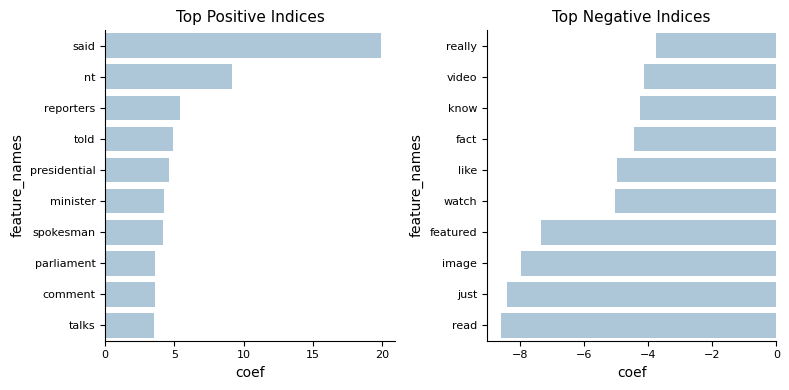

In [495]:
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
axes = axes.ravel()

names = ['Top Positive Indices', 'Top Negative Indices']
for i, indices in enumerate([top_positive_indices, top_negative_indices]):
    indices_df = pd.DataFrame(zip(feature_names[indices], coef[indices]), columns=['feature_names', 'coef'])
    sns.barplot(
        indices_df.sort_values('coef', ascending=False),
        y='feature_names',
        x='coef',
        ax=axes[i]
    )
    axes[i].set_title(names[i])

plt.tight_layout()

*Comments:*
* The most important words that had the highest association with True text prediction (Top positive) were `said`, `nt` and `reporters` with `said` being the most important feature with exceedingly high coeficient. 
* Top negative words - `read`, `just`, `image` and `featured`.

Too high coeficient for words `said`, `nt`, `featured`, `image`, `just` and `read` indicates that they are overused in the texts that belong to either true or fake. It should probably be best to remove these overused words from the processed texts to make the models better generalizing.

**Tree-based models trained on text. First pipeline.**

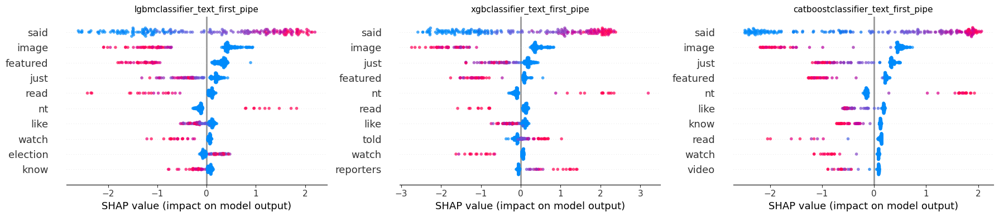

In [497]:
fig, axes = plt.subplots(1, 3)
axes = axes.ravel()

models_to_explain = [
    'lgbmclassifier_text_first_pipe',
    'xgbclassifier_text_first_pipe',
    'catboostclassifier_text_first_pipe'
]

for i, model_name in enumerate(models_to_explain):
    model = model_cache[model_name]
    cf.explain_shap(
        pipeline_one_texts_val_processed,
        model=model,
        feature_names=feature_names,
        sample_size=200,
        ax=axes[i],
        title=model_name,
        plot_size=(18, 4)
    )


*Comments:*
* The same words that showed high importance in Logistic regression model, show high importance in ensemble models. `said` and `image` are the most important words with high number of `said` repetitions being associated with text beeing true, and high occurance of `image` in texts is associated with text being fake.
* Other important features/words in text classification are those that occur more frequently in fake texts - `just`, `read`, `like`, `watch`, `election`, `know`, `told`, `reporters`.

**Logistic regression from text. Fourth pipeline**

Results from this pipeline were worse than those with the first one. However, it followed different preprocessing steps, but reached similar performance of 0.67 accuracy and 0.74 ROC AUC. 

In this processing pipeline, named entities and proper nouns were not changed, but repeated words in a text were removed. So with this pipeline, common stopwords should have smaller influence.

In [500]:
feature_names = np.array(preprocess_texts['vectorizer'].get_feature_names_out())
coef = model_cache['logisticregression_text_fourth_pipe'].coef_[0]
top_positive_indices = np.argsort(coef)[-10:]
top_negative_indices = np.argsort(coef)[:10]

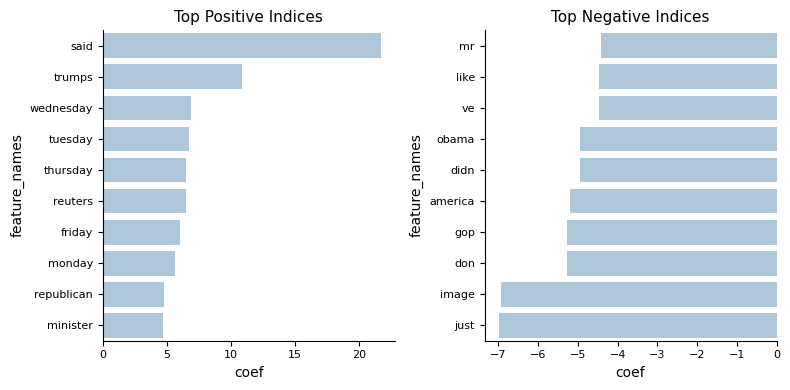

In [501]:
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
axes = axes.ravel()

names = ['Top Positive Indices', 'Top Negative Indices']
for i, indices in enumerate([top_positive_indices, top_negative_indices]):
    indices_df = pd.DataFrame(
        zip(feature_names[indices],
            coef[indices]),
            columns=['feature_names', 'coef'])
    sns.barplot(
        indices_df.sort_values('coef', ascending=False),
        y='feature_names',
        x='coef',
        ax=axes[i]
    )
    axes[i].set_title(names[i])

plt.tight_layout()

*Comments:*
* As expected, some common proper nouns like weekdays, and named entities like 'Trump' are present as the most important features in logistic regression model. 
* Again, word `said` is overused and has a large influence on model's performance.

* Negative words that are associated with fake texts are `just`, and `image`, that have been seen in previous feature importance graphs.

**Tree-based models trained on text. Fourth pipeline.**

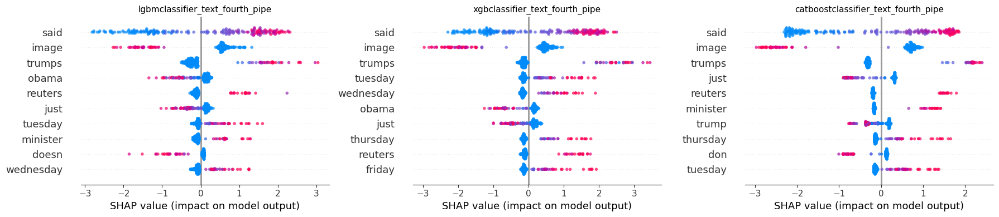

In [502]:
fig, axes = plt.subplots(1, 3)
axes = axes.ravel()

models_to_explain = [
    'lgbmclassifier_text_fourth_pipe',
    'xgbclassifier_text_fourth_pipe',
    'catboostclassifier_text_fourth_pipe'
]

for i, model_name in enumerate(models_to_explain):
    model = model_cache[model_name]
    cf.explain_shap(
        pipeline_four_texts_val_processed,
        model=model,
        feature_names=feature_names,
        sample_size=200,
        ax=axes[i],
        title=model_name,
        plot_size=(18, 4)
    )


*Comments:*
* Tree-based models show most words from logistic regression coefficient evaluation.
* In this model, most words that have high frequency are associated with positive class - true texts - `trumps`, `reuters`, `minister`, `thursday`, `wednesday`, `friday`, `tuesday`.

#### <a id='toc1_7_4_1_'></a>[Additional dataset preprocessing and modeling](#toc0_)

As results with model evaluation showed, all trained models were overfitting on initial dataset. All models showed that their predictions were based on use of some common words that were differentially expressed in true and fake texts. After evaluation with additional dataset, all models showed significantly lower accuracy.

To get better results with better generalization, words that showed unnatural frequency and association with text class, will be removed.

In [505]:
def remove_unnatural_words(texts, unnatural_words):
    unnatural_set = set(word.lower() for word in unnatural_words)

    def clean_text(text):
        words = text.split()
        cleaned_words = [
            word for word in words if not any(unnatural in word.lower() \
                                              for unnatural in unnatural_set)
        ]
        return ' '.join(cleaned_words)

    return texts.apply(clean_text)

In [506]:
unnatural_words = [
    'just', 'read', 'like',
    'watch', 'election',
    'know', 'told', 'reporters',
    'image', 'said', 'nt', 'featured',
]

**Training models based on cleaned data from the first pipeline**

Here, texts processed with the pipeline one and unnatural words removed, will be used to train machine learning models.

In [507]:
pipeline_one_cleaned_texts_train = remove_unnatural_words(
    pipeline_one_texts_train, unnatural_words)
pipeline_one_cleaned_texts_val = remove_unnatural_words(
    pipeline_one_texts_val, unnatural_words)
pipeline_one_cleaned_texts_additional = remove_unnatural_words(
    pipeline_one_texts_additional, unnatural_words)

In [508]:
pipeline_one_cleaned_texts_train_processed = preprocess_texts.fit_transform(
    pipeline_one_cleaned_texts_train)
pipeline_one_cleaned_texts_val_processed = preprocess_texts.transform(
    pipeline_one_cleaned_texts_val)
pipeline_one_cleaned_texts_additional_processed = preprocess_texts.transform(
    pipeline_one_cleaned_texts_additional)

In [514]:
with open(os.path.join(
    project_dir, 'models/model_predicted_probabilities.json'), 'r') as file:
    model_predicted_probabilities = json.load(file)

In [516]:
model_params = {}

In [517]:
model_processing_time = {}

In [529]:
for model in selected_models:
    cf.train_and_store_model(
        model=model,
        x_train=pipeline_one_cleaned_texts_train_processed,
        y_train=y_train_processed,
        x_val=pipeline_one_cleaned_texts_val_processed,
        model_cache=model_cache,
        model_predictions=model_predictions,
        model_predicted_probabilities=model_predicted_probabilities,
        model_params=model_params,
        model_processing_time=model_processing_time,
        model_param_values=dict(random_state=RANDOM_SEED)
    )

Fitting logisticregression
Fitting decisiontreeclassifier
Fitting lgbmclassifier
[LightGBM] [Info] Number of positive: 16325, number of negative: 14547
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.726760 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 723467
[LightGBM] [Info] Number of data points in the train set: 30872, number of used features: 11896
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528796 -> initscore=0.115313
[LightGBM] [Info] Start training from score 0.115313
Fitting xgbclassifier
Fitting catboostclassifier
Learning rate set to 0.044563
0:	learn: 0.6754555	total: 950ms	remaining: 15m 48s
1:	learn: 0.6581544	total: 1.86s	remaining: 15m 27s
2:	learn: 0.6439586	total: 2.65s	remaining: 14m 40s
3:	learn: 0.6304658	total: 3.51s	remaining: 14m 34s
4:	learn: 0.6190026	total: 4.41s	remaining: 14m 37s
5:	learn: 0.6075523	total: 5.3s	remaining: 14m 38s
6:	learn: 0.5981809	total: 6.21s

In [762]:
cf.rename_dict(model_cache, 'text_first_clean_pipe')
cf.rename_dict(model_predictions, 'text_first_clean_pipe')
cf.rename_dict(model_predicted_probabilities, 'text_first_clean_pipe')
cf.rename_dict(model_params, 'text_first_clean_pipe')
cf.rename_dict(model_processing_time, 'text_first_clean_pipe')

In [768]:
y = pd.read_csv(os.path.join(data_dir, 'val_processed_pipeline_one.csv'))['status']

In [771]:
all_models_prediction_metrics = {}

In [772]:
for model_name, predictions in model_predictions.items():
    if all(keyword in model_name for keyword in \
           ['clean']):
        all_models_prediction_metrics[model_name] = cf.get_prediction_metrics(
            y_val_processed,
            predictions,
            model_predicted_probabilities[model_name],
            processing_time=model_processing_time[model_name]
        )

In [774]:
cf.review_prediction_metrics(all_models_prediction_metrics)

,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
catboostclassifier_text_first_clean_pipe,0.947137,0.934404,0.9681,0.950954,0.985205,0.985645,788.854033
logisticregression_text_first_clean_pipe,0.952276,0.948087,0.962552,0.955265,0.987817,0.987367,0.314991
decisiontreeclassifier_text_first_clean_pipe,0.825624,0.831391,0.841193,0.836263,0.878326,0.824653,44.242563
lgbmclassifier_text_first_clean_pipe,0.945668,0.936572,0.962552,0.949384,0.981984,0.9836,26.799594
xgbclassifier_text_first_clean_pipe,0.934288,0.918489,0.961165,0.939343,0.983521,0.98322,76.530565


*Comments:*
* Using cleaned first pipeline texts did not increase model's performance on the original dataset.

In [782]:
for model_name, model in model_cache.items():
    if 'first_clean' in model_name:
        predictions, pred_prob = get_predictions(
            model, pipeline_one_cleaned_texts_additional_processed)
        additional_data_all_models_predictions[model_name] = predictions
        additional_data_all_models_predicted_probabilities[model_name] = pred_prob

In [785]:
for model_name, predictions in additional_data_all_models_predictions.items():
    if 'feature' not in model_name:
        additional_data_all_models_prediction_metrics[model_name] = (
            cf.get_prediction_metrics(
                y_additional_processed,
                predictions,
                additional_data_all_models_predicted_probabilities[model_name]
            )
        )

In [786]:
cf.review_prediction_metrics(additional_data_all_models_prediction_metrics)

,accuracy,precision,recall,f1,pr_auc,roc_auc,processing_time
catboostclassifier_text_first_clean_pipe,0.620679,0.66566,0.486597,0.562215,0.663989,0.662894,None
logisticregression_text_first_clean_pipe,0.632202,0.704623,0.456638,0.554152,0.669596,0.678508,None
decisiontreeclassifier_text_first_clean_pipe,0.575375,0.596008,0.470829,0.526075,0.665858,0.575491,None
lgbmclassifier_text_first_clean_pipe,0.623836,0.6809,0.467676,0.554496,0.662859,0.678038,None
xgbclassifier_text_first_clean_pipe,0.610418,0.645068,0.492904,0.558813,0.656581,0.652328,None


*Comments:*
* Interestingly, removal of unnaturally frequent words such as 'said', 'image' and others has decreased the performance of all models evaluated: compared to previous 0.701 accuracy and 0.772 ROC AUC of XGBclassifier, now the result of the same model on additionally cleaned texts gets 0.610 accuracy and 0.652 ROC AUC. 
* The reason might be that in both of these datasets words that were removed, were common and had some predictive power.

### <a id='toc1_7_5_'></a>[Deep-learning classifier training](#toc0_)

Logistic regression and other machine learning models were good to predict results based on the information in the original dataset. However, all these models failed to gain better generalization when used with true/fake information dataset that has different context. As pre-trained deep-learning models like BERT are better at capturing context in the text, single words will not have as much of effect. Therefore the results of such model with data that has different context could be better than using machine learning methods.

For deep learning models I will use texts preprocessed by first-sixth pipelines that were already used for machine learning models.


**Pipeline one evaluation**

Pipeline consists:
* Removes named entities and proper nouns
* Removes special characters
* Removes all punctuation
* Cleans whitespaces

Deep learning model hyperparameters:
* Learning rate: 1e-4
* Max sequence length: 512
* Pretrained model: DistilBert
* Tokenizer: DistilBert
* Batch size: 8
* Weight decay: 1e-4
* Dropout: 0.3

In [205]:
MODEL_CHECKPOINTS = os.path.join(
    project_dir, 'model_checkpoints'
)

In [206]:
checkpoint_name = (
    'best_checkpoint-first-model-512-epoch=0-val_accuracy=0.980543315410614.ckpt'
)
first_model_checkpoint_path = os.path.join(
    MODEL_CHECKPOINTS, 
    checkpoint_name
)

In [208]:
def load_model(path: str,  model):
    """Load model from checkpoint and set to eval mode"""
    checkpoint_model = FakeTextModule.load_from_checkpoint(
        path,
        model=model,
        lr=TRAIN_LR)
    return checkpoint_model

In [209]:
def get_test_dataloader(
    test_df,
    tokenizer,
    max_seq_len=MAX_SEQ_LEN,
    batch_size=BATCH_SIZE):
    
    """Loads test dataloader using data_module"""
    test_dataset = FakeTextDataset(
        data=test_df,
        tokenizer=tokenizer,
        max_seq_len=max_seq_len
    )
    test_dataloader = DataLoader(
        test_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=1,
    )
    return test_dataloader

In [210]:
def run_model_evaluation(
    model_checkpoint_path,
    preprocessed_test_file, 
    preprocessed_additional_test_file,
    model_name,
    result_name,
    cased=False
):
    if cased:
        bert_tokenizer = DistilBertTokenizer.from_pretrained(
        "distilbert-base-cased",
        do_lower_case=False,
        )

        bert_base_model = DistilBertForSequenceClassification.from_pretrained(
            "distilbert-base-cased",
        )
    else:
        bert_tokenizer = DistilBertTokenizer.from_pretrained(
            "distilbert-base-uncased",
        )

        bert_base_model = DistilBertForSequenceClassification.from_pretrained(
            "distilbert-base-uncased",
        )
    
    model_from_checkpoint = load_model(
        path=model_checkpoint_path,
        model=bert_base_model
    )

    test = pd.read_csv(os.path.join(
        data_dir, preprocessed_test_file))
    
    test.dropna(subset='text', inplace=True)

    test_dataloader = get_test_dataloader(
        test_df=test,
        tokenizer=bert_tokenizer
    )

    test_outputs_path = os.path.join(project_dir, 'test_outputs')

    model_results = cf.eval_model(
        model=model_from_checkpoint,
        test_loader=test_dataloader,
        output_path=test_outputs_path,
        model_name=model_name,
        device=DEVICE
    )

    model_abs_metrics = cf.get_model_metrics(model_results)

    cf.get_model_characteristics(
        model_abs_metrics,
        model_results,
        result_name
    )
    plt.tight_layout()
    plt.show()

    additional_set = pd.read_csv(
        os.path.join(data_dir, preprocessed_additional_test_file)
    )
        
    additional_set = additional_set.replace({'REAL': 'True', 'FAKE': 'Fake'})
    additional_set.rename(columns={'label': 'status'}, inplace=True)
    additional_set.dropna(subset='text', inplace=True)

    additional_test_dataloader = get_test_dataloader(
        test_df=additional_set,
        tokenizer=bert_tokenizer
    )

    model_results_additional = cf.eval_model(
        model=model_from_checkpoint,
        test_loader=additional_test_dataloader,
        output_path=test_outputs_path,
        model_name=f'{model_name}_additional_test',
        device=DEVICE
    )
    
    model_abs_metrics_additional = (
        cf.get_model_metrics(model_results_additional)
    )
    cf.get_model_characteristics(
        model_abs_metrics_additional,
        model_results_additional,
        f'{result_name}. Additional dataset evaluation'
    )
    plt.tight_layout()
    plt.show()

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Evaluating: 100%|██████████| 341/341 [02:11<00:00,  2.60it/s, loss=0.00283]


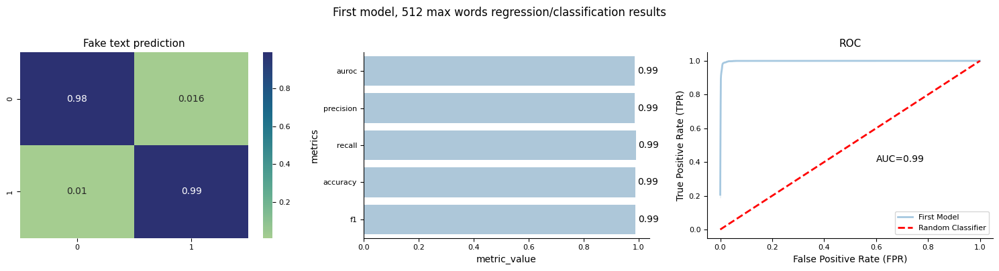

Evaluating: 100%|██████████| 787/787 [05:25<00:00,  2.42it/s, loss=0.466]  


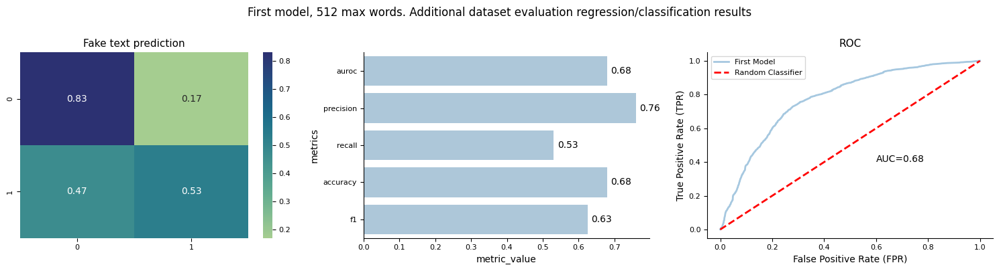

In [211]:
run_model_evaluation(
    first_model_checkpoint_path,
    'test_processed_pipeline_one.csv',
    'additional_set_processed_pipeline_one.csv',
    model_name='first_pipeline_test_model_512',
    result_name='First model, 512 max words',
    cased=False,
)

*Comments:*
* Deep learning model has not achieved better results than the machine learning models.
* Test set ROC AUC reaches 0.99, and accuracy of 0.99.
* Additional dataset ROC AUC 0.68 and accuracy of 0.68. Model underperforms XGBclassifier that achieved 0.70 accuracy and 0.77 ROC AUC
* Model has a good recall for fake texts - 83 % of all fake texts are predicted as such. However, model is still making a lot of false negative mistakes - many texts are predicted as fake, when they are in fact true. 

**Second preprocessing pipeline application and evaluation**

Processing pipeline consisted of:
* Lowercasing every word in a sentence;
* Changing "t" to "not" (can't -> can not);
* Removing all special characters;
* Isolating an removing all punctuation except for '?';
* Removing stopwords, except for "not" and "can".
* Removing trailing whitespaces.

Deep learning model hyperparameters:
* Learning rate: 1e-4
* Max sequence length: 512
* Pretrained model: DistilBert
* Tokenizer: DistilBert
* Batch size: 8
* Weight decay: 1e-4
* Dropout: 0.3

Preprocessing pipeline was suggested by recommendations described in this article: DOI:10.1016/j.ijcce.2022.03.003.

In [403]:
checkpoint_name = 'best_checkpoint-epoch=3-val_accuracy=0.9787077903747559.ckpt'

second_model_checkpoint_path = os.path.join(
    MODEL_CHECKPOINTS, 
    checkpoint_name
)

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Evaluating: 100%|██████████| 341/341 [02:17<00:00,  2.48it/s, loss=0.00189]


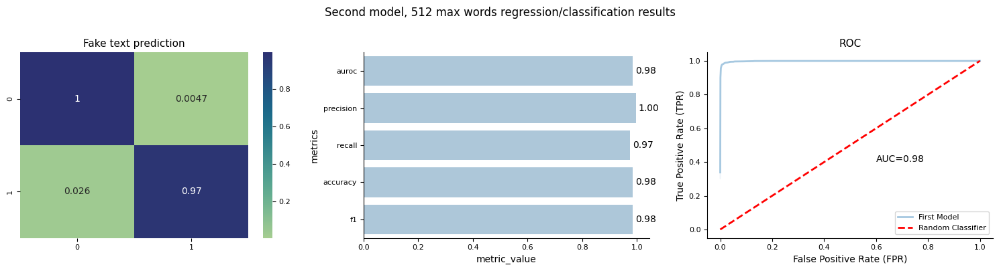

Evaluating: 100%|██████████| 788/788 [05:29<00:00,  2.39it/s, loss=2.69]   


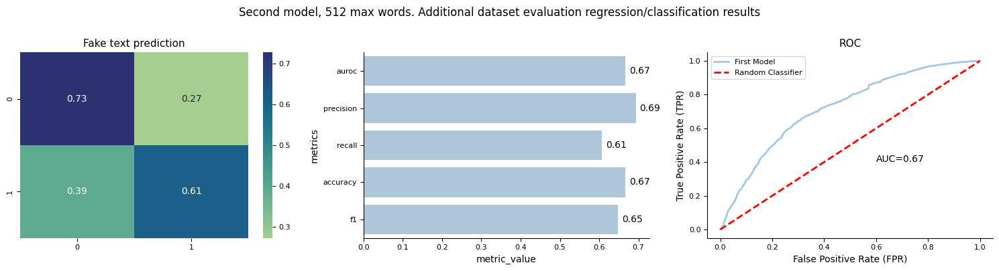

In [404]:
run_model_evaluation(
    second_model_checkpoint_path,
    'test_processed_pipeline_two.csv',
    'additional_set_processed_pipeline_two.csv',
    model_name='second_pipeline_test_model_512',
    result_name='Second model, 512 max words',
    cased=False,
)

*Comments:*
* Text preprocessed with the second pipeline shows similar results that were seen with the first pipeline - ROC AUC and accuracy reach 0.67 score. 
* However, the second pipeline has a more similar false-positive and false-negative balance. So similar number of texts are falsely identified as true/fake.
* If a task is to predict fake and true texts as accurately as possible, this model will make more sense. However, if the task is to find as many fake texts as possible, the first pipeline is a better choice. It makes more false-negative mistakes, but it has a better recall for fake texts.

**Third processing pipeline evaluation**

Pipeline consisted of these steps:
* Lowercasing all text;
* Removing URLs, HTML tags, hashtags, special characters;
* Removing all stopwords;
* Removing punctuation, except for "?", "!", ".";
* Cleaning whitespaces;

Deep learning model hyperparameters:
* Learning rate: 1e-4
* Max sequence length: 512
* Pretrained model: DistilBert
* Tokenizer: DistilBert
* Batch size: 8
* Weight decay: 1e-4
* Dropout: 0.3


In [419]:
checkpoint_name = 'best_checkpoint-epoch=2-val_accuracy=0.9959618449211121.ckpt'

third_model_checkpoint_path = os.path.join(
    MODEL_CHECKPOINTS, 
    checkpoint_name
)

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Evaluating: 100%|██████████| 341/341 [02:03<00:00,  2.75it/s, loss=0.000647]


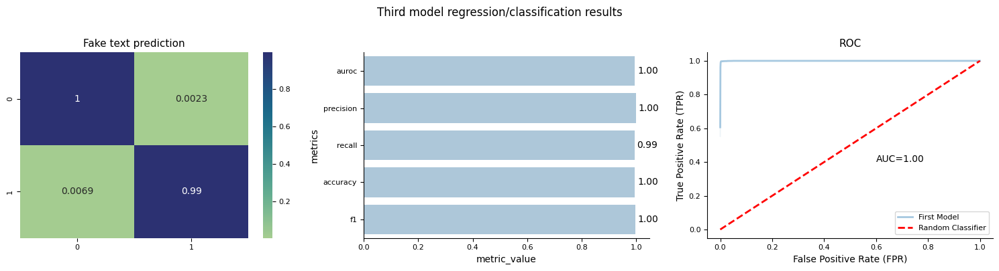

Evaluating: 100%|██████████| 788/788 [05:08<00:00,  2.56it/s, loss=0.000555]


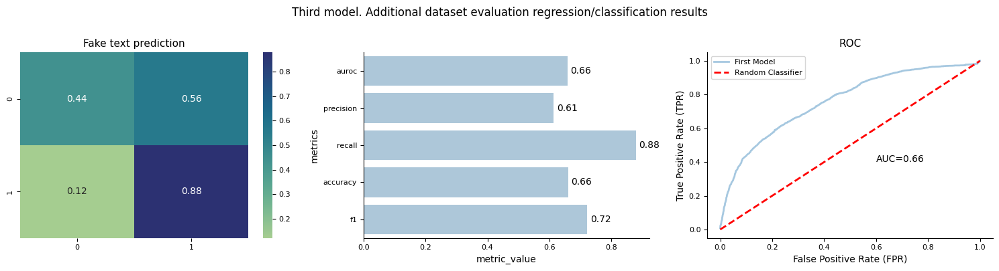

In [420]:
run_model_evaluation(
    third_model_checkpoint_path,
    'test_processed_pipeline_three.csv',
    'additional_set_processed_pipeline_three.csv',
    model_name='third_pipeline_test_model_512',
    result_name='Third model'
)

*Comments:*
* Third text preprocessing pipeline achieves the same results with the test set as previous models.
* Results with additional dataset are worse than those seen with pipeline 2 or 1. ROC AUC and accuracy values achieve 0.64 score.
* Model underperforms in fake text prediction with only 0.53 recall.

Differences between pipeline 2 and pipeline 3:
* Pipeline 3 only some of the special characters were removed
* Pipeline 3 all stopwords were removed
* Pipeline 3 "!" and "." additionally to "?" were retained

After applying pipeline 3, more texts are predicted as true and more false positive mistakes are made compared to pipeline 2. 

**Fourth preprocessing pipeline evaluation**

Pipeline consists of:
* Lowercasing all texts;
* Removing all special characters, tags etc;
* Removing all punctuation except for "?", "!", ",";
* Removing more than once repeated words in a text;
* Cleaning whitespaces.

Deep learning model hyperparameters:
* Learning rate: 1e-4
* Max sequence length: 512
* Pretrained model: DistilBert
* Tokenizer: DistilBert
* Batch size: 8
* Weight decay: 1e-4
* Dropout: 0.3

Pipeline is a derivative of second pipeline with some variations how punctuation and repeated words are addressed.

In [421]:
checkpoint_name = 'best_checkpoint-epoch=3-val_accuracy=0.9908223152160645.ckpt'

four_model_checkpoint_path = os.path.join(
    MODEL_CHECKPOINTS, 
    checkpoint_name
)

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Evaluating: 100%|██████████| 341/341 [02:11<00:00,  2.59it/s, loss=0.00107] 


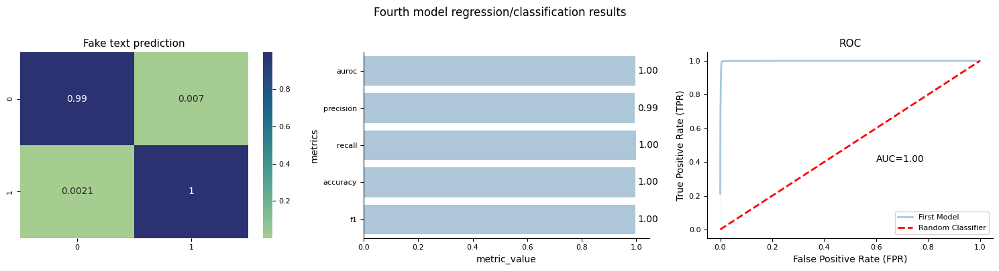

Evaluating: 100%|██████████| 788/788 [05:09<00:00,  2.55it/s, loss=2.83]   


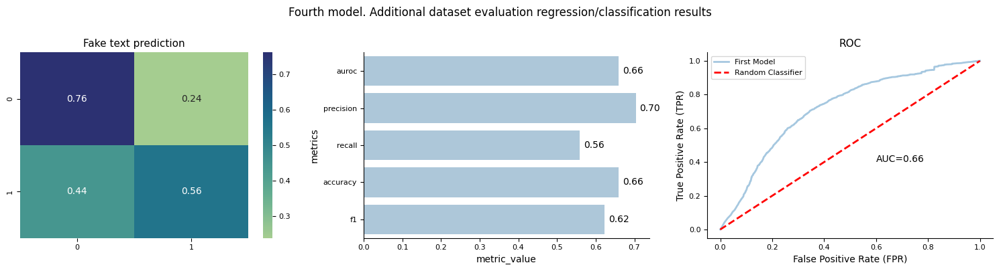

In [422]:
run_model_evaluation(
    four_model_checkpoint_path,
    'test_processed_pipeline_four.csv',
    'additional_set_processed_pipeline_four.csv',
    model_name='fourth_pipeline_test_model_512',
    result_name='Fourth model'
)

*Comments:*
* Fourth pipeline shows the same results with test set - achieves 1.00 ROC AUC and accuracy.
* Model achieves 0.77 recall for fake texts but a high false negative rate.

**Fifth preprocessing pipeline evaluation**

Pipeline consists of:
* Lowercasing all words;
* Removing proper nouns and named entities;
* Replacing 't' with 'not';
* Removing of punctuation, except for '?', '!', and '.';
* Removal of all special characters;
* Removal of stopwords except for 'not' and 'can';
* Cleaning whitespaces.

Deep learning model hyperparameters:
* Learning rate: 1e-4
* Max sequence length: 512
* Pretrained model: DistilBert
* Tokenizer: DistilBert
* Batch size: 8
* Weight decay: 1e-4
* Dropout: 0.3

Pipeline is a combination of the first and the second pipelines that showed better performance. Proper nouns/named entities removal is combined with removal of stopwords and custom punctuation removal.

In [423]:
checkpoint_name = (
    'best_checkpoint-fifth-model-512-epoch=3-val_accuracy=0.9577826857566833.ckpt'
)

fifth_model_checkpoint_path = os.path.join(
    MODEL_CHECKPOINTS, 
    checkpoint_name
)

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Evaluating: 100%|██████████| 341/341 [02:08<00:00,  2.65it/s, loss=0.029]  


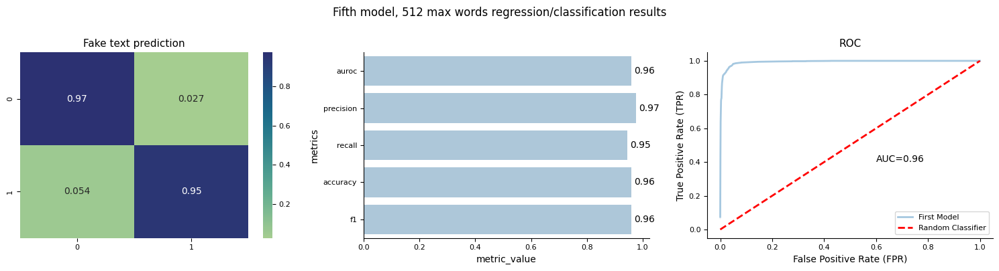

Evaluating: 100%|██████████| 787/787 [05:07<00:00,  2.56it/s, loss=2.48]   


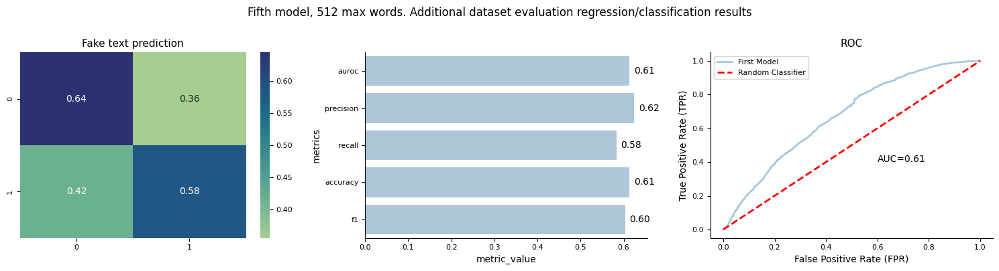

In [424]:
run_model_evaluation(
    fifth_model_checkpoint_path,
    'test_processed_pipeline_five.csv',
    'additional_set_processed_pipeline_five.csv',
    model_name='fifth_pipeline_test_model_512',
    result_name='Fifth model, 512 max words',
    cased=False,
)

*Comments:*
* Fifth model, that combines data preprocessing steps from the first and second models, performs worse on the additional dataset, and reaches only 0.61 ROC AUC and accuracy. It means, that combining stopword removal together with proper nouns/entities removal results in worse learning. One possible explanation - is that removal of too much data from the text leads to worse context interpretation for the model.
* Model achieves balanced prediction with similar false positive and false negative rate.

**Sixth pipeline**

The best results sofar were showed by the first and second pipelines. Combining them into one could lead to better model and better generalization. So this pipeline will have the following steps:
* Removes named entities and proper nouns like 'Trump' and others.
* Lowercases all texts.
* Replaces 't' with 'not'.
* Removes URL, HTML tags, hashtags and other special characters.
* Retains key punctuation like '?'. Removes all other
punctuation.
* Removes repeated words in a text.
* Cleans whitespaces.

In [425]:
checkpoint_name = 'best_checkpoint-sixth-model-512-epoch=2-val_accuracy=0.9801762104034424.ckpt'

sixth_model_checkpoint_path = os.path.join(
    MODEL_CHECKPOINTS, 
    checkpoint_name
)

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Evaluating: 100%|██████████| 341/341 [01:48<00:00,  3.15it/s, loss=0.003]   


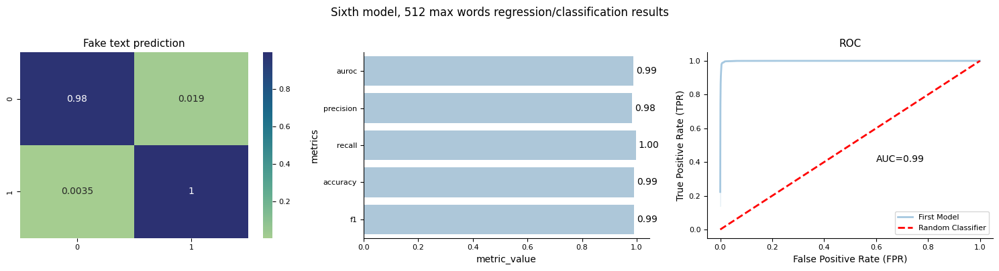

Evaluating: 100%|██████████| 787/787 [05:04<00:00,  2.58it/s, loss=1.81]   


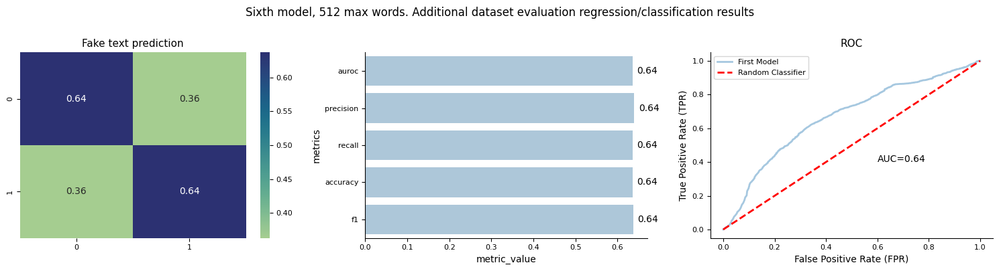

In [430]:
run_model_evaluation(
    sixth_model_checkpoint_path,
    'test_processed_pipeline_six.csv',
    'additional_set_processed_pipeline_six.csv',
    model_name='sixth_pipeline_test_model_512',
    result_name='Sixth model, 512 max words'
)

*Comments:*
* Combining the stopword and proper noun removal did not result in better model's performance on the additional dataset.

**Second pipeline, with model training changes**

As the second pipeline showed the best results with data from additional dataset, it was used together with a changes in training. Previously, 512 words have been used as maximum sequence length. However, it could both lead to better and poorer generalization, depending on how model decides on true/fake texts. To understand if changing the maximum sequence length influences model's performance, it has been changed to 128 maximum words.

In [92]:
checkpoint_name = (
    'best_checkpoint-second-model-128-epoch=0-val_accuracy=0.9915565252304077.ckpt'
)
second_model_checkpoint_path = os.path.join(
    MODEL_CHECKPOINTS, 
    checkpoint_name
)

In [94]:
run_model_evaluation(
    second_model_checkpoint_path,
    'test_processed_pipeline_two.csv',
    'additional_set_processed_pipeline_two.csv',
    model_name='second_pipeline_test_model_128',
    result_name='Second model, 128 max words'
)

*Comments:*
* Reducing the number of maximum words has decreased the model's performance.
* Model predicts true texts better, but fake texts worse.

#### <a id='toc1_7_5_1_'></a>[Feature importance explanation using SHAP.](#toc0_)

Different text pre-processing pipelines did not drastically improve model's performance on data from additional dataset. This means that model still generalizes poorly and probably uses some key words from the starting dataset that can classify well data from the same dataset, but gets poor results on different data. To better understand the problem, feature importance analysis will be applied on model trained using data preprocessed in the first and second pipelines.

In [703]:
second_checkpoint_name = 'best_checkpoint-epoch=3-val_accuracy=0.9787077903747559.ckpt'
first_checkpoint_name = 'best_checkpoint-first-model-512-epoch=0-val_accuracy=0.980543315410614.ckpt'

bert_tokenizer = DistilBertTokenizer.from_pretrained(
    "distilbert-base-uncased",
)

bert_base_model = DistilBertForSequenceClassification.from_pretrained(
    "distilbert-base-uncased",
)

second_model_checkpoint_path = os.path.join(
    MODEL_CHECKPOINTS, 
    second_checkpoint_name
)
second_model_from_checkpoint = load_model(
    path=second_model_checkpoint_path,
    model=bert_base_model
)

bert_tokenizer = DistilBertTokenizer.from_pretrained(
    "distilbert-base-uncased",
)

bert_base_model = DistilBertForSequenceClassification.from_pretrained(
    "distilbert-base-uncased",
)

first_model_checkpoint_path = os.path.join(
    MODEL_CHECKPOINTS, 
    checkpoint_name
)
first_model_from_checkpoint = load_model(
    path=first_model_checkpoint_path,
    model=bert_base_model
)

def predict(
    model: nn.Module,
    dataloader: DataLoader,
    device: torch.device=DEVICE) -> List[Tuple[str, int, float]]:
    """
    Predict the labels for a dataset using a trained model.

    Args:
    model (nn.Module): Trained BERT model.
    dataloader (DataLoader): DataLoader for the dataset.
    device (str, optional): Device to run predictions on ('cuda' or 'cpu'). 
    Defaults to GPU if available.

    Returns:
    List[Tuple[str, int, float]]: A list of tuples containing the original 
    text, predicted label, and confidence.
    """
    model.to(device)
    model.eval()

    predictions = []

    with torch.no_grad():
        for batch in dataloader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['labels']

            outputs = model(input_ids=input_ids, attention_mask=attention_mask)
            logits = outputs.logits
            loss = model.criterion(logits, labels.to(device)).item()
            probs = torch.nn.functional.softmax(logits, dim=-1)

            conf, preds = torch.max(probs, dim=-1)

            for i in range(len(batch["text"])):
                predictions.append((
                    batch["text"][i],
                    preds[i].item(),
                    conf[i].item(),
                    labels[i].item(),
                    loss
                    ))

    return predictions

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [581]:
explainer = shap.Explainer(predict, bert_tokenizer)

* Prepare text samples from additional dataset

In [590]:
pipeline_one_data_additional = pd.DataFrame(
    pipeline_one_texts_additional, columns=['text'])
pipeline_one_data_additional['status'] = y_additional_processed

pipeline_two_data_additional = pd.DataFrame(
    pipeline_two_texts_additional, columns=['text'])
pipeline_two_data_additional['status'] = y_additional_processed

In [591]:
additional_one_text_examples_df = pipeline_one_data_additional.sample(20)
additional_one_text_examples_dataset = FakeTextDataset(
    data=additional_one_text_examples_df, tokenizer=bert_tokenizer)
additional_one_text_examples_dataloader = (
    DataLoader(additional_one_text_examples_dataset)
)

additional_two_text_examples_df = pipeline_two_data_additional.sample(20)
additional_two_text_examples_dataset = FakeTextDataset(
    data=additional_two_text_examples_df, tokenizer=bert_tokenizer)
additional_two_text_examples_dataloader = (
    DataLoader(additional_two_text_examples_dataset)
)

* Prepare text samples from original dataset

In [592]:
pipeline_one_data_original = pd.DataFrame(
    pipeline_one_texts_train, columns=['text'])
pipeline_one_data_original['status'] = y_train_processed

pipeline_two_data_original = pd.DataFrame(
    pipeline_two_texts_train, columns=['text'])
pipeline_two_data_original['status'] = y_train_processed

In [593]:
original_one_text_examples_df = pipeline_one_data_original.sample(20)
original_one_text_examples_dataset = FakeTextDataset(
    data=original_one_text_examples_df, tokenizer=bert_tokenizer)
original_one_text_examples_dataloader = (
    DataLoader(original_one_text_examples_dataset)
)

original_two_text_examples_df = pipeline_two_data_original.sample(20)
original_two_text_examples_dataset = FakeTextDataset(
    data=original_two_text_examples_df, tokenizer=bert_tokenizer)
original_two_text_examples_dataloader = (
    DataLoader(original_two_text_examples_dataset)
)

**Predicting example texts and evaluating probability**

In [595]:
import torch.nn as nn

In [596]:
original_one_set_predictions = predict(
    first_model_from_checkpoint,
    original_one_text_examples_dataloader)

original_two_set_predictions = predict(
    second_model_from_checkpoint,
    original_two_text_examples_dataloader)

additional_one_set_predictions = predict(
    first_model_from_checkpoint,
    additional_one_text_examples_dataloader)

additional_two_set_predictions = predict(
    second_model_from_checkpoint,
    additional_two_text_examples_dataloader)

In [597]:
for text, pred_label, confidence, orig_label, batch_loss in \
    original_one_set_predictions:
    print(f"Text: {text}")
    print(f"Predicted Label: {pred_label}")
    print(f"Original Label: {orig_label:.4f}")
    print(f"Confidence: {confidence:.4f}")
    print(f"Batch loss: {batch_loss:.4f}")
    print("-" * 50)

Text: The area hospitals that treated the shooting victims from the tragic nightclub attack are doing something amazing They won t bill those patients for their out of pocket costs Considering the fact that visits and hospital stays can run if not of dollars and our healthcare industry prioritizes getting their due dollars in any way possible over care this is amazing news indeed Instead which treated most of the victims will seek additional payment from insurance and from a victims fund that city officials established in the wake of the shooting Whatever insurance and the victims fund will be written off which treated victims said it actually won t bill any of them or their insurance nor will it bill them for follow up treatment stemming from the attack The hospitals together will write off in treatment and care and of said The pulse sic shooting was a horrendous tragedy for the victims their families and our entire community During this very trying time many organizations individuals

*Comments:*
* Model makes a few mistakes to determine if the text is fake or not. However, it is very confident about each of these decisions. Probably, model sees some specific words/phrases and determines that text is either fake or true.

In [598]:
for text, pred_label, confidence, orig_label, batch_loss in \
    original_two_set_predictions:
    print(f"Text: {text}")
    print(f"Predicted Label: {pred_label}")
    print(f"Original Label: {orig_label:.4f}")
    print(f"Confidence: {confidence:.4f}")
    print(f"Batch loss: {batch_loss:.4f}")
    print("-" * 50)

Text: record crowd anderson sc night donald strong
Predicted Label: 0
Original Label: 0.0000
Confidence: 0.9956
Batch loss: 0.0044
--------------------------------------------------
Text: supreme court heard arguments challenge brought texas states president barack obamas executive action immigration justices confronted series legal questions beginning texas state challengers grounds bring case obamas november orders affect immigrants country illegally children citizens lawful permanent residents united states children look key legal questions case bring case challengers demonstrate legal standing arising injury negative consequences case means states need hurt obama administrations deferral deportation immigrant parents children deep ties united states country illegally state texas taken lead lawsuit obama administration block presidents actions texas asserts standing largely expected financial cost state processing temporary drivers licenses illegal immigrants new authorization live 

* All of the predictions in the second pipeline original data sample are correct. The model is very confident in all of these decisions.

In [599]:
for text, pred_label, confidence, orig_label, batch_loss in \
    additional_one_set_predictions:
    print(f"Text: {text}")
    print(f"Predicted Label: {pred_label}")
    print(f"Original Label: {orig_label:.4f}")
    print(f"Confidence: {confidence:.4f}")
    print(f"Batch loss: {batch_loss:.4f}")
    print("-" * 50)

Text: a former hospital worker was indicted on a count of degree murder in the abduction and killing of a student who was missing for before her body was discovered law enforcement officials said prosecutor said that the state will not seek the death penalty and that s family has been informed about the state s decision declined to say why was not charged with the higher count of capital murder The abduction and degree murder charges are punishable by up to life in prison was already charged with abduction with intent to defile the Police have said forensic evidence also links to the disappearance and death of student whose body also was found in the county said there are no pending charges against in the case The simple fact is the case involving was ready to be charged she said vanished after a night out with friends According to police she left an off campus party alone and texted a friend saying she was lost In surveillance video she can be seen walking unsteadily and even running 

*Comments:*
* Model trained on the first pipleines predicts incorrectly more usually with additional dataset texts than the original dataset texts. However, it is still very confident about the predictions it makes.

In [600]:
for text, pred_label, confidence, orig_label, batch_loss in \
    additional_two_set_predictions:
    print(f"Text: {text}")
    print(f"Predicted Label: {pred_label}")
    print(f"Original Label: {orig_label:.4f}")
    print(f"Confidence: {confidence:.4f}")
    print(f"Batch loss: {batch_loss:.4f}")
    print("-" * 50)

Text: department homeland securitys funding set expire feb sen ted cruz r texas complained leaders lacked strategy proceed blamed larger funding bill approved december putting party box canyon congress remains splintered fund dhs runs secret service border patrol agencies airport port security things dhs secretary jeh johnson told cnn sunday failing extend funding agency mean employees agency sent home indefinitely pay suggested white house unwilling negotiate dhs funding bill changes immigration policy discussions
Predicted Label: 1
Original Label: 1.0000
Confidence: 0.9994
Batch loss: 0.0006
--------------------------------------------------
Text: bernie sanders thrown support hilary clinton remains seen base follow lead supporters sen bernie sanders vermont march protest downtown sunday philadelphia democratic national convention starts philadelphia amid lingering angst primary process bernie sanders chance encourage supporters embrace party unity sanders set meet privately supporte

*Comments:*
* Model trained on texts processed with the second pipeline makes more mistakes on additional dataset. However, each prediction is made with high confidence.

**Explaining predictions with SHAP**

In [724]:
model = first_model_from_checkpoint

model.eval()

def predict_proba(texts):
    """
    Preprocess the input texts and return model probabilities.
    
    Args:
    texts (Union[np.ndarray, list, str]): Input texts to classify.
    
    Returns:
    np.ndarray: Predicted probabilities for each text and class.
    """
    if isinstance(texts, str):
        texts = [texts]
    if isinstance(texts, np.ndarray):
        texts = texts.tolist()

    tokenizer = DistilBertTokenizer.from_pretrained('bert-base-uncased')
    encoding = tokenizer.batch_encode_plus(
        texts,
        max_length=MAX_SEQ_LEN,
        padding="max_length",
        truncation=True,
        return_attention_mask=True,
        return_tensors="pt"
    ).to(DEVICE)

    input_ids = encoding['input_ids']
    attention_mask = encoding['attention_mask']

    model.eval()
    with torch.no_grad():
        outputs = model(input_ids=input_ids, attention_mask=attention_mask)
        logits = outputs.logits

    probs = torch.nn.functional.softmax(logits, dim=-1)

    return probs.cpu().numpy()

In [725]:
explainer = shap.Explainer(predict_proba, tokenizer)

In [726]:
original_one_set_shap_values = explainer(original_one_text_examples_df.text.tolist())
additional_one_set_shap_values = explainer(additional_one_text_examples_df.text.tolist())

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'BertTokenizer'. 
The class this function is called from is 'DistilBertTokenizer'.
The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'BertTokenizer'. 
The class this function is called from is 'DistilBertTokenizer'.
The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'BertTokenizer'. 
The class this function is called from is 'DistilBertTokenizer'.
The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may 

In [723]:
original_two_set_shap_values = explainer(original_two_text_examples_df.text.tolist())
additional_two_set_shap_values = explainer(additional_two_text_examples_df.text.tolist())

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'BertTokenizer'. 
The class this function is called from is 'DistilBertTokenizer'.
The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'BertTokenizer'. 
The class this function is called from is 'DistilBertTokenizer'.
The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'BertTokenizer'. 
The class this function is called from is 'DistilBertTokenizer'.
The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may 

**First pipeline explanations with SHAP**

Pipeline does the following preprocessing steps with texts:
* Removes named entities like 'Trump' and others.
* Removes proper nouns.
* Removes special characters like HTML tags, digits, links, email addresses.
* Removes all punctuation.
* Cleans whitespaces.

This processing pipeline does not remove stopwords and does not change the text to lowercase.

* Examples from the original dataset

In [731]:
text, pred_label, confidence, orig_label, batch_loss = original_one_set_predictions[0]
print(50*"-")
print(f"Predicted Label: {pred_label}")
print(f"Original Label: {orig_label:.4f}")
print(f"Confidence: {confidence:.4f}")
shap.plots.text(original_one_set_shap_values[0])

--------------------------------------------------
Predicted Label: 0
Original Label: 0.0000
Confidence: 0.9998


*Comments:*
* Example of 'fake' text, that is predicted as 'fake' by the model. Probability is near 1.
* Word importances show that there was not one word that contributed to model's output. From words/phrases that leaned the model towards 'fake' classification the most important were 'out entire' and 'received care', however their influence was only 0.042 and 0.027 respectively.
* Words that pushed the models prediction towards 'true' classification were more influencial than 'fake' words: `hospitals together` and `stemming` had 0.158 and 0.065 value change to the base value.
* Other parts of the text highlighted in red show phrases that are more associated with 'fake' texts - strong language use or obscene comments.

In [732]:
text, pred_label, confidence, orig_label, batch_loss = original_one_set_predictions[1]
print(50*"-")
print(f"Predicted Label: {pred_label}")
print(f"Original Label: {orig_label:.4f}")
print(f"Confidence: {confidence:.4f}")
shap.plots.text(original_one_set_shap_values[1])

--------------------------------------------------
Predicted Label: 1
Original Label: 1.0000
Confidence: 0.9970


*Comments:*
* Example of 'true' text classified as 'true'. Probability is 0.997.
* Only single words and phrases had influence on model's selection to classify text: the most important beeing `among`, `reform` leaning towards 'true' and `par`, `aut` leaning towards 'fake'. However, The model already had strong base values so the prediction is confident even without use of these words.

In [733]:
text, pred_label, confidence, orig_label, batch_loss = original_one_set_predictions[2]
print(50*"-")
print(f"Predicted Label: {pred_label}")
print(f"Original Label: {orig_label:.4f}")
print(f"Confidence: {confidence:.4f}")
shap.plots.text(original_one_set_shap_values[2])

--------------------------------------------------
Predicted Label: 1
Original Label: 1.0000
Confidence: 0.9970


*Comments:*
* Example of 'true' text classified as 'true'.
* Many words had influence in model's prediction, most of them leaning the model towards 'true' text classification. Words that showed highest importance - `said`, `comment`, `exports`, `currency`. In this situation, none of the words leaned the model towards 'fake' classification.
* Single words as the most important features in the model show that model is lacking generalization and instead is concentrating more on specific words than context.

* Examples from the additional dataset

In [734]:
text, pred_label, confidence, orig_label, batch_loss = additional_one_set_predictions[7]
print(50*"-")
print(f"Predicted Label: {pred_label}")
print(f"Original Label: {orig_label:.4f}")
print(f"Confidence: {confidence:.4f}")
shap.plots.text(additional_one_set_shap_values[7])

--------------------------------------------------
Predicted Label: 1
Original Label: 0.0000
Confidence: 0.9970


*Comments:*
* Example of 'fake' text identified as 'true'.
* Most important features in the decision: words `on`, `treaty`, `said`, `parliament` that lean model to 'true' classification. Words that have the opposite effect - `Note`, `is`, `these`. 
* Again, model concentrates on single words, some of which are stopwords leading to incorrect classification.
* Model fails to notice phrases that could better be associated with 'fake' texts - `deal salvaged`, `everyone acts as if this is`, `not a comma has been touched`. 

In [735]:
text, pred_label, confidence, orig_label, batch_loss = additional_one_set_predictions[2]
print(50*"-")
print(f"Predicted Label: {pred_label}")
print(f"Original Label: {orig_label:.4f}")
print(f"Confidence: {confidence:.4f}")
shap.plots.text(additional_one_set_shap_values[2])

--------------------------------------------------
Predicted Label: 0
Original Label: 1.0000
Confidence: 0.9998


*Comments:*
* Example of 'true' text classified as 'fake'.
* Text is very short and the base values of the model already high before using the specific words. Most important words leaning model to its prediction - `keep`, `the`, `jobs` , `to`, `in`. 
* As the text is very short, model concentrates its attention on words, some of which are stopwords to correct its prediction.
* However, in this case not only words are important features as the base value of prediction is already high. Probably other parameters like sentiment, emotion, type-token ratio are the features contributing to prediction but not explained by SHAP.

**Second pipeline model explanation with SHAP**

To review the second pipeline's preprocessing steps:
* Lowercasing texts;
* Changing 't' to 'not';
* Removing @name;
* Removing punctuation, except for '?';
* Removing special characters;
* Removing stopwords, except for 'not', 'can';
* Removing trailing whitespaces.

This pipeline did not include removal of names and other proper nouns.
Pipeline achieved 0.94 ROC AUC and 0.95 accuracy on test set and 0.68 ROC AUC and 0.68 accuracy on additional dataset.

* Examples from the original dataset

In [736]:
text, pred_label, confidence, orig_label, batch_loss = original_two_set_predictions[1]
print(50*"-")
print(f"Predicted Label: {pred_label}")
print(f"Original Label: {orig_label:.4f}")
print(f"Confidence: {confidence:.4f}")
shap.plots.text(original_two_set_shap_values[1])

--------------------------------------------------
Predicted Label: 1
Original Label: 1.0000
Confidence: 0.9993


*Comments:*
* Example of 'true' text classified as 'true'.
* Model concentrates on some most important words/phrases like `lawsuit`, `president`, `president actions`, `administration lawyer`. Together they make up almost half of influence on model's prediction. This separation of specific words shows that model does not take context in this case as important feature and rather uses class-specific words for prediction.

In [746]:
text, pred_label, confidence, orig_label, batch_loss = original_two_set_predictions[8]
print(50*"-")
print(f"Predicted Label: {pred_label}")
print(f"Original Label: {orig_label:.4f}")
print(f"Confidence: {confidence:.4f}")
shap.plots.text(original_two_set_shap_values[8])

--------------------------------------------------
Predicted Label: 1
Original Label: 1.0000
Confidence: 0.9976


*Comments:*
* Example of 'true' text identified as 'true'. 
* In this situation model makes predictions with more distributed feature importance. Still there are some words that have higher influence on model's prediction - like `ministry` or `action`, but the context of the text is also used in the predictions.

* Examples from the additional dataset 

In [738]:
text, pred_label, confidence, orig_label, batch_loss = additional_two_set_predictions[1]
print(50*"-")
print(f"Predicted Label: {pred_label}")
print(f"Original Label: {orig_label:.4f}")
print(f"Confidence: {confidence:.4f}")
shap.plots.text(additional_two_set_shap_values[1])

--------------------------------------------------
Predicted Label: 1
Original Label: 1.0000
Confidence: 0.9972


*Comments:*
* Example of 'true' text classified as 'true'.
* Model uses both specific words/phrases and broader context in its prediction. 

In [750]:
text, pred_label, confidence, orig_label, batch_loss = additional_two_set_predictions[2]
print(50*"-")
print(f"Predicted Label: {pred_label}")
print(f"Original Label: {orig_label:.4f}")
print(f"Confidence: {confidence:.4f}")
shap.plots.text(additional_two_set_shap_values[2])

--------------------------------------------------
Predicted Label: 0
Original Label: 1.0000
Confidence: 0.9954


*Comments:*
* 'True' text is classified as 'fake'.
* Model is already confident in its prediction before using the text words to adjust the result.
* As text is very short, only some words show importance in the prediction - `house`, `white`. 
* Other parameters like sentiment or emotion had higher influence in this decision.

In [752]:
text, pred_label, confidence, orig_label, batch_loss = additional_two_set_predictions[3]
print(50*"-")
print(f"Predicted Label: {pred_label}")
print(f"Original Label: {orig_label:.4f}")
print(f"Confidence: {confidence:.4f}")
shap.plots.text(additional_two_set_shap_values[3])

--------------------------------------------------
Predicted Label: 1
Original Label: 0.0000
Confidence: 0.9973


*Comments:*
* Example of 'fake' text predicted as 'true'.
* Model uses text words/phrases to classify text - such words like `reporting`, `fled`, `towns` had the highest influence on the prediction. 
* It seems that model concentrates on specific words again rather than using broader context of the text.
* However, this example is quite complicated as it does not show typical 'fake' text attributes - strong language or attention words.

### <a id='toc1_7_6_'></a>[Model misclassifications](#toc0_)

Previously has been seen that models make mistakes when predicting texts. Depending on the model, there could be more false positive or false negative mistakes. To better understand, why some predictions failed, I will try to find text common metrics that could have led to misclassification. 

To explain misclassifications, I will use the XGBclassifier trained on text, Catboost classifier model trained on generated features and distilbert models trained on text preprocessed with the first and the second pipelines.

#### <a id='toc1_7_6_1_'></a>[Catboost classifier. Engineered features](#toc0_)

Model achieved 0.939 accuracy and 0.985 ROC AUC on test data from the original dataset. With additional dataset model achieved 0.625 accuracy and 0.699 ROC AUC.

* Load probabilities results

In [99]:
probabilities_path = os.path.join(
    project_dir, 'models/model_predicted_probabilities.json')
additional_data_probabilities_path = os.path.join(
    project_dir, 'models/additional_data_all_models_predicted_probabilities.json'
)

In [100]:
with open(probabilities_path, 'r') as file:
    model_predicted_probabilities = json.load(file)

In [101]:
with open(additional_data_probabilities_path, 'r') as file:
    additional_data_all_models_predicted_probabilities = json.load(file)

* Calculate misclassifications

In [102]:
catboost_misclassified = heuristic_model_preprocessed_X_val.copy()
catboost_misclassified['catboost_features_pred_proba'] = (
    model_predicted_probabilities['catboostclassifier_feature']
)
catboost_misclassified['status'] = y_val_processed_labels
catboost_misclassified['abs_difference'] = (
    abs(catboost_misclassified['status'] - 
        catboost_misclassified['catboost_features_pred_proba'])
)

In [108]:
catboost_misclassified_add = heuristic_model_preprocessed_additional_data.copy()
catboost_misclassified_add['catboost_features_pred_proba'] = (
    additional_data_all_models_predicted_probabilities['catboostclassifier_feature']
)
catboost_misclassified_add['status'] = y_additional_processed
catboost_misclassified_add['abs_difference'] = (
    abs(catboost_misclassified_add['status'] - 
        catboost_misclassified_add['catboost_features_pred_proba'])
)

**Misclassified 'Fake' texts**

In [109]:
catboost_misclassified_fake = catboost_misclassified[
    catboost_misclassified['status'] == 0
].sort_values('abs_difference', ascending=False)

In [110]:
catboost_misclassified_true = catboost_misclassified[
    catboost_misclassified['status'] == 1
].sort_values('abs_difference', ascending=False)

In [111]:
catboost_add_misclassified_fake = catboost_misclassified_add[
    catboost_misclassified_add['status'] == 0
].sort_values('abs_difference', ascending=False)

catboost_add_misclassified_true = catboost_misclassified_add[
    catboost_misclassified_add['status'] == 1
].sort_values('abs_difference', ascending=False)

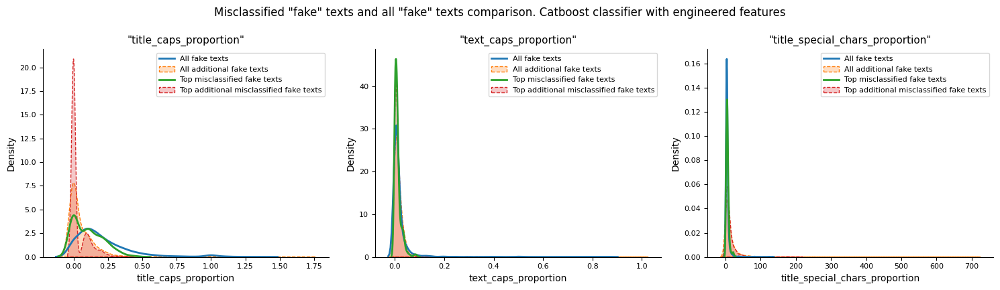

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'title_caps_proportion',
    'text_caps_proportion',
    'title_special_chars_proportion',
]

top_fake_misclassified = catboost_misclassified_fake.loc[
    catboost_misclassified_fake['abs_difference'] > 0.5
]
top_fake_add_misclassified = catboost_add_misclassified_fake.loc[
    catboost_add_misclassified_fake['abs_difference'] > 0.5
]

dfs_to_plot = [
    catboost_misclassified_fake,
    catboost_add_misclassified_fake,
    top_fake_misclassified,
    top_fake_add_misclassified
]
names = [
    'All fake texts',
    'All additional fake texts',
    'Top misclassified fake texts',
    'Top additional misclassified fake texts'
]
linestyles = ['-', '--', '-', '--']
# ["#a6c8e0", "#f4a261", "#7fc98f", "#e76f51"]
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p]
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')


plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'Catboost classifier with engineered features', y=1.07);

*Comments:*
* Top misclassified texts have a different title caps words proportion - it is lower than an average in fake texts.
* Both misclassified and all additional fake texts show lower title caps proportion than the original dataset all fake texts.
* Text caps proportion and title special characters proportions are similar between groups.

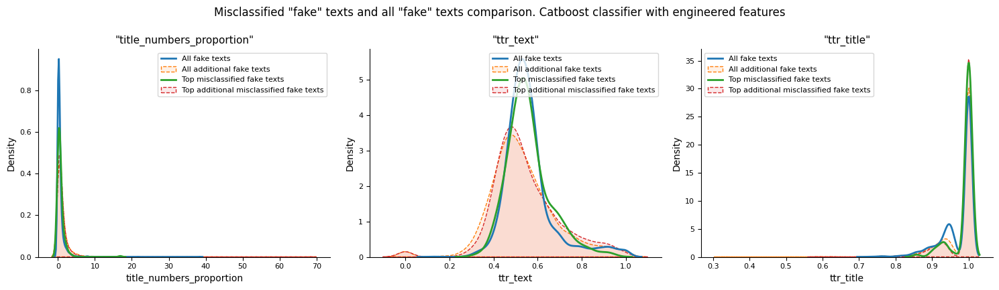

In [194]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'title_numbers_proportion',
    'ttr_text',
    'ttr_title',
]

top_fake_misclassified = catboost_misclassified_fake.loc[
    catboost_misclassified_fake['abs_difference'] > 0.5
]
top_fake_add_misclassified = catboost_add_misclassified_fake.loc[
    catboost_add_misclassified_fake['abs_difference'] > 0.5
]

dfs_to_plot = [
    catboost_misclassified_fake,
    catboost_add_misclassified_fake,
    top_fake_misclassified,
    top_fake_add_misclassified
]
names = [
    'All fake texts',
    'All additional fake texts',
    'Top misclassified fake texts',
    'Top additional misclassified fake texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p],
            alpha=alpha[p]
            
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')

plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'Catboost classifier with engineered features', y=1.07);

*Comments:*
* Proportion of numbers in titles were lower in misclassified fake texts.
* Text-token ratio in texts has a slightly lower density between 'fake' top misclassified samples.
* Text-token ratio in titles is also slightly lower between 'fake' top misclassified samples.
* Additional fake texts and additional misclassified fake texts have similar title numbers proportion, but lower average text-token ratio and more spread-out distribution.

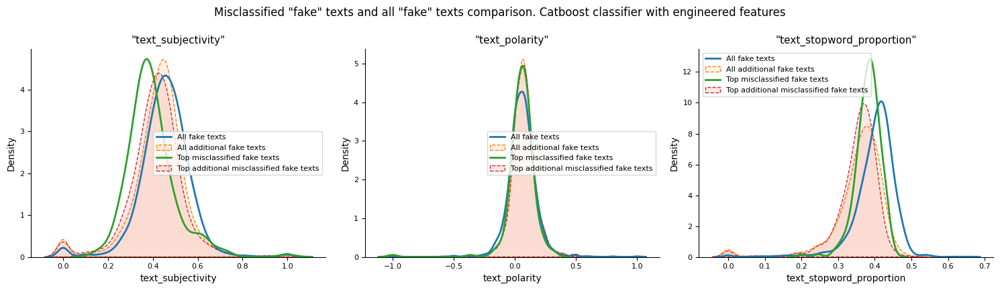

In [195]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'text_subjectivity',
    'text_polarity',
    'text_stopword_proportion',
]

top_fake_misclassified = catboost_misclassified_fake.loc[
    catboost_misclassified_fake['abs_difference'] > 0.5
]
top_fake_add_misclassified = catboost_add_misclassified_fake.loc[
    catboost_add_misclassified_fake['abs_difference'] > 0.5
]

dfs_to_plot = [
    catboost_misclassified_fake,
    catboost_add_misclassified_fake,
    top_fake_misclassified,
    top_fake_add_misclassified
]
names = [
    'All fake texts',
    'All additional fake texts',
    'Top misclassified fake texts',
    'Top additional misclassified fake texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p],
            alpha=alpha[p]
            
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')

plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'Catboost classifier with engineered features', y=1.07);

*Comments:*
* Subjectivity in texts is lower between top 'fake' misclassified texts. Additional fake texts show slightly lower text subjectivity compared to the original dataset.
* Text stopwords proportion is lower between top 'fake' misclassified texts. It is also lower in between additional fake texts.
* Text polarity is similar in all text groups.

C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\4002123828.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_fake_misclassified['hue'] = 'Top misclassified fake texts'
C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\4002123828.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_fake_add_misclassified['hue'] = 'Top additional misclassified fake texts'


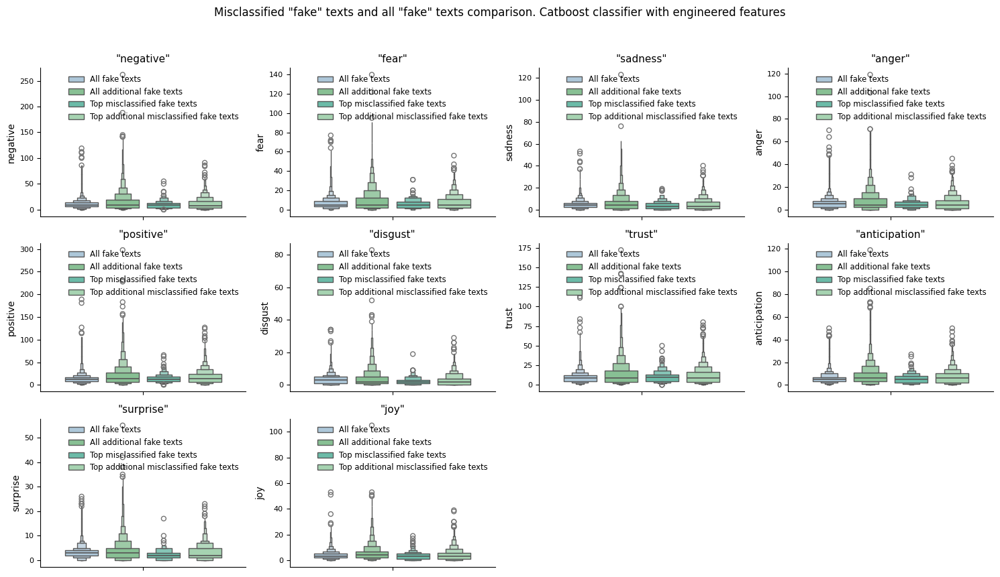

In [113]:
fig, axes = plt.subplots(3, 4, figsize=(15, 8))
axes = axes.ravel()

cols_to_plot = [
    'negative', 'fear', 'sadness',
    'anger', 'positive', 'disgust',
    'trust', 'anticipation', 'surprise',
    'joy'
]

top_fake_misclassified = catboost_misclassified_fake.loc[
    catboost_misclassified_fake['abs_difference'] > 0.5
]
top_fake_add_misclassified = catboost_add_misclassified_fake.loc[
    catboost_add_misclassified_fake['abs_difference'] > 0.5
]

catboost_misclassified_fake['hue'] = 'All fake texts'
catboost_add_misclassified_fake['hue'] = 'All additional fake texts'
top_fake_misclassified['hue'] = 'Top misclassified fake texts'
top_fake_add_misclassified['hue'] = 'Top additional misclassified fake texts'

dfs_to_plot = pd.concat([
    catboost_misclassified_fake,
    catboost_add_misclassified_fake,
    top_fake_misclassified,
    top_fake_add_misclassified
])


names = [
    'All fake texts',
    'All additional fake texts',
    'Top misclassified fake texts',
    'Top additional misclassified fake texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    sns.boxenplot(
        dfs_to_plot,
        y=col,
        ax=axes[i],
        hue='hue',
        gap=0.2        
    )
    axes[i].set_title(f'"{col}"')
    axes[i].legend(frameon=False, loc='upper right', fontsize='small')
for a in [axes[-1], axes[-2]]:
    fig.delaxes(a)
plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'Catboost classifier with engineered features', y=1.07);

*Comments:*
* Emotions are similar in all 'fake' texts and top misclassified 'fake' texts. Additional fake data also show similar results.

General misclassified 'fake' text conclusions:
* Misclassified 'fake' texts have lower subjectivity, and text stopword proportion that usual 'fake' texts.
* Misclassified 'fake' texts show different distribution of title caps words proportion and text-token ratio in texts and titles.

General conclusions about 'fake' texts from additional dataset:
* Caps words proportions in titles is lower between additional 'fake' texts.
* Subjectivity is slightly lower between additional 'fake' texts.
* Text-token ratio is lower between additional 'fake' texts and distribution is very different.
* Text stopword proportion is lower than in the original dataset and is similar to those texts that were misclassified from the original dataset.

**Misclassified 'true' texts**

In [114]:
selected_parameters = [
    'special_chars_combination_title',

]
selected_parameters_float = [
    'title_caps_proportion',
    'text_caps_proportion',
    'title_special_chars_proportion',
    'title_numbers_proportion',
    'ttr_text',
    'ttr_title',
    'text_subjectivity',
    'text_polarity',
    'text_stopword_proportion',
    'negative', 'fear', 'sadness',
    'anger', 'positive', 'disgust',
    'trust', 'anticipation', 'surprise',
    'joy',
]

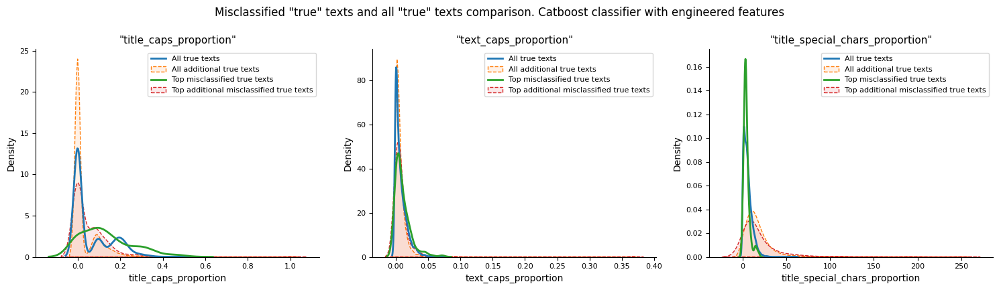

In [211]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'title_caps_proportion',
    'text_caps_proportion',
    'title_special_chars_proportion',
]

top_true_misclassified = catboost_misclassified_true.loc[
    catboost_misclassified_true['abs_difference'] > 0.5
]
top_true_add_misclassified = catboost_add_misclassified_true.loc[
    catboost_add_misclassified_true['abs_difference'] > 0.5
]

dfs_to_plot = [
    catboost_misclassified_true,
    catboost_add_misclassified_true,
    top_true_misclassified,
    top_true_add_misclassified
]
names = [
    'All true texts',
    'All additional true texts',
    'Top misclassified true texts',
    'Top additional misclassified true texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p],
            alpha=alpha[p]
            
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')

plt.tight_layout()
plt.suptitle('Misclassified "true" texts and all "true" texts comparison. '
             'Catboost classifier with engineered features', y=1.07);

*Comments:*
* Top 'true' misclassified texts show higher on average title caps proportion, which is more common between 'fake' texts.
* Proportion of special characters is slightly lower between misclassified 'true' texts.

* True texts from the additional dataset show a more spreadout title caps proportion with lower dominating values.
* True texts from additional dataset show wider distribution of special character proportion in titles.

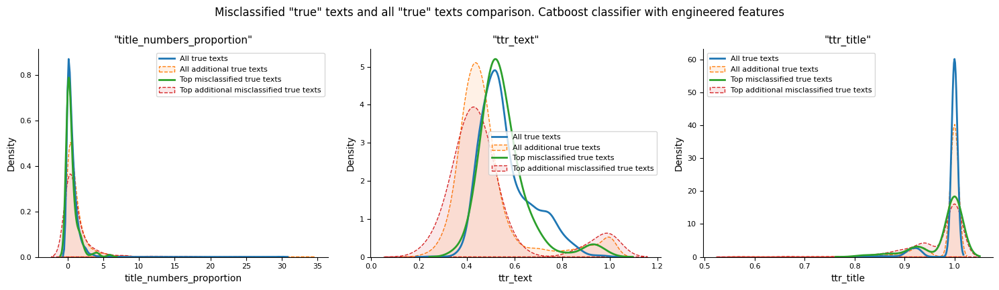

In [212]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'title_numbers_proportion',
    'ttr_text',
    'ttr_title',
]

top_true_misclassified = catboost_misclassified_true.loc[
    catboost_misclassified_true['abs_difference'] > 0.5
]
top_true_add_misclassified = catboost_add_misclassified_true.loc[
    catboost_add_misclassified_true['abs_difference'] > 0.5
]

dfs_to_plot = [
    catboost_misclassified_true,
    catboost_add_misclassified_true,
    top_true_misclassified,
    top_true_add_misclassified
]
names = [
    'All true texts',
    'All additional true texts',
    'Top misclassified true texts',
    'Top additional misclassified true texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p],
            alpha=alpha[p]
            
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')

plt.tight_layout()
plt.suptitle('Misclassified "true" texts and all "true" texts comparison. '
             'Catboost classifier with engineered features', y=1.07);

*Comments:*
* Type-token ratio distribution is different between all true texts and top misclassified 'true' texts.
* Type-token ration in titles is slightly lower in misclassified 'true' text group.

* Type-token ratio in additional true texts is lower compared to the original dataset which indicates lower text diversity.

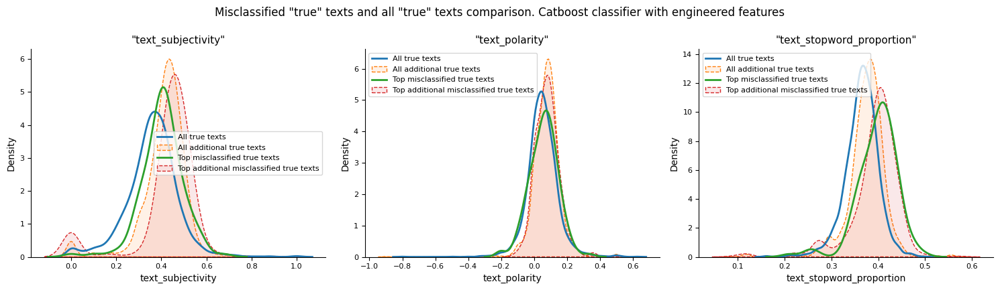

In [213]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'text_subjectivity',
    'text_polarity',
    'text_stopword_proportion',
]

top_true_misclassified = catboost_misclassified_true.loc[
    catboost_misclassified_true['abs_difference'] > 0.5
]
top_true_add_misclassified = catboost_add_misclassified_true.loc[
    catboost_add_misclassified_true['abs_difference'] > 0.5
]

dfs_to_plot = [
    catboost_misclassified_true,
    catboost_add_misclassified_true,
    top_true_misclassified,
    top_true_add_misclassified
]
names = [
    'All true texts',
    'All additional true texts',
    'Top misclassified true texts',
    'Top additional misclassified true texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p],
            alpha=alpha[p]
            
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')

plt.tight_layout()
plt.suptitle('Misclassified "true" texts and all "true" texts comparison. '
             'Catboost classifier with engineered features', y=1.07);

*Comments:*
* Text subjectivity and stopwords proportion in texts is higher in misclassified 'true' texts. These features were more common to 'fake' texts.
* Text subjectivity is higher between additional true texts. Similarly, text polarity is also slightly higher. 
* Misclassified addditional texts show similar text stopword proportion to misclassified texts from the original dataset.

C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\2773831594.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_true_misclassified['hue'] = 'Top misclassified true texts'
C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\2773831594.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_true_add_misclassified['hue'] = 'Top additional misclassified true texts'


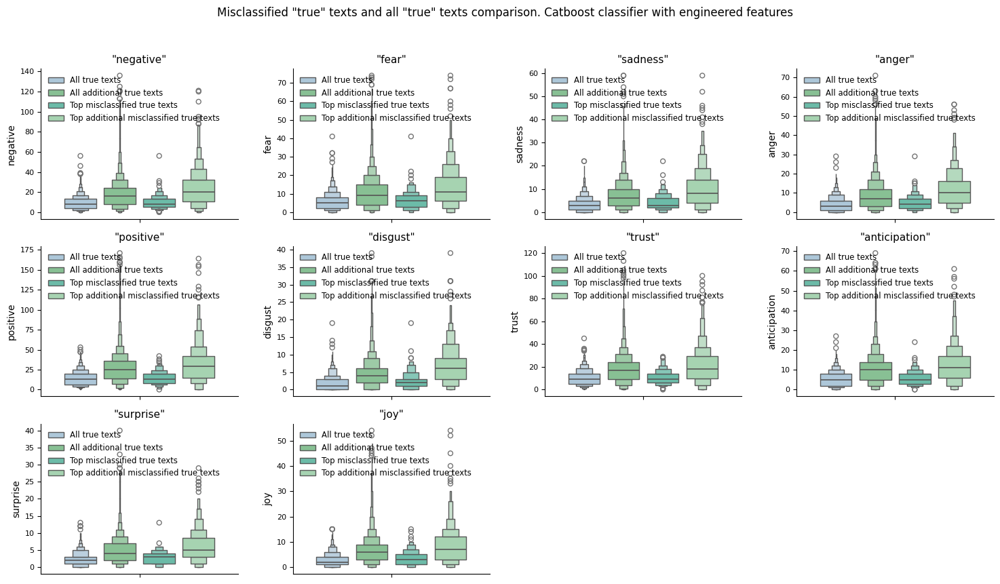

In [116]:
fig, axes = plt.subplots(3, 4, figsize=(15, 8))
axes = axes.ravel()

cols_to_plot = [
    'negative', 'fear', 'sadness',
    'anger', 'positive', 'disgust',
    'trust', 'anticipation', 'surprise',
    'joy'
]

top_true_misclassified = catboost_misclassified_true.loc[
    catboost_misclassified_true['abs_difference'] > 0.5
]
top_true_add_misclassified = catboost_add_misclassified_true.loc[
    catboost_add_misclassified_true['abs_difference'] > 0.5
]

catboost_misclassified_true['hue'] = 'All true texts'
catboost_add_misclassified_true['hue'] = 'All additional true texts'
top_true_misclassified['hue'] = 'Top misclassified true texts'
top_true_add_misclassified['hue'] = 'Top additional misclassified true texts'

dfs_to_plot = pd.concat([
    catboost_misclassified_true,
    catboost_add_misclassified_true,
    top_true_misclassified,
    top_true_add_misclassified
])

names = [
    'All fake texts',
    'All additional fake texts',
    'Top misclassified fake texts',
    'Top additional misclassified fake texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    sns.boxenplot(
        dfs_to_plot,
        y=col,
        ax=axes[i],
        hue='hue',
        gap=0.2        
    )
    axes[i].set_title(f'"{col}"')
    axes[i].legend(loc='upper left', fontsize='small', frameon=False)

for a in [axes[-1], axes[-2]]:
    fig.delaxes(a)

plt.tight_layout()
plt.suptitle('Misclassified "true" texts and all "true" texts comparison. '
             'Catboost classifier with engineered features', y=1.07);

*Comments:*
* Misclassified 'true' texts show slightly higher averge emotion level compared to all 'true' texts.
* 'True' texts from the additional dataset show more spread-out distribution of emotions compared to the original dataset. The median emotion values are also higher.

#### <a id='toc1_7_6_2_'></a>[XGBoost classifier trained on text. Text preprocessing pipeline one.](#toc0_)

This model has achieved 0.961 accuracy and 0.993 ROC AUC on test data. On additional dataset this model achieved 0.701 accuracy and 0.772 ROC AUC.

In [139]:
y_pipeline_one = pd.read_csv(
    os.path.join(data_dir, 'val_processed_pipeline_one.csv')
)['status']

In [129]:
pipeline_one_texts_val_df = (
    pd.DataFrame(pipeline_one_texts_val, columns=['text'])
)
pipeline_one_texts_val_df.fillna(' ', inplace=True)
xgboost_misclassified = cf.calculate_text_features(
    pipeline_one_texts_val_df)

Calculating text caps proportion
Calculating type-token ratio
Calculating text sentiment
Calculating text emotions


In [142]:
xgboost_misclassified['status'] = y_val_processed

In [143]:
xgboost_misclassified['abs_difference'] = (
    abs(xgboost_misclassified['status'] - 
        model_predicted_probabilities['xgbclassifier_text_first_pipe'])
)

In [144]:
xgboost_misclassified_fake = xgboost_misclassified[
    xgboost_misclassified['status'] == 0
].sort_values('abs_difference', ascending=False)

xgboost_misclassified_true = xgboost_misclassified[
    xgboost_misclassified['status'] == 1
].sort_values('abs_difference', ascending=False)

In [177]:
xgboost_misclassified_add = heuristic_model_preprocessed_additional_data.copy()
xgboost_misclassified_add['xgbclassifier_text_first_pipe_pred_proba'] = (
    additional_data_all_models_predicted_probabilities['xgbclassifier_text_first_pipe']
)
xgboost_misclassified_add['status'] = y_additional_processed
xgboost_misclassified_add['abs_difference'] = (
    abs(xgboost_misclassified_add['status'] - 
        xgboost_misclassified_add['xgbclassifier_text_first_pipe_pred_proba'])
)

In [197]:
xgboost_misclassified_add_fake = xgboost_misclassified_add[
    xgboost_misclassified_add['status'] == 0
].sort_values('abs_difference', ascending=False)

xgboost_misclassified_add_true = xgboost_misclassified_add[
    xgboost_misclassified_add['status'] == 1
].sort_values('abs_difference', ascending=False)

**Fake text misclassification**

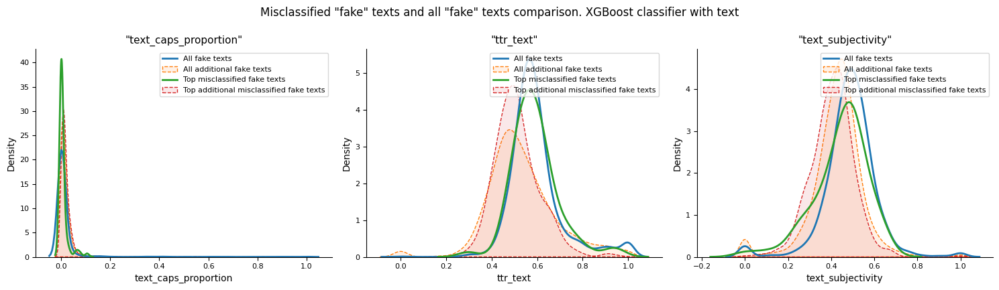

In [198]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'text_caps_proportion',
    'ttr_text',
    'text_subjectivity',
]

top_fake_misclassified = xgboost_misclassified_fake.loc[
    xgboost_misclassified_fake['abs_difference'] > 0.5
]
top_fake_add_misclassified = xgboost_misclassified_add_fake.loc[
    xgboost_misclassified_add_fake['abs_difference'] > 0.5
]

dfs_to_plot = [
    xgboost_misclassified_fake,
    xgboost_misclassified_add_fake,
    top_fake_misclassified,
    top_fake_add_misclassified
]
names = [
    'All fake texts',
    'All additional fake texts',
    'Top misclassified fake texts',
    'Top additional misclassified fake texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p],
            alpha=alpha[p]
            
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')

plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'XGBoost classifier with text', y=1.07);

*Comments:*
* Text caps words proportion and text-token ratio in texts is similar between misclassified 'fake' text group and all 'fake' text group in the original dataset.
* Text subjectivity is lower between top misclassified 'fake' texts. As subjectivity is generally lower between 'true' texts, that might be the reason for misclassification.
* Type-token ratio in between additional 'fake' texts differs quite significantly to the original dataset 'fake' texts. Similarly, text subjevtivity is lower too.

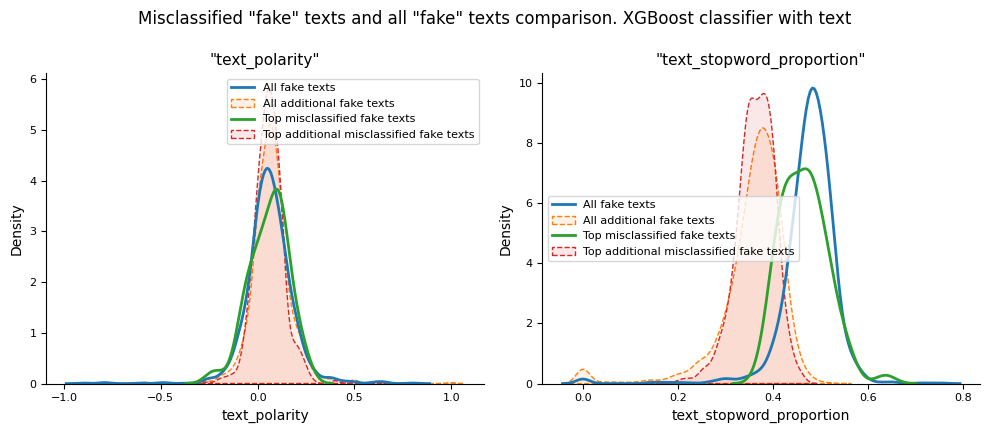

In [199]:
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes = axes.ravel()

cols_to_plot = [
    'text_polarity',
    'text_stopword_proportion'
]

top_fake_misclassified = xgboost_misclassified_fake.loc[
    xgboost_misclassified_fake['abs_difference'] > 0.5
]
top_fake_add_misclassified = xgboost_misclassified_add_fake.loc[
    xgboost_misclassified_add_fake['abs_difference'] > 0.5
]

dfs_to_plot = [
    xgboost_misclassified_fake,
    xgboost_misclassified_add_fake,
    top_fake_misclassified,
    top_fake_add_misclassified
]
names = [
    'All fake texts',
    'All additional fake texts',
    'Top misclassified fake texts',
    'Top additional misclassified fake texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p],
            alpha=alpha[p]
            
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')

plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'XGBoost classifier with text', y=1.07);

*Comments:*
* Text polarity and text length is similar in both original dataset 'fake' text groups.
* Stopword proportion is slightly lower between misclassified 'fake' texts. Stopoword proportion was seen to be higher in 'fake' texts. So the misclassified 'fake' texts show more similarities to true texts.
* 'Fake' texts from the additional dataset show a more dense text polarity distribution and lower average text-stopword proportion.

C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\633866594.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_fake_misclassified['hue'] = 'Top misclassified fake texts'
C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\633866594.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_fake_add_misclassified['hue'] = 'Top additional misclassified fake texts'


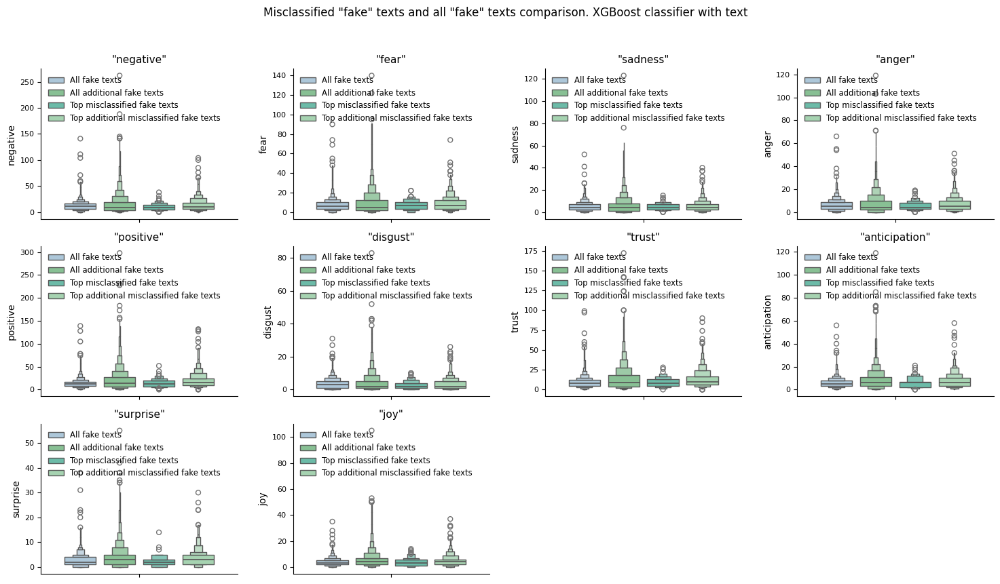

In [200]:
fig, axes = plt.subplots(3, 4, figsize=(15, 8))
axes = axes.ravel()

cols_to_plot = [
    'negative', 'fear', 'sadness',
    'anger', 'positive', 'disgust',
    'trust', 'anticipation', 'surprise',
    'joy', 
]

top_fake_misclassified = xgboost_misclassified_fake.loc[
    xgboost_misclassified_fake['abs_difference'] > 0.5
]
top_fake_add_misclassified = xgboost_misclassified_add_fake.loc[
    xgboost_misclassified_add_fake['abs_difference'] > 0.5
]

xgboost_misclassified_fake['hue'] = 'All fake texts'
xgboost_misclassified_add_fake['hue'] = 'All additional fake texts'
top_fake_misclassified['hue'] = 'Top misclassified fake texts'
top_fake_add_misclassified['hue'] = 'Top additional misclassified fake texts'

dfs_to_plot = pd.concat([
    xgboost_misclassified_fake,
    xgboost_misclassified_add_fake,
    top_fake_misclassified,
    top_fake_add_misclassified
])

linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    sns.boxenplot(
        dfs_to_plot,
        y=col,
        ax=axes[i],
        hue='hue',
        gap=0.2        
    )
    axes[i].set_title(f'"{col}"')
    axes[i].legend(loc='upper left', fontsize='small', frameon=False)

for a in [axes[-1], axes[-2]]:
    fig.delaxes(a)

plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'XGBoost classifier with text', y=1.07);

*Comments:*
* Emotions show simillar patterns in both all 'fake' texts and top misclassified 'fake' texts of the original dataset.
* Additional 'fake' texts show slightly wider emotion distribution and higher median emotion values.

**True texts misclassification**

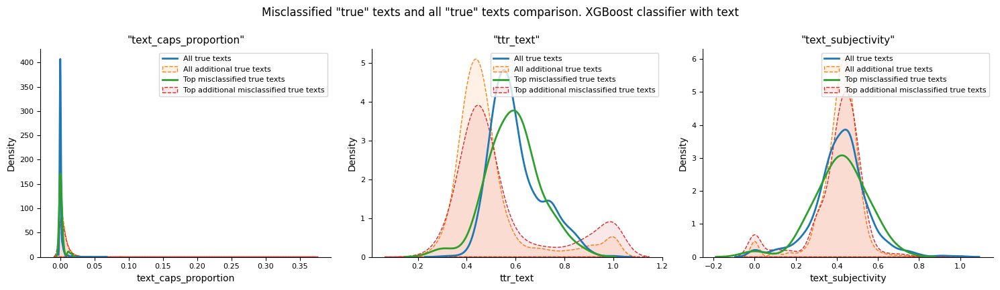

In [201]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'text_caps_proportion',
    'ttr_text',
    'text_subjectivity',
]

top_true_misclassified = xgboost_misclassified_true.loc[
    xgboost_misclassified_true['abs_difference'] > 0.5
]
top_true_add_misclassified = xgboost_misclassified_add_true.loc[
    xgboost_misclassified_add_true['abs_difference'] > 0.5
]

dfs_to_plot = [
    xgboost_misclassified_true,
    xgboost_misclassified_add_true,
    top_true_misclassified,
    top_true_add_misclassified
]
names = [
    'All true texts',
    'All additional true texts',
    'Top misclassified true texts',
    'Top additional misclassified true texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p],
            alpha=alpha[p]
            
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')

plt.tight_layout()
plt.suptitle('Misclassified "true" texts and all "true" texts comparison. '
             'XGBoost classifier with text', y=1.07);

*Comments:*
* Original dataset 'true' texts that are misclassified show slightly higher type-token ratio.
* Additional dataset 'true' texts show lower average type-token ratio with different distribution and more dense text subjectivity values.

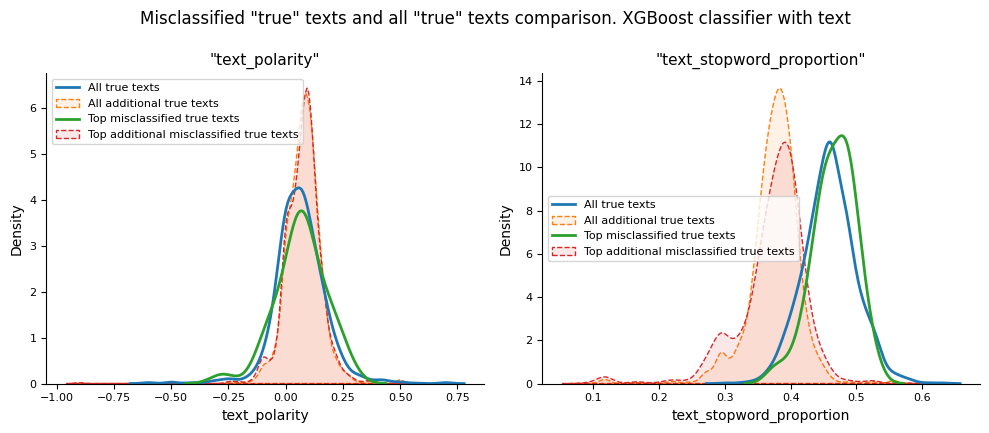

In [202]:
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes = axes.ravel()

cols_to_plot = [
    'text_polarity',
    'text_stopword_proportion'
]

top_true_misclassified = xgboost_misclassified_true.loc[
    xgboost_misclassified_true['abs_difference'] > 0.5
]
top_true_add_misclassified = xgboost_misclassified_add_true.loc[
    xgboost_misclassified_add_true['abs_difference'] > 0.5
]

dfs_to_plot = [
    xgboost_misclassified_true,
    xgboost_misclassified_add_true,
    top_true_misclassified,
    top_true_add_misclassified
]
names = [
    'All true texts',
    'All additional true texts',
    'Top misclassified true texts',
    'Top additional misclassified true texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p],
            alpha=alpha[p]
            
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')

plt.tight_layout()
plt.suptitle('Misclassified "true" texts and all "true" texts comparison. '
             'XGBoost classifier with text', y=1.07);

*Comments:*
* Text polarity is similar in all 'true' text groups. However, distribution of polarity is denser in the additional dataset.
* Text stopwords proportion is higher in misclassified 'true' texts from the original dataset, but significantly lower in addtional 'true' texts.

C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\345880860.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_true_misclassified['hue'] = 'Top misclassified true texts'
C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\345880860.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_true_add_misclassified['hue'] = 'Top additional misclassified true texts'


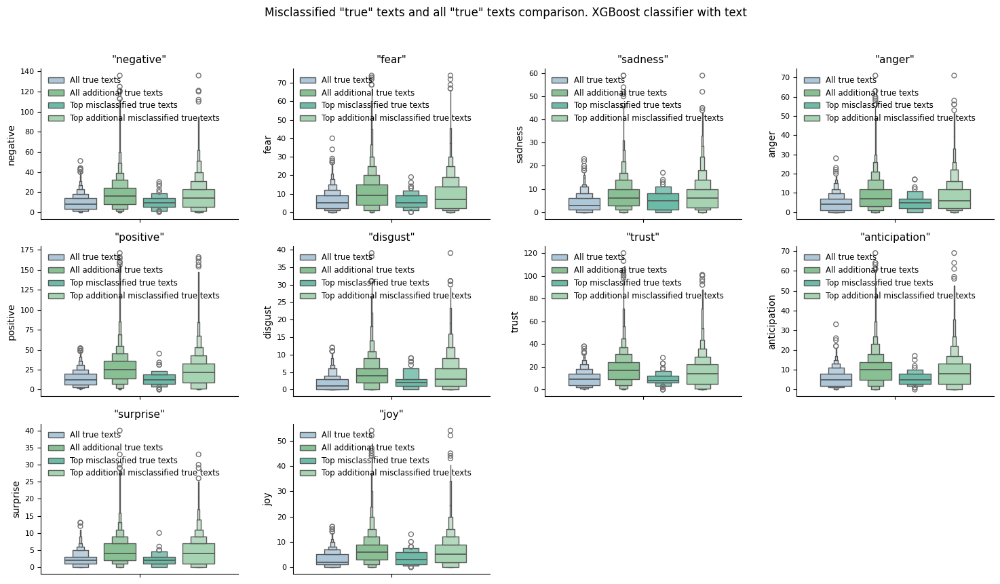

In [204]:
fig, axes = plt.subplots(3, 4, figsize=(15, 8))
axes = axes.ravel()

cols_to_plot = [
    'negative', 'fear', 'sadness',
    'anger', 'positive', 'disgust',
    'trust', 'anticipation', 'surprise',
    'joy', 
]

top_fake_misclassified = xgboost_misclassified_true.loc[
    xgboost_misclassified_true['abs_difference'] > 0.5
]
top_true_add_misclassified = xgboost_misclassified_add_true.loc[
    xgboost_misclassified_add_true['abs_difference'] > 0.5
]

xgboost_misclassified_true['hue'] = 'All true texts'
xgboost_misclassified_add_true['hue'] = 'All additional true texts'
top_true_misclassified['hue'] = 'Top misclassified true texts'
top_true_add_misclassified['hue'] = 'Top additional misclassified true texts'

dfs_to_plot = pd.concat([
    xgboost_misclassified_true,
    xgboost_misclassified_add_true,
    top_true_misclassified,
    top_true_add_misclassified
])

linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    sns.boxenplot(
        dfs_to_plot,
        y=col,
        ax=axes[i],
        hue='hue',
        gap=0.2        
    )
    axes[i].set_title(f'"{col}"')
    axes[i].legend(loc='upper left', fontsize='small', frameon=False)

for a in [axes[-1], axes[-2]]:
    fig.delaxes(a)

plt.tight_layout()
plt.suptitle('Misclassified "true" texts and all "true" texts comparison. '
             'XGBoost classifier with text', y=1.07);

*Comments:*
* Misclassified and all 'true' texts from the original dataset show similar distribution of emotion values.
* Additional dataset 'true' texts show wider and higher on average emotion values compared to the original dataset.

#### <a id='toc1_7_6_3_'></a>[Distilbert classifier. Trained on text preprocessed by the first pipeline](#toc0_)

Model achieved 0.99 accuracy and 0.99 ROC AUC on test data from the original dataset. With additional dataset model achieved 0.68 accuracy and 0.68 ROC AUC.

Pipeline does the following preprocessing steps with texts:
* Removes named entities like 'Trump' and others.
* Removes proper nouns.
* Removes special characters like HTML tags, digits, links, email addresses.
* Removes all punctuation.
* Cleans whitespaces.

In [235]:
def get_dl_model_results_and_metrics(
    model_checkpoint_path: str,
    preprocessed_test_file: str, 
    preprocessed_additional_test_file: str,
    model_name: str,
    cased: bool=False
) -> dict:
    """
    Function to get model results and metrics for the model checkpoint

    Args:
    - model_checkpoint_path: Path to model's checkpoint.
    - preprocessed_test_file: Preprocessed test file.
    - preprocessed_additional_test_file: Preprocessed additional test file.
    - model_name: Model's name.
    - cased: Whether the model is cased or not. Default is False.

    Returns:
    - Dictionary with model's metrics and results.
    """
    if cased:
        bert_tokenizer = DistilBertTokenizer.from_pretrained(
        "distilbert-base-cased",
        do_lower_case=False,
        )

        bert_base_model = DistilBertForSequenceClassification.from_pretrained(
            "distilbert-base-cased",
        )
    else:
        bert_tokenizer = DistilBertTokenizer.from_pretrained(
            "distilbert-base-uncased",
        )

        bert_base_model = DistilBertForSequenceClassification.from_pretrained(
            "distilbert-base-uncased",
        )
    
    model_from_checkpoint = load_model(
        path=model_checkpoint_path,
        model=bert_base_model
    )

    test = pd.read_csv(os.path.join(
        data_dir, preprocessed_test_file))
    
    test.dropna(subset='text', inplace=True)

    test_dataloader = get_test_dataloader(
        test_df=test,
        tokenizer=bert_tokenizer
    )

    test_outputs_path = os.path.join(project_dir, 'test_outputs')

    model_results = cf.eval_model(
        model=model_from_checkpoint,
        test_loader=test_dataloader,
        output_path=test_outputs_path,
        model_name=model_name,
        device=DEVICE
    )

    model_abs_metrics = cf.get_model_metrics(model_results)

    additional_set = pd.read_csv(
        os.path.join(data_dir, preprocessed_additional_test_file)
    )
        
    additional_set = additional_set.replace({'REAL': 'True', 'FAKE': 'Fake'})
    additional_set.rename(columns={'label': 'status'}, inplace=True)
    additional_set.dropna(subset='text', inplace=True)

    additional_test_dataloader = get_test_dataloader(
        test_df=additional_set,
        tokenizer=bert_tokenizer
    )

    model_results_additional = cf.eval_model(
        model=model_from_checkpoint,
        test_loader=additional_test_dataloader,
        output_path=test_outputs_path,
        model_name=f'{model_name}_additional_test',
        device=DEVICE
    )
    
    model_abs_metrics_additional = (
        cf.get_model_metrics(model_results_additional)
    )

    return dict(
        model_abs_metrics=model_abs_metrics,
        model_abs_metrics_additional=model_abs_metrics_additional,
        model_results=model_results,
        model_results_additional=model_results_additional,
        test_data = test,
        additional_data = additional_set,
    )

* Collect metrics and prediction results from the first pipeline model

In [236]:
dl_model_one_metrics_results = get_dl_model_results_and_metrics(
    first_model_checkpoint_path,
    'test_processed_pipeline_one.csv',
    'additional_set_processed_pipeline_one.csv',
    model_name='first_pipeline_test_model_512',
    cased=False,
)

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Evaluating: 100%|██████████| 787/787 [05:47<00:00,  2.27it/s, loss=0.466]  


In [379]:
def get_abs_difference(
    class_predictions: List[List[float]], 
    actual_labels: List[int]) -> List[float]:
    """
    Function to get absolute difference between predicted and actual labels.
    """
    correct_probabilities = [class_predictions[idx][class_idx] for \
                             idx, class_idx in enumerate(actual_labels)]
    difference = [float(abs(prob - 1)) for prob in correct_probabilities]
    return difference

* Calculate difference from the predicted and actual label

In [254]:
dl_model_one_text_features = cf.calculate_text_features(
    dl_model_one_metrics_results['test_data']
)

Calculating text caps proportion
Calculating type-token ratio
Calculating text sentiment
Calculating text emotions


In [323]:
dl_model_one_text_features_add = cf.calculate_text_features(
    dl_model_one_metrics_results['additional_data']
)

Calculating text caps proportion
Calculating type-token ratio
Calculating text sentiment
Calculating text emotions


In [380]:
dl_model_one_text_features['status'] = dl_model_one_metrics_results['test_data']['status']
dl_model_one_text_features['status'] = dl_model_one_text_features['status'].replace({'True': 1, 'Fake': 0})
dl_model_one_text_features['predicted'] = dl_model_one_metrics_results['model_abs_metrics']['predictions']

In [381]:
dl_model_one_text_features_add['status'] = dl_model_one_metrics_results['additional_data']['status']
dl_model_one_text_features_add['status'] = dl_model_one_text_features_add['status'].replace({'True': 1, 'Fake': 0})
dl_model_one_text_features_add['predicted'] = dl_model_one_metrics_results['model_abs_metrics_additional']['predictions']

In [384]:
difference = get_abs_difference(
    dl_model_one_metrics_results['model_abs_metrics']['prob'],
    dl_model_one_text_features['status']
)
dl_model_one_text_features['abs_difference'] = difference

In [386]:
difference_add = get_abs_difference(
    dl_model_one_metrics_results['model_abs_metrics_additional']['prob'],
    dl_model_one_text_features_add['status']
)
dl_model_one_text_features_add['abs_difference'] = difference_add

* Separate 'true' and 'fake' texts 

In [387]:
dl_model_one_all_fake = dl_model_one_text_features.loc[
    dl_model_one_text_features['status'] == 0
]
dl_model_one_all_true = dl_model_one_text_features.loc[
    dl_model_one_text_features['status'] == 1
]

dl_model_one_fake_misclassified = dl_model_one_all_fake.loc[
    dl_model_one_all_fake['predicted'] != dl_model_one_all_fake['status']
]
dl_model_one_true_misclassified = dl_model_one_all_true.loc[
    dl_model_one_all_true['predicted'] != dl_model_one_all_true['status']
]

dl_model_one_all_fake_add = dl_model_one_text_features_add.loc[
    dl_model_one_text_features_add['status'] == 0
]
dl_model_one_all_true_add = dl_model_one_text_features_add.loc[
    dl_model_one_text_features_add['status'] == 1
]

dl_model_one_fake_misclassified_add = dl_model_one_all_fake_add.loc[
    dl_model_one_all_fake_add['predicted'] != dl_model_one_all_fake_add['status']
]
dl_model_one_true_misclassified_add = dl_model_one_all_true_add.loc[
    dl_model_one_all_true_add['predicted'] != dl_model_one_all_true_add['status']
]

**Misclassified 'fake' texts**

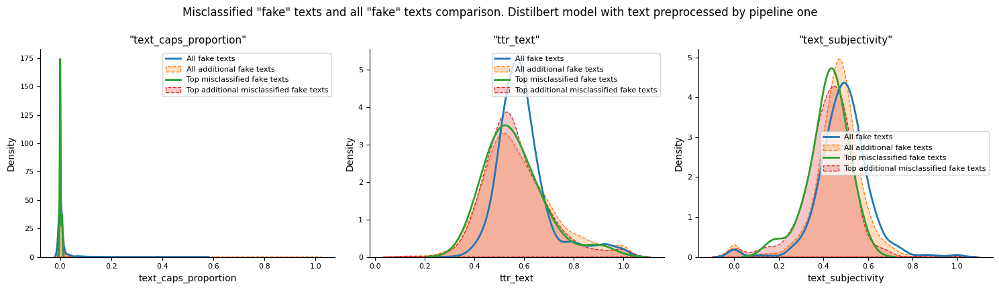

In [392]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'text_caps_proportion',
    'ttr_text',
    'text_subjectivity',
]

dfs_to_plot = [
    dl_model_one_all_fake,
    dl_model_one_all_fake_add,
    dl_model_one_fake_misclassified,
    dl_model_one_fake_misclassified_add
]
names = [
    'All fake texts',
    'All additional fake texts',
    'Top misclassified fake texts',
    'Top additional misclassified fake texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p]
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')


plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'Distilbert model with text preprocessed by pipeline one', y=1.07);

*Comments:*
* Text caps proportion is similar in all groups.
* Type-token ratio in texts is lower between misclassified texts from the original dataset and all additional 'fake' texts.
* Text subjectivity is lower between misclassified 'fake' texts from the original dataset.
* Text subjectivity is slightly lower between additional 'fake' texts compared to all 'fake' texts in the original dataset.

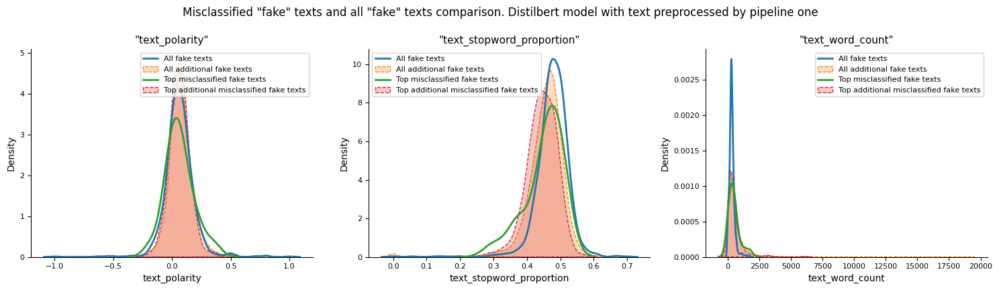

In [393]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'text_polarity',
    'text_stopword_proportion',
    'text_word_count',
]

dfs_to_plot = [
    dl_model_one_all_fake,
    dl_model_one_all_fake_add,
    dl_model_one_fake_misclassified,
    dl_model_one_fake_misclassified_add
]
names = [
    'All fake texts',
    'All additional fake texts',
    'Top misclassified fake texts',
    'Top additional misclassified fake texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p]
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')


plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'Distilbert model with text preprocessed by pipeline one', y=1.07);

*Comments:*
* Text polarity is similar in all groups. Text word cound also shows similar distributions.
* Text stopword proportion is similar between original 'fake' text groups.
* Text stopword proportion is slightly lower between additional 'fake' texts.

C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\3538999936.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dl_model_one_all_fake['hue'] = 'All fake texts'
C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\3538999936.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dl_model_one_all_fake_add['hue'] = 'All additional fake texts'
C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\3538999936.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .lo

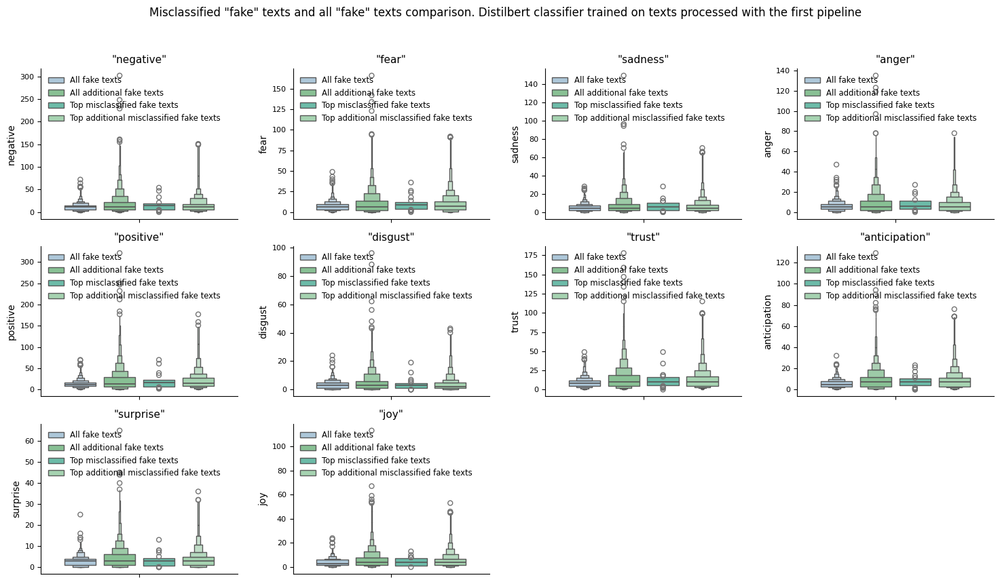

In [395]:
fig, axes = plt.subplots(3, 4, figsize=(15, 8))
axes = axes.ravel()

cols_to_plot = [
    'negative', 'fear', 'sadness',
    'anger', 'positive', 'disgust',
    'trust', 'anticipation', 'surprise',
    'joy', 
]
dl_model_one_all_fake['hue'] = 'All fake texts'
dl_model_one_all_fake_add['hue'] = 'All additional fake texts'
dl_model_one_fake_misclassified['hue'] = 'Top misclassified fake texts'
dl_model_one_fake_misclassified_add['hue'] = 'Top additional misclassified fake texts'

dfs_to_plot = pd.concat([
    dl_model_one_all_fake,
    dl_model_one_all_fake_add,
    dl_model_one_fake_misclassified,
    dl_model_one_fake_misclassified_add
])

linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    sns.boxenplot(
        dfs_to_plot,
        y=col,
        ax=axes[i],
        hue='hue',
        gap=0.2        
    )
    axes[i].set_title(f'"{col}"')
    axes[i].legend(loc='upper left', fontsize='small', frameon=False)

for a in [axes[-1], axes[-2]]:
    fig.delaxes(a)

plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'Distilbert classifier trained on texts processed with the first pipeline', y=1.07);

*Comments:*
* Texts from the original dataset show similar emotion distributions.
* Texts from the additional dataset show wider emotion distributions with slightly higher median values.

**Misclassified true texts**

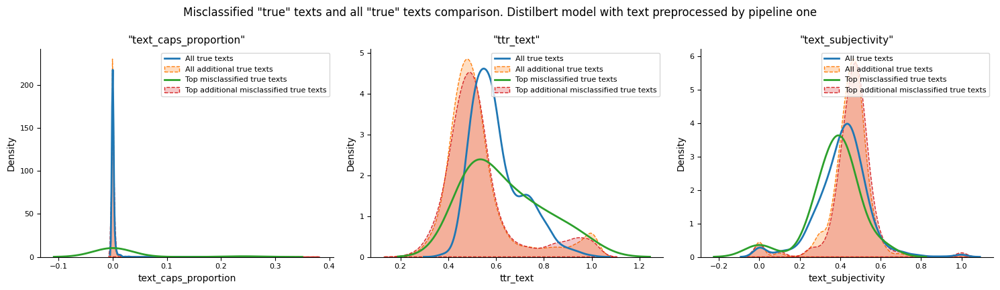

In [396]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'text_caps_proportion',
    'ttr_text',
    'text_subjectivity',
]

dfs_to_plot = [
    dl_model_one_all_true,
    dl_model_one_all_true_add,
    dl_model_one_true_misclassified,
    dl_model_one_true_misclassified_add
]
names = [
    'All true texts',
    'All additional true texts',
    'Top misclassified true texts',
    'Top additional misclassified true texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p]
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')


plt.tight_layout()
plt.suptitle('Misclassified "true" texts and all "true" texts comparison. '
             'Distilbert model with text preprocessed by pipeline one', y=1.07);

*Comments:*
* Text caps proportion is wider between misclassified 'true' texts from the original dataset.
* Type-token ratio is wider with higher number of lower and higher values between misclassified 'true' texts from the original dataset.
* Text subjectivity is slightly lower between misclassified 'true' texts from the original dataset.

* Additional 'true' texts show lower average type-token ratio and higher text subjectivity than the original 'true' texts.

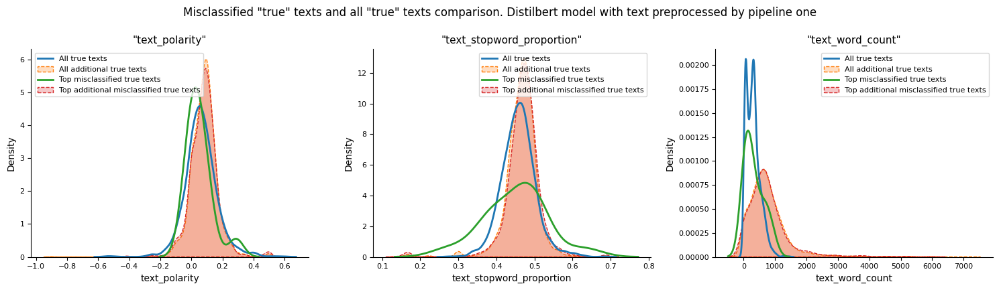

In [397]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'text_polarity',
    'text_stopword_proportion',
    'text_word_count',
]

dfs_to_plot = [
    dl_model_one_all_true,
    dl_model_one_all_true_add,
    dl_model_one_true_misclassified,
    dl_model_one_true_misclassified_add
]
names = [
    'All true texts',
    'All additional true texts',
    'Top misclassified true texts',
    'Top additional misclassified true texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p]
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')


plt.tight_layout()
plt.suptitle('Misclassified "true" texts and all "true" texts comparison. '
             'Distilbert model with text preprocessed by pipeline one', y=1.07);

* Text polarity is slightly lower between misclassified original true texts.
* Text stopword proportion shows wider distribution of values between misclassified 'true' texts from the original dataset.
* Additional 'true' texts show slightly higher text polarity and narrower range of text stopword proportion. Text word count shows different distribution from the original dataset - it is wider and shifted towards higher numbers.

C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\3302132477.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dl_model_one_all_true['hue'] = 'All true texts'
C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\3302132477.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dl_model_one_all_true_add['hue'] = 'All additional true texts'
C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\3302132477.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .lo

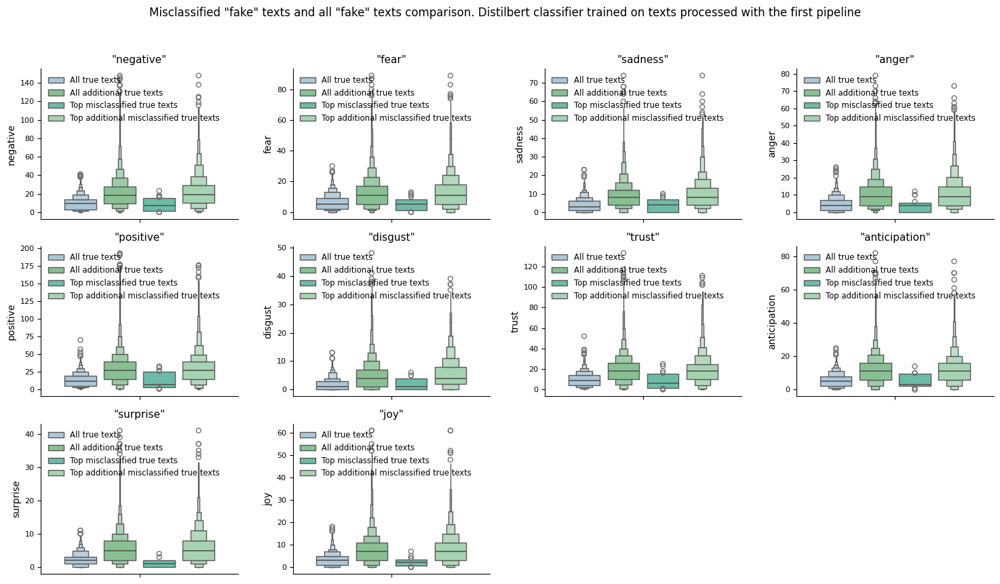

In [399]:
fig, axes = plt.subplots(3, 4, figsize=(15, 8))
axes = axes.ravel()

cols_to_plot = [
    'negative', 'fear', 'sadness',
    'anger', 'positive', 'disgust',
    'trust', 'anticipation', 'surprise',
    'joy', 
]
dl_model_one_all_true['hue'] = 'All true texts'
dl_model_one_all_true_add['hue'] = 'All additional true texts'
dl_model_one_true_misclassified['hue'] = 'Top misclassified true texts'
dl_model_one_true_misclassified_add['hue'] = 'Top additional misclassified true texts'

dfs_to_plot = pd.concat([
    dl_model_one_all_true,
    dl_model_one_all_true_add,
    dl_model_one_true_misclassified,
    dl_model_one_true_misclassified_add
])

linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    sns.boxenplot(
        dfs_to_plot,
        y=col,
        ax=axes[i],
        hue='hue',
        gap=0.2        
    )
    axes[i].set_title(f'"{col}"')
    axes[i].legend(loc='upper left', fontsize='small', frameon=False)

for a in [axes[-1], axes[-2]]:
    fig.delaxes(a)

plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'Distilbert classifier trained on texts processed with the first pipeline', y=1.07);

*Comments:*
* Misclassified 'true' texts from the original dataset show slightly lower values of emotions between texts.
* Additional 'true' texts show wider distribution and higher median value of emotions. 

#### <a id='toc1_7_6_4_'></a>[Distilbert model trained on texts preprocessed by the second pipeline.](#toc0_)

This model achieved 0.95 ROC AUC and accuracy on test data from original dataset and 0.68 ROC AUC and accuracy on additional dataset.

Pipeline consisted of:
* Lowercasing every word in the sentence.
* Changing 't' to 'not'.
* Removing '@name'
* Isolating and removing punctuations except '?'.
* Removing other special characters.
* Removing stop words except "not" and "can".
* Removing trailing whitespaces.

In [405]:
dl_model_two_metrics_results = get_dl_model_results_and_metrics(
    second_model_checkpoint_path,
    'test_processed_pipeline_two.csv',
    'additional_set_processed_pipeline_two.csv',
    model_name='second_pipeline_test_model_512',
    cased=False,
)

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Evaluating: 100%|██████████| 788/788 [05:13<00:00,  2.51it/s, loss=2.69]   


In [406]:
dl_model_two_text_features = cf.calculate_text_features(
    dl_model_two_metrics_results['test_data']
)

Calculating text caps proportion
Calculating type-token ratio
Calculating text sentiment
Calculating text emotions


In [407]:
dl_model_two_text_features_add = cf.calculate_text_features(
    dl_model_two_metrics_results['additional_data']
)

Calculating text caps proportion
Calculating type-token ratio
Calculating text sentiment
Calculating text emotions


In [408]:
dl_model_two_text_features['status'] = dl_model_two_metrics_results['test_data']['status']
dl_model_two_text_features['status'] = dl_model_two_text_features['status'].replace({'True': 1, 'Fake': 0})
dl_model_two_text_features['predicted'] = dl_model_two_metrics_results['model_abs_metrics']['predictions']

In [409]:
dl_model_two_text_features_add['status'] = dl_model_two_metrics_results['additional_data']['status']
dl_model_two_text_features_add['status'] = dl_model_two_text_features_add['status'].replace({'True': 1, 'Fake': 0})
dl_model_two_text_features_add['predicted'] = dl_model_two_metrics_results['model_abs_metrics_additional']['predictions']

In [410]:
difference = get_abs_difference(
    dl_model_two_metrics_results['model_abs_metrics']['prob'],
    dl_model_two_text_features['status']
)
dl_model_two_text_features['abs_difference'] = difference

In [411]:
difference_add = get_abs_difference(
    dl_model_two_metrics_results['model_abs_metrics_additional']['prob'],
    dl_model_two_text_features_add['status']
)
dl_model_two_text_features_add['abs_difference'] = difference_add

In [412]:
dl_model_two_all_fake = dl_model_two_text_features.loc[
    dl_model_two_text_features['status'] == 0
]
dl_model_two_all_true = dl_model_two_text_features.loc[
    dl_model_two_text_features['status'] == 1
]

dl_model_two_fake_misclassified = dl_model_two_all_fake.loc[
    dl_model_two_all_fake['predicted'] != dl_model_two_all_fake['status']
]
dl_model_two_true_misclassified = dl_model_two_all_true.loc[
    dl_model_two_all_true['predicted'] != dl_model_two_all_true['status']
]

dl_model_two_all_fake_add = dl_model_two_text_features_add.loc[
    dl_model_two_text_features_add['status'] == 0
]
dl_model_two_all_true_add = dl_model_two_text_features_add.loc[
    dl_model_two_text_features_add['status'] == 1
]

dl_model_two_fake_misclassified_add = dl_model_two_all_fake_add.loc[
    dl_model_two_all_fake_add['predicted'] != dl_model_two_all_fake_add['status']
]
dl_model_two_true_misclassified_add = dl_model_two_all_true_add.loc[
    dl_model_two_all_true_add['predicted'] != dl_model_two_all_true_add['status']
]

**Misclassification of fake texts**

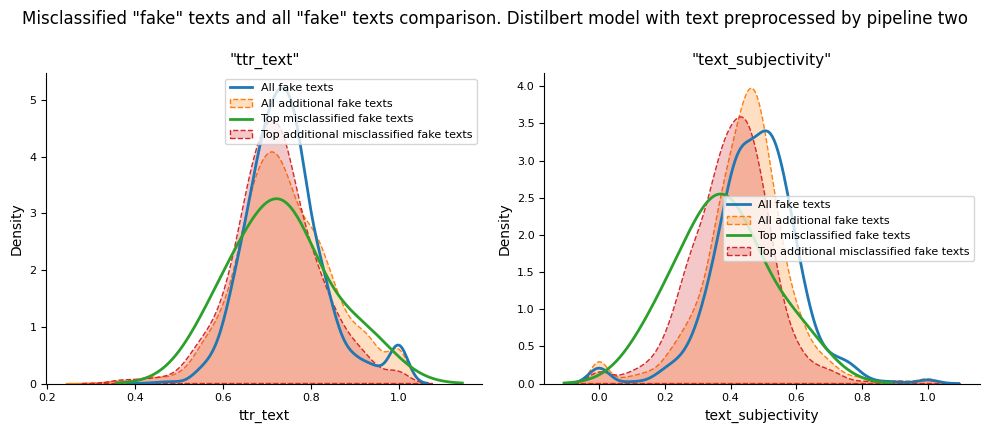

In [428]:
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes = axes.ravel()

cols_to_plot = [
    'ttr_text',
    'text_subjectivity',
]

dfs_to_plot = [
    dl_model_two_all_fake,
    dl_model_two_all_fake_add,
    dl_model_two_fake_misclassified,
    dl_model_two_fake_misclassified_add
]
names = [
    'All fake texts',
    'All additional fake texts',
    'Top misclassified fake texts',
    'Top additional misclassified fake texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p]
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')


plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'Distilbert model with text preprocessed by pipeline two', y=1.07);

*Comments:*
* Type-token ratio shows similar average value in misclassified 'fake' texts from the original dataset. However, the distribution is wider.
* 'Fake' texts from the additional dataset show very similar type-token ratio distribution to the original 'fake' texts.
* Subjectivity is lower between misclassified 'fake' texts from the original dataset, the distribution is wider. In the additional dataset, 'fake' texts show similar distribution but slightly lower average subjectivity.

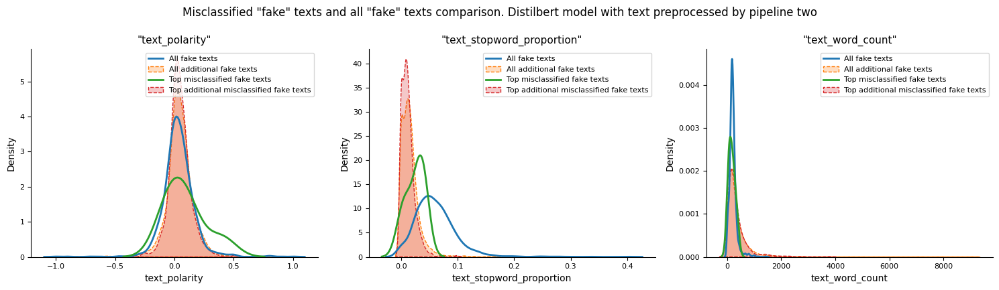

In [414]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'text_polarity',
    'text_stopword_proportion',
    'text_word_count',
]

dfs_to_plot = [
    dl_model_two_all_fake,
    dl_model_two_all_fake_add,
    dl_model_two_fake_misclassified,
    dl_model_two_fake_misclassified_add
]
names = [
    'All fake texts',
    'All additional fake texts',
    'Top misclassified fake texts',
    'Top additional misclassified fake texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p]
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')


plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'Distilbert model with text preprocessed by pipeline two', y=1.07);

*Comments:*
* Misclassified 'fake' texts show wider distribution of polarity values but similar average. Additional 'fake' texts show similar distribution to the original 'fake' texts.
* Misclasified 'fake' and additional 'fake' texts have lower text-stopword proportion.
* Text word count distributions show similarities in all groups.

C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\2913036771.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dl_model_two_all_fake['hue'] = 'All fake texts'
C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\2913036771.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dl_model_two_all_fake_add['hue'] = 'All additional fake texts'
C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\2913036771.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .lo

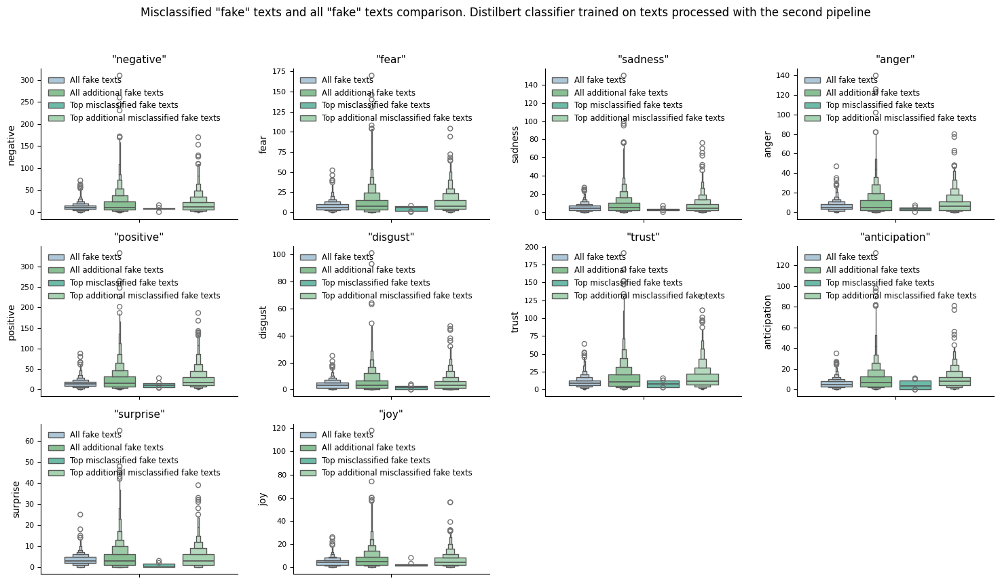

In [415]:
fig, axes = plt.subplots(3, 4, figsize=(15, 8))
axes = axes.ravel()

cols_to_plot = [
    'negative', 'fear', 'sadness',
    'anger', 'positive', 'disgust',
    'trust', 'anticipation', 'surprise',
    'joy', 
]
dl_model_two_all_fake['hue'] = 'All fake texts'
dl_model_two_all_fake_add['hue'] = 'All additional fake texts'
dl_model_two_fake_misclassified['hue'] = 'Top misclassified fake texts'
dl_model_two_fake_misclassified_add['hue'] = 'Top additional misclassified fake texts'

dfs_to_plot = pd.concat([
    dl_model_two_all_fake,
    dl_model_two_all_fake_add,
    dl_model_two_fake_misclassified,
    dl_model_two_fake_misclassified_add
])

linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    sns.boxenplot(
        dfs_to_plot,
        y=col,
        ax=axes[i],
        hue='hue',
        gap=0.2        
    )
    axes[i].set_title(f'"{col}"')
    axes[i].legend(loc='upper left', fontsize='small', frameon=False)

for a in [axes[-1], axes[-2]]:
    fig.delaxes(a)

plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'Distilbert classifier trained on texts processed with the second pipeline', y=1.07);

*Comments:*
* Misclassified 'fake' texts from the original dataset show slighly lower median emotion values.
* Additional 'fake' texts show wider distribution of emotion values and higher median value.

**Misclassification of true texts**

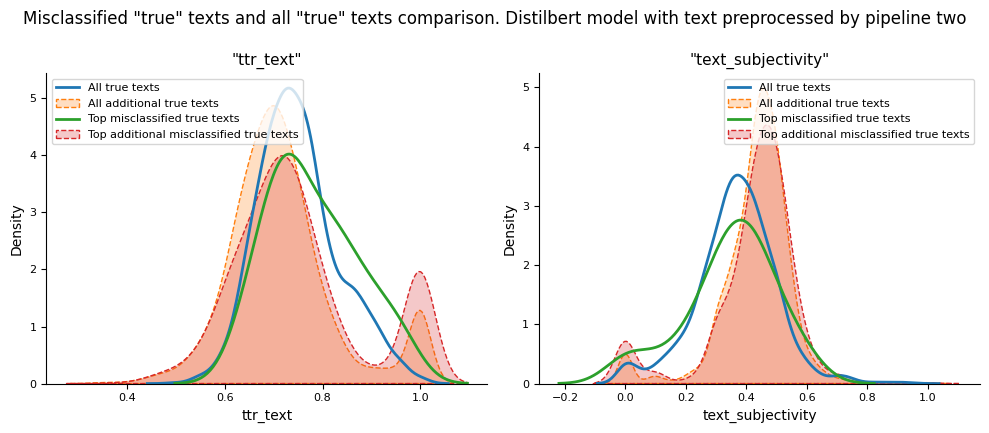

In [429]:
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes = axes.ravel()

cols_to_plot = [
    'ttr_text',
    'text_subjectivity',
]

dfs_to_plot = [
    dl_model_two_all_true,
    dl_model_two_all_true_add,
    dl_model_two_true_misclassified,
    dl_model_two_true_misclassified_add
]
names = [
    'All true texts',
    'All additional true texts',
    'Top misclassified true texts',
    'Top additional misclassified true texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p]
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')


plt.tight_layout()
plt.suptitle('Misclassified "true" texts and all "true" texts comparison. '
             'Distilbert model with text preprocessed by pipeline two', y=1.07);

*Comments:*
* There are more high-valued type-token-ratio values between misclassified 'true' texts from the original dataset.
* Distribution of type-token-ratio in the additional 'true' texts is different to the original dataset, dominating values are lower.
* Subjectivity is higher between additional 'true' texts compared to the original dataset.

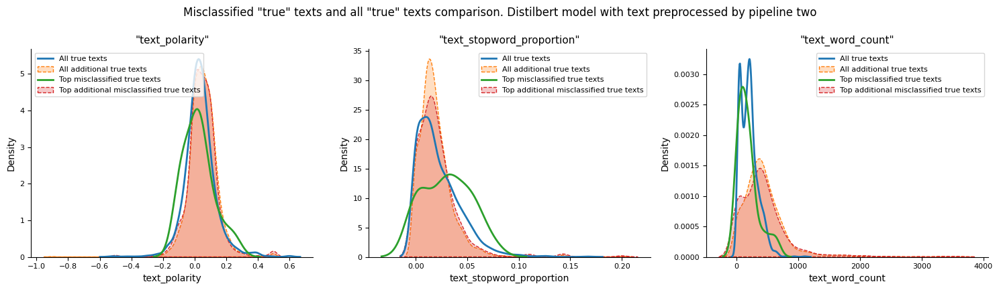

In [417]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))
axes = axes.ravel()

cols_to_plot = [
    'text_polarity',
    'text_stopword_proportion',
    'text_word_count',
]

dfs_to_plot = [
    dl_model_two_all_true,
    dl_model_two_all_true_add,
    dl_model_two_true_misclassified,
    dl_model_two_true_misclassified_add
]
names = [
    'All true texts',
    'All additional true texts',
    'Top misclassified true texts',
    'Top additional misclassified true texts'
]
linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]

for i, col in enumerate(cols_to_plot):
    for p, df in enumerate(dfs_to_plot):
        sns.kdeplot(
            df,
            x=col,
            ax=axes[i],
            label=names[p],
            linestyle=linestyles[p],
            color=colors[p],
            fill=fill[p]
        )
    axes[i].legend()
    axes[i].set_title(f'"{col}"')


plt.tight_layout()
plt.suptitle('Misclassified "true" texts and all "true" texts comparison. '
             'Distilbert model with text preprocessed by pipeline two', y=1.07);

*Comments:*
* Text polarity is similar ir all 'true' text groups. However, misclassified 'true' texts from the original dataset show higher number of low polarity values.
* Text stopword proportion distribution between misclassified texts in the original dataset is wider, with higher average value. Additional 'true' texts show similar distribution to the original all 'true' text dataset.
* Text word count is higher on average between additional 'true' texts.

C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\2543574334.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dl_model_two_all_true['hue'] = 'All true texts'
C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\2543574334.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dl_model_two_all_true_add['hue'] = 'All additional true texts'
C:\Users\jonas\AppData\Local\Temp\ipykernel_15776\2543574334.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .lo

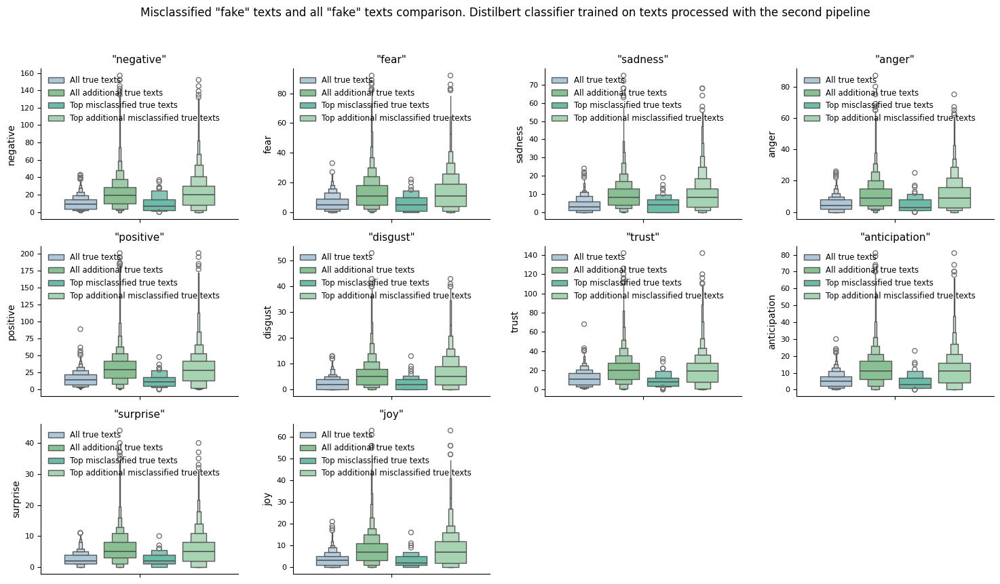

In [418]:
fig, axes = plt.subplots(3, 4, figsize=(15, 8))
axes = axes.ravel()

cols_to_plot = [
    'negative', 'fear', 'sadness',
    'anger', 'positive', 'disgust',
    'trust', 'anticipation', 'surprise',
    'joy', 
]
dl_model_two_all_true['hue'] = 'All true texts'
dl_model_two_all_true_add['hue'] = 'All additional true texts'
dl_model_two_true_misclassified['hue'] = 'Top misclassified true texts'
dl_model_two_true_misclassified_add['hue'] = 'Top additional misclassified true texts'

dfs_to_plot = pd.concat([
    dl_model_two_all_true,
    dl_model_two_all_true_add,
    dl_model_two_true_misclassified,
    dl_model_two_true_misclassified_add
])

linestyles = ['-', '--', '-', '--']
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
fill = [False, True, False, True]
alpha = [1, 0.1, 1, 0.1]

for i, col in enumerate(cols_to_plot):
    sns.boxenplot(
        dfs_to_plot,
        y=col,
        ax=axes[i],
        hue='hue',
        gap=0.2        
    )
    axes[i].set_title(f'"{col}"')
    axes[i].legend(loc='upper left', fontsize='small', frameon=False)

for a in [axes[-1], axes[-2]]:
    fig.delaxes(a)

plt.tight_layout()
plt.suptitle('Misclassified "fake" texts and all "fake" texts comparison. '
             'Distilbert classifier trained on texts processed with the second pipeline', y=1.07);

*Comments:*
* Additional 'true' texts show wider distribution of emotions and higher median value.
* Misclassified 'true' texts from the original dataset show similar distribution to all 'true' texts in the orginal dataset.

## <a id='toc1_8_'></a>[Summary](#toc0_)

**Data review and cleaning**
* Articles empty of text were dropped
* Fully duplicated articles, articles that had duplicated texts or titles and articles that had highly similar texts were dropped from the analysis.
* Outliers were identified by vectorizing texts and reducing the dimensions by UMAP or PCA. Texts furthest from the others in reduced representation were removed.

**EDA**
* Number of all-caps words was different in 'true' and 'fake' text groups.
* Words indicating locations or news services were removed from start of texts as these were indications of 'true' texts.
* Attenion words such as 'shocking', 'breaking' and others were showed to be overused in 'fake' texts.
* HTML tags, URL links, and other special characters were used more often in 'fake' articles.
* Combination of URL links, special characters, numbers and hashes were >250 times more offtenly used in 'fake' articles.
* Other special character combinations - URL links with special characters and URL links with special characters and numbers were >20 times more frequent between fake texts.
* Both 'fake' and 'true' articles had similar topics of socio-economic and political news.
* Lexical diversity calculation of type-token ratio showed similar trends in both 'true' and 'fake' article groups. However, there was a higher proportion of 'true' texts with high lexical diversity.
* Word frequencies in both true and fake texts showed alienation from the power law distribution.
* Stopword frequencies were higher between 'fake' texts.
* All texts were in English.
* Part-of-speech tagging indicated significant differences between 'fake' and 'true' texts.
* Sentiment analysis showed higher average text subjectivity between 'fake' articles but similar polarity.
* All emotions tested showed siginificant differences between article groups.
* 3 Distinct 'true' text groups were identified in the semantic analysis that differed by:
	* Subject distribution
	* Text word count
	* Title word count
	* Combinations of special characters
	* Type-token ratio
	* Subjectivity

**Data preprocessing before modeling**
* Texts were processed by 8 different pipelines:
	*pipeline short*
	* Cleaning the punctuation without removal
	* Cleaning whitespaces
	* Changing special tags with custom tokens
	
	*pipeline long*
	* Fixing misspelled words
	* Lemmatization of words
	* Cleaning punctuation without removal
	* Cleaning whitespaces
	* Changing special tags with custom tokens
	
	*pipeline one*
	* Removing named entities and proper nouns
	* Removing all special characters, HTML tags, links etc.
	* Removing all punctuation
	* Cleaning whitespaces
	
	*pipeline two*
	* Lowercasing text
	* Changing 't' to 'not'
	* Removing @name
	* Removing all punctuation except '?'
	* Removing all other special characters, links, tags etc.
	* Removing stopwords except 'not' and 'can'
	* Cleaning whitespaces
	
	*pipeline three*
	* Lowercasing text
	* Removing all special characters, HTML tags, links etc.
	* Removing all punctuation except '?', '!', '.'
	* Removing all stopwords
	* Cleaning whitespaces
	
	*pipeline four*
	* Lowercasing text
	* Removing all special characters, HTML tags, links etc.
	* Removing all punctuation except '?', '!', '.'
	* Removes repeated words in a text
	* Cleaning whitespaces
	
	*pipeline five*
	* Removing named entities and proper nouns
	* Lowercasing text
	* Changing 't' to 'not'
	* Removing all special characters, HTML tags, links etc.
	* Removing all punctuation except '?', '!', '.'
	* Removing stopwords except 'not' and 'can'
	* Cleaning whitespaces
	
	*pipeline six*
	* Removing named entities and proper nouns
	* Lowercasing text
	* Changing 't' to 'not'
	* Removing all special characters, HTML tags, links etc.
	* Removing all punctuation except '?', '!', '.'
	* Removes repeated words in a text
	* Cleaning whitespaces
	
**Heuristic model**
* For text classification the following features were used to identify texts:
	* title all-caps words proportion
	* proportion of longer all-caps words in texts
	* special character composition in title
	* proportion of special characters and numbers in titles
	* type-token ratio
	* subjectivity 
	* stopwords proportion to text length 
	* text emotions 
* Model achieved accuracy of 0.778 on test set from the original dataset.
* Model achieved accuracy of 0.561 on additional dataset from the other source.

**Machine learning models with engineered features**
* Models used the same features as used in heuristic approach
* In total 5 models were trained: logistic regression, decision tree classifier, LGBM classifier, XGBoost classifier and Catboost classifier.
* The best results were achieved by Catboost classifier: 0.940 accuracy and 0.985 ROC AUC on original dataset. On additional data the model achieved 0.622 accuracy and 0.699 ROC AUC.
* The most important features in machine learning models were showed to be caps words proportion in titles, stopword proportion in texts, special characters proportion in titles, text subjectivity and emotion disgust.

**Machine learning models with text**
* Text was preprocessed by 8 pipelines described above.
* Best performance was achieved by XGBoost classifier which achieved 0.961 accuracy and 0.993 ROC AUC on the original dataset and 0.701 accuracy and 0.762 ROC AUC on the additional dataset. Model was trained on texts preprocessed by the first pipeline.
* The most important words were showed to be 'said', 'image', 'just', 'featured' and others in model where texts were processed without removal of stopwords but with proper nouns removed.

**Deep learning models with text**
* Texts were preprocessed using 8 pipelines described above.
* Best performance was achieved by distilbert classifier trained on texts preprocessed by the first pipeline (proper nouns removal). Accuracy and ROC AUC reached 0.99 on original dataset and accuracy/ROC AUC of 0.68 on additional dataset.
* SHAP explanations showed high model's dependence on class-specific words/phrases and lower use of context in its predictions.

**Misclassifications**
* Catboost classifier trained on engineered features
	* Misclassified 'fake' texts showed lower all-caps words proportion in titles, lower type-token ratio, subjectivity and stopwords proportion in texts.
	* Additional 'fake' texts were similar both correctly and incorrectly classified. They showed lower all-caps proportion in titles, lower type-token ratio, subjectivity and stopwords proportion in texts and higher emotion values. Additional 'fake' texts showed similarities to misclassified 'fake' texts from the original dataset.
	
	* Misclassified 'true' texts showed higher all-caps words proportion in titles, higher subjectivity and stopword proportion in texts.
	* Additional 'true' texts were similar both correctly and incorrectly classified. They showed wider range in proportion of special characters in titles, lower type-token ratio, higher text subjectivity and stopword proportion. By subjectivity and text stopword proporion additional 'true' texts were closer to misclassified true texts from the original dataset.

* XGBoost classifier trained on texts, processed by the first pipeline.
	* Misclassified 'fake' texts had lower stopword proportion in texts and slightly lower subjectivity.
	* 'Fake' texts from the additional dataset, both correctly and incorrectly classified showed lower type-token ratio, text subjectivity, text stopword proportion and wider range with higher median emotion values.
	
	* Misclassified 'true' texts had slighly higher type-token ratio, and stopword proportion. 
	* Additional 'true' texts had lower type-token ratio and lower text-stopword proportion.
	
* Distilbert classifier trained on texts, processed by the first pipeline.
	* Misclassified 'fake' texts had lower type-token ratio, subjectivity and slighly lower proportion of stopwords. 
	* Additional 'fake' texts had very similar subjectivity and type-token ratio distribution as misclassified 'fake' texts from the original dataset. They also had slighly lower text stopword proportion and wider range of emotion values.
	
	* Misclassified 'true' texts from the original dataset had very broad type-token ratio and stopword proportion distributions with higher proportion of very high values. Text subjectivity and polarity were slightly lower.
	* Additional 'true' texts had lower' type-token ratio, higher text subjectivity, polarity and text word count.
	
* Distilbert classifier trained on texts, processed by the second pipeline
	* Misclassified 'fake' texts had lower text subjectivity, wider range of text polarity, and lower text-stopword proportion. All emotions had lower median value and narrower range.
	* Additional 'fake' texts had slightly lower text subjectivity, low text stopword proportion and wider range of emotion values with higher median value. Misclassified additional 'fake' texts had only slightly lower subjectivity compared to all additional 'fake' texts.
	
	* Misclassified 'true' texts had similar distribution of type-token ratio in texts with higher proportion of higher parameter values. Misclassified texts showed lower text polarity and higher on average text stopword proportion.
	* Additional 'true' texts showed different type-token ratio distribution with dominating values being lower. These texts had higher subjectivity and low text-stopword proportion. Emotion ranges were wider and higher.
	
**Model selection**
* In total there have been 6 engineered-feature-based models. From these models Catboost classifier showed the best results on test data (0.94 accuracy, 0.96 ROC AUC) and additional data (0.63 accuracy and 0.70 ROC AUC). However, models performance on additional data was not good enough to select the model as the best performing.
* In total there have been 8 text preprocessing pipelines prepared. With each pipeline 5 models were trained and evaluated on the original dataset and the additional dataset. The best performance was showed by the XGBoost classifier that reached 0.96 accuracy and 0.99 ROC AUC on original data and 0.70 accuracy and 0.76 ROC AUC on additional data. However, the most important features were showed to be specific words like `said`, `image` and others that were more associated with one of the text classes.
* In total 6 deep learning models were fitted using pre-trained distilbert text classifier. Each model used different text preprocessing pipeline. The best results were showed by the model trained on texts preprocessed by the first pipeline and second pipeline. Models reached 0.99 accuracy and ROC AUC on the original dataset and 0.68/0.67 accuracy and ROC AUC on the additional data respectively. Misclassified text analysis revealed the following features as having importance in model's predictions:

*First pipeline model:*
    * Subjectivity
    * Type-token ratio
    * Polarity
    * Stopwords proportion

*Second pipeline model*
    * Subjectivity
    * Type-token ratio
    * Polarity
    * Stopwords proportion
    * Emotions

Although both models showed association between mislassified texts and stopword proportion, model trained on texts from the first pipeline showed lower dependence even though most of the stopwords in the second pipeline are removed. Because of this reason, distilbert model trained on pipeline one is selected.

### <a id='toc1_8_1_'></a>[Suggestions for further improvement](#toc0_)
1) Dataset expansion. As all 'true' texts from the original dataset came from the same source they show similar style and context. This is the reason why all of the trained models put their attention on class-specific words rather than context. Including additional texts from different subjects and sources would greatly increase generalization.
2) None of the trained models were tuned for hyperparameters. I did not perform this tuning as models were already well-performing on the original dataset and tuning them would not help predicting data from other sources.
3) Performing more in-depth text preprocessing steps - text augmentation with text translation, use of synonimous words and other methods could be applied to get better generalizing datasets.
4) A more in depth analysis of feature importance and misclassified texts could be done. 